# __Part A: Generative Adversarial Networks__

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Problem Understanding__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### __What is GAN?__

Gan represnts Generative Adversarial Networks which is all about creating here. Generally it is harder compared to other deep learning fields.

The main focus of GAN is to generate data be it images or videos or music from scratch and generally what does GAN consist of?

GAN are algorithic architectures that uses 2 neural networks, putting one against the other. This is to generate new, synthetic instances of data that can be pass as real data.

Generally, widely use in image generation, voice generation etc. 

GAN also work with competition of two different parts


__Generator__
1. For this, you can input random images, known as random noise. This random images can be anything.
2. Through the generator, it will generate a sample that hopefully ends up like the real dataset if the generator and discrimintor and discriminator both are trained good enough
3. Output is sometimes refered to as latent space or a latent vector

What can we do to optimise?
1. Output must be pass through the generator through the discriminator, which then backpropagate and calculate the erros both the generator and discriminator 
2. Gan is also a form of decovolution and parameters, such as stride, padding, kernel size



__Discriminator__ 
1. For this, input the real images from actual data tha needs to be generated like CIFAR1
2. Also, you input the output of generator into the discriminator
3. Convolutional layer of discrimnator is the normal convolution we are used to.
4. This are downscaled to the input that is suitable for classification. 



__How can we optimise both as a whole?__
After data is passed through both generator and discriminator, optimisation with backpropagation begins, the goal is to kepp improving at a level pace for both models to be good at its role, equilibrium point is exactly when the discriminator is leaning 50% to both sides, meaning that both images could either be real or fake, where the generator model tries to minimize the probability that the discriminator will predict the generator's output as fake. On the other side, the discriminator tries to maximize the probability that it will correctly classify both real and fake image

### __What is GAN?__

Gan represnts Generative Adversarial Networks which is all about creating here. Generally it is harder compared to other deep learning fields.

The main focus of GAN is to generate data be it images or videos or music from scratch and generally what does GAN consist of?

GAN are algorithic architectures that uses 2 neural networks, putting one against the other. This is to generate new, synthetic instances of data that can be pass as real data.

Generally, widely use in image generation, voice generation etc. 

GAN also work with competition of two different parts

![image.png](attachment:image.png)

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Import Libraries__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [1]:
!pip install -q keras-tuner pandas matplotlib seaborn scikit-learn tqdm tensorflow_addons scikit-image imblearn

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


### Other Imports

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from sklearn.metrics import classification_report,accuracy_score, confusion_matrix
from sklearn.decomposition import PCA
from sklearn.preprocessing import Normalizer
from sklearn.metrics import classification_report, accuracy_score
import os, time, math, datetime, warnings, pytz, glob
from IPython.display import display
from functools import reduce
import absl.logging
from tqdm import tqdm
import logging
from scipy.linalg import sqrtm
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.linalg import sqrtm
from skimage.transform import resize
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from sklearn.utils import resample
from sklearn.neighbors import NearestNeighbors
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import numpy as np
from PIL import Image, ImageFilter
absl.logging.set_verbosity(absl.logging.ERROR)
logging.getLogger('tensorflow').disabled = True
warnings.filterwarnings('ignore')

### Tensorflow Import

In [3]:
import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
from tensorflow.keras.models import Model
import numpy as np
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.utils import Sequence, to_categorical
from tensorflow import expand_dims
from tensorflow.keras import Sequential
from tensorflow.keras import layers as L
from tensorflow.keras import backend as K
from tensorflow.image import random_flip_left_right, random_crop, resize_with_crop_or_pad
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import (Embedding, Dense, Input, InputLayer, Normalization, Flatten,BatchNormalization,
    Dropout,Conv2D, GlobalAveragePooling2D, MaxPooling2D, ReLU, Layer,Activation, Multiply, AveragePooling2D,
    Add, RandomRotation,Resizing, Rescaling, Reshape, Concatenate, concatenate, Lambda,LeakyReLU)
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, TerminateOnNaN, TensorBoard, CSVLogger, Callback
from tensorflow.keras.backend import clear_session
from tensorflow.keras.optimizers import RMSprop, SGD, Adam, Adagrad, Adamax
from tensorflow.keras.regularizers import l2, L2
from tensorflow.keras.optimizers.schedules import *
from tensorflow.keras.metrics import FalseNegatives, categorical_crossentropy, sparse_categorical_crossentropy,BinaryCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.image import *
from tensorflow_addons.optimizers import SWA
from tensorflow.keras.layers import Dense, Reshape, LeakyReLU, UpSampling2D, Conv2D
from tensorflow.keras.optimizers import Adam
from sklearn.metrics.pairwise import pairwise_kernels
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import PReLU,Dense, GlobalAveragePooling2D, Input, Conv2DTranspose
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, LeakyReLU, GlobalAveragePooling2D, Dense, Concatenate
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.initializers import RandomNormal
from tensorflow_addons.layers import SpectralNormalization
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input

from tensorflow.keras.datasets import cifar10
from kerastuner.tuners import Hyperband
from kerastuner import HyperModel
# Setting a seaborn style
sns.set(style="whitegrid")







### Set the seed of this notebook

In [4]:
seed = 32
tf.random.set_seed(seed)
np.random.seed(seed)

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Check for GPU__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">

Here is check the available GPUs and set the memory growth

In [5]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(f"{len(gpus)} Physical GPUs, {len(logical_gpus)} Logical GPU")
    except RuntimeError as e:
        print(e)

1 Physical GPUs, 1 Logical GPU


In [6]:
!nvidia-smi

Fri Feb  2 02:42:57 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.147.05   Driver Version: 525.147.05   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:07:00.0 Off |                  Off |
|  0%   48C    P2    35W / 450W |    553MiB / 24564MiB |      5%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Import Dataset__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [7]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data

170498071/170498071 [==============================] - 3s 0us/step


In [8]:
y_train = to_categorical(y_train)

In [9]:
x_train.shape

(50000, 32, 32, 3)

### Set the labels for the Classes

This is so that we are able to use it for EDA and model training later on

In [10]:
cifarLab = ["airplane", "automobile", "bird", "cat", "deer", "dog", "frog", "horse", "ship", "truck"]
class_labels = {idx: label for idx, label in enumerate(cifarLab)}
print(class_labels)

{0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat', 4: 'deer', 5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship', 9: 'truck'}


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Feature Engineering__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


Below is the idea of feature engineering

1. **Convert Data Type**:
    ```python
    x_train = x_train.astype('float32')
    ```
    This line converts the data type of `x_train` elements to `float32`. It's a standard practice to use floating-point numbers in computations involving neural networks due to their capability to represent decimal values, which are crucial for the granularity of learning.

2. **Scale the Data**:
    ```python
    x_train /= (255/2)
    ```
    Here, the pixel values of the images (assuming `x_train` contains image data) are scaled. Usually, image data comes in the format of integers ranging from 0 to 255 (8-bit representation). This operation scales the data to a new range. Dividing by `(255/2)` scales the data to a range of [0, 2].

3. **Shift the Data**:
    ```python
    x_train -= 1
    ```
    This operation shifts the data range from [0, 2] to [-1, 1]. Shifting data to be centered around zero (mean = 0) can significantly improve the convergence during training, as it ensures that the input features have similar scales.




In [11]:
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
latent_dim = 128

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Evaluation Metrics__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### KID (Kernel Inception Distance)
1. Metrics used for evaluting the quality of images generated by GAN. This measures the similarity between two sets of images by comparing the statistics of deep features. These uses the pre trained Inception model

   $$
   MMD^2 = \frac{1}{m^2} \sum_{i=1}^{m} \sum_{j=1}^{m} K(x_i, x_j) + \frac{1}{n^2} \sum_{i=1}^{n} \sum_{j=1}^{n} K(y_i, y_j) - \frac{2}{mn} \sum_{i=1}^{m} \sum_{j=1}^{n} K(x_i, y_j)
   $$

- Compute the kernel metrics using kernel function
- Calculate the mean Maximum Mean Discrepancy
- Final average KID values computed over entire dataset
### FID
- Metrics that compares the statistics of generated images to real images in the feature space of a deep learning model (Inception model) and calculate the distance betwen the feature vectors of the real and generated images, lower FID implies that better quality of generated images

$$
FID = ||\mu_x - \mu_y||^2 + Tr(\Sigma_x + \Sigma_y - 2(\Sigma_x \Sigma_y)^{1/2})
$$
- Includes the Euclidean distance between mean vectors of real and generated images
- Tr denotes the trace of matrix
$$
(\Sigma_x \Sigma_y)^{1/2}
$$
 Denotes the sqaure root of the product of the covariance matrices which is computed using methods eigen decomposition




In [12]:
class Evaluation:
    def __init__(self, generator, latent_dim, sizeOfBatch, sample_size, sizeOfBuffer):
        self.generator = generator
        self.latent_dim = latent_dim
        self.sizeOfBatch = sizeOfBatch
        self.sample_size = sample_size
        self.sizeOfBuffer = sizeOfBuffer

        self.inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
        self.AUTO = tf.data.experimental.AUTOTUNE

    def generate_images(self, num_images,labels=None):
        print(labels)
        if labels is not None:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            labels = tf.one_hot(labels, depth=10)  # Adjust 'self.num_classes' as per your class count# Adjust shape as needed
            generated_images = self.generator.predict([random_latent_vectors, labels])
        else:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            generated_images = self.generator.predict(random_latent_vectors)
        return generated_images

    def plot_loss_curve(self, history, title='Loss Curve'):
        plt.figure(figsize=(10, 5))
        plt.plot(history['g_loss'], label='Generator Loss')
        plt.plot(history['d_loss'], label='Discriminator Loss')
        plt.title(title)
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True)
        plt.show()

    def compute_metrics(self, train_data,cgan=False):
        real_images = tf.data.Dataset.from_tensor_slices(train_data).shuffle(self.sizeOfBuffer).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        
        if cgan:
            class_labels = np.arange(10)
            class_labels = np.repeat(class_labels, self.sample_size / 10).flatten()
            generated_images = self.generate_images(self.sample_size, class_labels)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        else:
            generated_images = self.generate_images(self.sample_size)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        # Compute embeddings
        real_embeddings = self.__compute_embeddings(real_images, math.ceil(len(train_data) / self.sizeOfBatch))
        generated_embeddings = self.__compute_embeddings(generated_images, math.ceil(self.sample_size / self.sizeOfBatch))

        # Calculate FID
        fid = self.__calculate_fid(real_embeddings, generated_embeddings)
        kid = self.__calculate_kid(real_embeddings, generated_embeddings)
        return fid, kid

        
    def __calculate_kid(self,real_embeddings, generated_embeddings):
        # Polynomial kernel computation
        kernel_real = pairwise_kernels(real_embeddings, metric='polynomial', degree=3)
        kernel_gen = pairwise_kernels(generated_embeddings, metric='polynomial', degree=3)
        kernel_real_gen = pairwise_kernels(real_embeddings, generated_embeddings, metric='polynomial', degree=3)

        m = real_embeddings.shape[0]
        n = generated_embeddings.shape[0]

        # KID calculation
        kid = (np.sum(kernel_real) / (m * (m - 1)) +
               np.sum(kernel_gen) / (n * (n - 1)) -
               2 * np.sum(kernel_real_gen) / (m * n))
        return kid
    def __scale_and_preprocess(self, image):
        image = (image + 1) / 2 * 255.0
        image = preprocess_input(image)
        return tf.image.resize(image, (299, 299))

    def __compute_embeddings(self, dataloader, count):
        embeddings = []
        for batch in (dataloader.take(count)):
            batch_embeddings = self.inception_model.predict(batch, verbose=0)
            embeddings.extend(batch_embeddings)
        return np.array(embeddings)

    def __calculate_fid(self, real_embeddings, generated_embeddings):
        mu1, sigma1 = real_embeddings.mean(axis=0), np.cov(real_embeddings, rowvar=False)
        mu2, sigma2 = generated_embeddings.mean(axis=0), np.cov(generated_embeddings, rowvar=False)
        ssdiff = np.sum((mu1 - mu2)**2.0)
        covmean = sqrtm(sigma1.dot(sigma2))
        if np.iscomplexobj(covmean):
            covmean = covmean.real
        return ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)


### Visual Approach
1. Even with metrics above, human approach is required to be able to see and tell what the images is 
2. Below function is to generate 1000 images to be able to view the diversity and how well the image is representing the data

In [13]:
def generate_1000_cgan(generator, num_iterations=10, class_labels=None, saveDisk=False):
    if not class_labels or len(class_labels) == 0:
        class_labels = [f'Class {i}' for i in range(10)]

    for class_index, class_label in enumerate(class_labels):
        conditions = np.full((100,), class_index)
        conditions = tf.keras.utils.to_categorical(conditions, num_classes=len(class_labels))
        latent_z = np.random.normal(size=(100, 128))
        imgs = generator.predict([latent_z, conditions])
        fig, axes = plt.subplots(10, 10, figsize=(20, 20))
        fig.patch.set_facecolor('#abdbe3')
        fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.02, wspace=0.02)

        for idx, ax in enumerate(axes.flatten()):
            ax.imshow((imgs[idx] + 1) / 2, interpolation='nearest')
            ax.axis('off')

        print(f'{class_label} - 100 Generated Images')
        if saveDisk:
            plt.savefig(f'cgan_generated_images_{class_label}.png', bbox_inches='tight', pad_inches=0)
        else:
            plt.show()
        plt.close(fig)

In [14]:
def train_gan(d, g, latent_dim, data, epochs=100, learning_rate=2e-4, beta_1=0.5, use_multiprocessing=True, workers=16, callbacks=None):
    gan = CGAN(discriminator=d,generator=g,latent_dim=128)
    gan.compile(
        d_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
        g_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
        loss_fn=tf.keras.losses.BinaryCrossentropy(),
    )
    gan_hist = gan.fit(
        dataset,
        epochs=100,
        use_multiprocessing=True,
        workers=16,
        callbacks=callbacks
    )
    return gan_hist, gan


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering 1 (Outlier Testing))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### Creating the dataset

In [15]:
full_scores = pd.DataFrame()

In [16]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
y_train = to_categorical(y_train)

### Defining the variables

In [17]:
sizeOfBatch = 64
AUTO = tf.data.AUTOTUNE
sizeOfBuffer = 1024
noise = 128
numberClass = 10
latent_dim = 128

### Creating the dataset

In [18]:
dataset = tf.data.Dataset.from_tensor_slices((x_train, y_train))
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

### Training Loop and Callbacks

#### Model Training

In [19]:
class CGAN(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(CGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.noise = latent_dim
        self.d_real_loss_metric = tf.keras.metrics.Mean(name="d_real_loss")
        self.d_fake_loss_metric = tf.keras.metrics.Mean(name="d_fake_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="g_loss")
        self.d_acc_metric = tf.keras.metrics.BinaryAccuracy(name="d_acc")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(CGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    def train_step(self, data):
        real_images, ohl = data
        batch_size = tf.shape(real_images)[0]

        # Generate the noise and iamges
        latent_noise_vector = tf.random.normal(shape=(batch_size, self.noise))
        generated_images = self.generator([latent_noise_vector, ohl])
        combined_images = tf.concat([generated_images, real_images], axis=0)
        combined_condition = tf.concat([ohl, ohl], axis=0)
        labels = tf.concat(
            [tf.zeros((batch_size, 1)), tf.ones((batch_size, 1))], axis=0
        )

        # Training the discriminator
        with tf.GradientTape() as tape:
            first_predictions = self.discriminator(
                [combined_images, combined_condition])
            d_loss = self.loss_fn(labels, first_predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )
        
        # Training the discriminator
        latent_noise_vector = tf.random.normal(shape=(batch_size, self.noise))

        misleading_labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as tape:
            fake_images = self.generator([latent_noise_vector, ohl])
            second_predictions = self.discriminator([fake_images, ohl])
            g_loss = self.loss_fn(misleading_labels, second_predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(
            zip(grads, self.generator.trainable_weights))

        self.d_real_loss_metric.update_state(d_loss)
        self.d_fake_loss_metric.update_state(d_loss) 
        self.g_loss_metric.update_state(g_loss)
        self.d_acc_metric.update_state(labels, first_predictions)  

        return {
            "d_real_loss": self.d_real_loss_metric.result(),
            "d_fake_loss": self.d_fake_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
            "d_acc": self.d_acc_metric.result(),
            "d_realO": tf.reduce_mean(first_predictions[:batch_size]), 
            "d_fakeO": tf.reduce_mean(first_predictions[batch_size:])   
        }


#### Callback

- Two callback of image generation and checkpoint to save models was created here

In [20]:
class CGANImageGenerationCallback(tf.keras.callbacks.Callback):
    def __init__(self, num_img=10, noise=128, num_classes=10, display_freq=10, vmin=0, vmax=1):
        self.num_img = num_img  
        self.noise_dim = noise  
        self.num_classes = num_classes
        self.display_freq = display_freq  
        self.vmin = vmin 
        self.vmax = vmax  
        self.constant_noise = tf.random.normal(shape=(self.num_img, self.noise_dim))  
        self.conditions = tf.keras.utils.to_categorical(np.arange(self.num_img) % self.num_classes, num_classes)  

    def generate_plot(self):
        generated_images = self.model.generator([self.constant_noise, self.conditions])
        generated_images = (generated_images - self.vmin) / (self.vmax - self.vmin)  

        fig = plt.figure(figsize=(12, 6))
        gs = gridspec.GridSpec(2, self.num_img // 2)  
        for i in range(self.num_img):
            ax = plt.subplot(gs[i])
            ax.imshow(generated_images[i, :, :, :])
            ax.axis('off')
        fig.patch.set_facecolor('#f0f0f0')
        plt.suptitle("Generated Images", fontsize=16)
        plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
        plt.show()

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.display_freq == 0:
            self.generate_plot()

In [21]:
class ModelCheckpointCallback(tf.keras.callbacks.Callback):
    def __init__(self, save_freq=10, model_dir=None):
        self.save_freq = save_freq
        self.model_dir = model_dir

    # Saving the weights
    def save(self, epoch=None):
        if epoch is not None:
            name = f'generator-{epoch}.h5'
            full_path = os.path.join(self.model_dir, name)
            os.makedirs(self.model_dir, exist_ok=True)
            self.model.generator.save(filepath=full_path, save_format='h5')
    
    # Saving after end 
    def on_train_end(self, logs=None):
        if not os.path.exists(self.model_dir):
            os.makedirs(self.model_dir)
        self.save('final')

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.save_freq == 0:
            self.save(epoch)




## __Key Ideas__
1. Outlier testing in GANs is crucial for ensuring the generative model produces high-quality and diverse outputs, identifying instances where the model deviates significantly from the expected data distribution.
2. By integrating outlier detection mechanisms, researchers can monitor and improve the stability of GAN training, mitigating common issues like mode collapse, where the model generates limited varieties of outputs.
4. Techniques like statistical outlier detection, distance metrics in latent space, or comparison against a validation set are commonly used to identify anomalies in the data generated by GANs.
5. Incorporating outlier testing into the GAN framework not only enhances the reliability of the model but also provides valuable insights into the model's learning dynamics and potential areas for improvement
6. This is done with the use of auto encoder
    - Auto Encoder are a type of deep-learning architectures that are used to learn how to compress and decompress data faithfully.
    - The compression layers are referred to as the encoding layers, and the decompression layers are referred to as the decoding layer

Below shows how it generally looks like 


![image.png](attachment:image.png)





In [22]:
encoder = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=x_train.shape[1:]),  # Adjusted for CIFAR-10 shape
    tf.keras.layers.Conv2D(16, (3, 3), activation='relu', padding='same', strides=2),
    tf.keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same', strides=2)
])

decoder = tf.keras.Sequential([
    tf.keras.layers.Conv2DTranspose(8, kernel_size=3, strides=2, activation='relu', padding='same'),
    tf.keras.layers.Conv2DTranspose(16, kernel_size=3, strides=2, activation='relu', padding='same'),
    tf.keras.layers.Conv2D(3, kernel_size=(3, 3), activation='sigmoid', padding='same')  # Adjusted for 3 color channels
])
autoencoder = tf.keras.Sequential([encoder, decoder])
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
history = autoencoder.fit(
    x_train, x_train, 
    epochs=10,
    batch_size=128,
    validation_split=0.1
)



Epoch 1/10
352/352 [==============================] - 4s 5ms/step - loss: -394597.1562 - val_loss: -2815473.0000
Epoch 2/10
352/352 [==============================] - 1s 4ms/step - loss: -41491332.0000 - val_loss: -133120696.0000
Epoch 3/10
352/352 [==============================] - 1s 4ms/step - loss: -475019424.0000 - val_loss: -1028488448.0000
Epoch 4/10
352/352 [==============================] - 1s 4ms/step - loss: -2302332416.0000 - val_loss: -4032794880.0000
Epoch 5/10
352/352 [==============================] - 1s 4ms/step - loss: -7193172480.0000 - val_loss: -11094428672.0000
Epoch 6/10
352/352 [==============================] - 1s 4ms/step - loss: -17414471680.0000 - val_loss: -24728965120.0000
Epoch 7/10
352/352 [==============================] - 1s 4ms/step - loss: -35684802560.0000 - val_loss: -47753711616.0000
Epoch 8/10
352/352 [==============================] - 1s 4ms/step - loss: -65068052480.0000 - val_loss: -83401687040.0000
Epoch 9/10
352/352 [========================

1563/1563 [==============================] - 2s 1ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

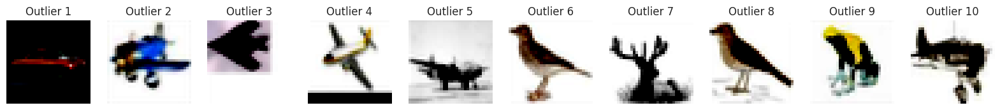

In [23]:
reconstructed = autoencoder.predict(x_train)
reconstruction_error = np.mean(np.power(x_train - reconstructed, 2), axis=(1,2,3))
threshold = np.quantile(reconstruction_error, 0.99)
outliers = x_train[reconstruction_error > threshold]

n = 10  
plt.figure(figsize=(20, 8))
for i in range(n):
    ax = plt.subplot(1, n, i + 1)
    plt.imshow(outliers[i])
    plt.axis('off')
    ax.set_title(f'Outlier {i+1}')
plt.show()
non_outliers_labels = y_train[reconstruction_error<=threshold]
non_outliers= x_train[reconstruction_error<=threshold]

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Outlier image seems to be mix with half clear and half unclear


</div>

In [24]:
def build_generator(noise):
    weights_init = RandomNormal(mean=0, stddev=0.02)

    model = Sequential(name='generator_cgan_1')
    model.add(Dense(2*2*512, input_dim=noise + 10, activation='relu', kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(PReLU())
    model.add(Reshape((2, 2, 512)))
    model.add(Conv2DTranspose(256, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(PReLU())

    model.add(Conv2DTranspose(128, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(PReLU())

    model.add(Conv2DTranspose(64, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(PReLU())
    model.add(Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh', name='Output_Layer'))
    noise_input = Input(shape=(noise,))
    conditions_input = Input(shape=(10,))
    merged_input = Concatenate()([noise_input, conditions_input])
    generator_output = model(merged_input)

    final_model = Model(inputs=[noise_input, conditions_input], outputs=generator_output, name='generator_cgan_1')
    
    return final_model

In [25]:
def build_discriminator(image_size=(32,32,3)):
    imgSizeI = Input(shape=image_size)
    weights_init = RandomNormal(mean=0, stddev=0.02)
    conditions = Input(shape=(10,))

    model = Sequential()
    model.add(Conv2D(64, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(0.2))
    model.add(Conv2D(128, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(0.2))
    model.add(Conv2D(256, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(0.2))
    model.add(Conv2D(512, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_init))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(0.2))
    model = model(imgSizeI)
    model = GlobalAveragePooling2D()(model)
    merged_layer = Concatenate()([model, conditions])
    model = Dense(512, activation='relu')(merged_layer)
    model = Dense(1, activation='sigmoid', name='Output_Layer')(model)

    model = Model(inputs=[imgSizeI, conditions],
                          outputs=model, name='discriminator_cgan_2')
    return model

#### Creating Checkpoint

In [26]:
callbacks = [CGANImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='Non-Outlier CGAN-1')]

#### Training

In [27]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

In [28]:
dataset = tf.data.Dataset.from_tensor_slices((non_outliers, non_outliers_labels))
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [29]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/100
774/774 [==============================] - ETA: 0s - d_real_loss: 0.2551 - d_fake_loss: 0.2551 - g_loss: 3.6124 - d_acc: 0.9104 - d_realO: 0.1474 - d_fakeO: 0.8633

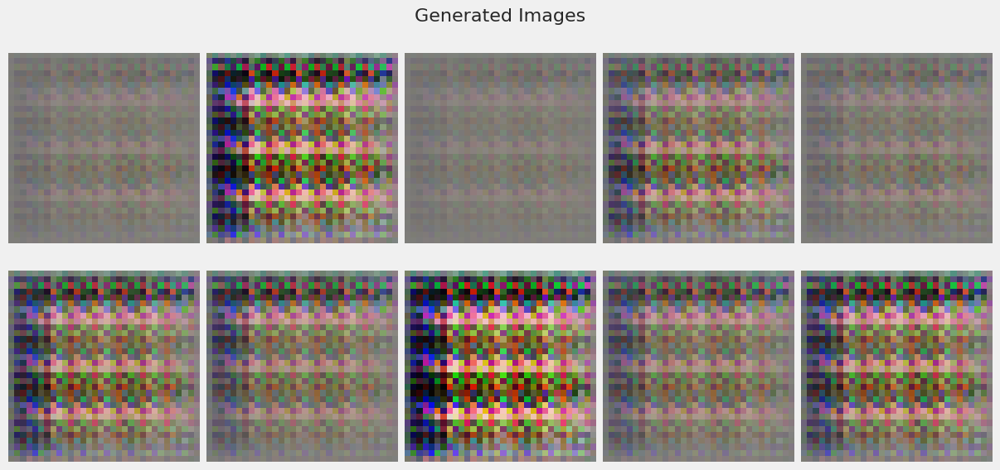

774/774 [==============================] - 11s 12ms/step - d_real_loss: 0.2551 - d_fake_loss: 0.2551 - g_loss: 3.6124 - d_acc: 0.9104 - d_realO: 0.1473 - d_fakeO: 0.8632
Epoch 2/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2281 - d_fake_loss: 0.2281 - g_loss: 3.6233 - d_acc: 0.9257 - d_realO: 0.1209 - d_fakeO: 0.8725
Epoch 3/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2426 - d_fake_loss: 0.2426 - g_loss: 3.3802 - d_acc: 0.9142 - d_realO: 0.1395 - d_fakeO: 0.8560
Epoch 4/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2929 - d_fake_loss: 0.2929 - g_loss: 2.8144 - d_acc: 0.8880 - d_realO: 0.1800 - d_fakeO: 0.8188
Epoch 5/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2792 - d_fake_loss: 0.2792 - g_loss: 2.8132 - d_acc: 0.8896 - d_realO: 0.1755 - d_fakeO: 0.8272
Epoch 6/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2906 - d_fake_loss: 0

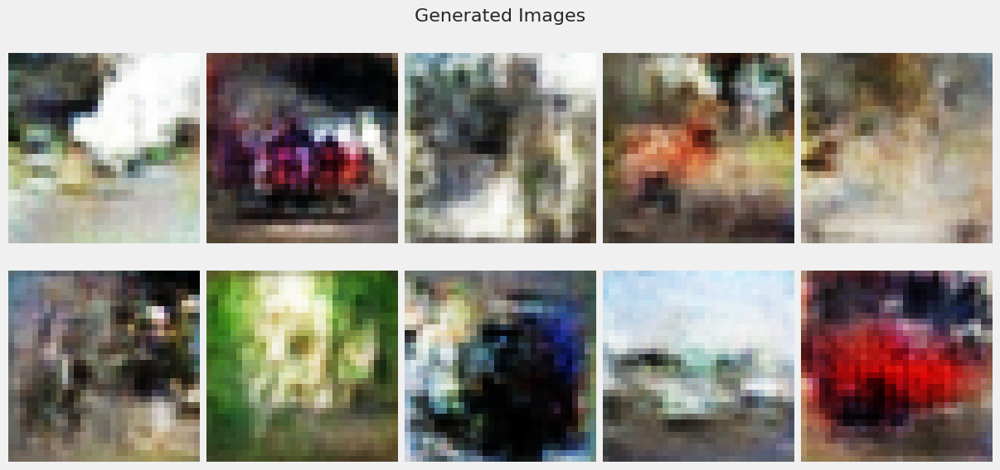

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.3034 - d_fake_loss: 0.3034 - g_loss: 2.7072 - d_acc: 0.8710 - d_realO: 0.1922 - d_fakeO: 0.8080
Epoch 12/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3132 - d_fake_loss: 0.3132 - g_loss: 2.5923 - d_acc: 0.8652 - d_realO: 0.1986 - d_fakeO: 0.8015
Epoch 13/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3166 - d_fake_loss: 0.3166 - g_loss: 2.5173 - d_acc: 0.8629 - d_realO: 0.2022 - d_fakeO: 0.7983
Epoch 14/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3169 - d_fake_loss: 0.3169 - g_loss: 2.4760 - d_acc: 0.8630 - d_realO: 0.2030 - d_fakeO: 0.7973
Epoch 15/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3134 - d_fake_loss: 0.3134 - g_loss: 2.4695 - d_acc: 0.8635 - d_realO: 0.2011 - d_fakeO: 0.7998
Epoch 16/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3337 - d_fake_los

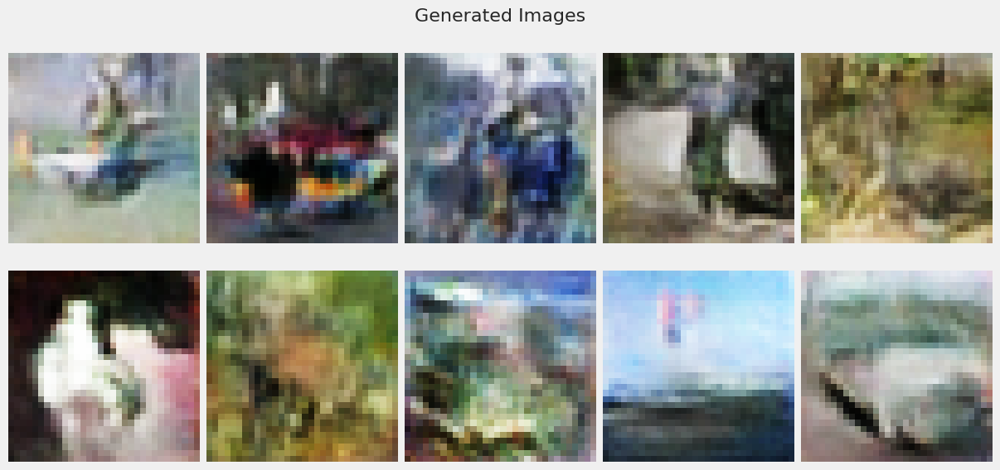

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.2880 - d_fake_loss: 0.2880 - g_loss: 2.6173 - d_acc: 0.8759 - d_realO: 0.1839 - d_fakeO: 0.8168
Epoch 22/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2965 - d_fake_loss: 0.2965 - g_loss: 2.5888 - d_acc: 0.8721 - d_realO: 0.1898 - d_fakeO: 0.8111
Epoch 23/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2977 - d_fake_loss: 0.2977 - g_loss: 2.5862 - d_acc: 0.8715 - d_realO: 0.1905 - d_fakeO: 0.8099
Epoch 24/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2876 - d_fake_loss: 0.2876 - g_loss: 2.6836 - d_acc: 0.8757 - d_realO: 0.1847 - d_fakeO: 0.8161
Epoch 25/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3102 - d_fake_loss: 0.3102 - g_loss: 2.5627 - d_acc: 0.8671 - d_realO: 0.1962 - d_fakeO: 0.8045
Epoch 26/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2801 - d_fake_los

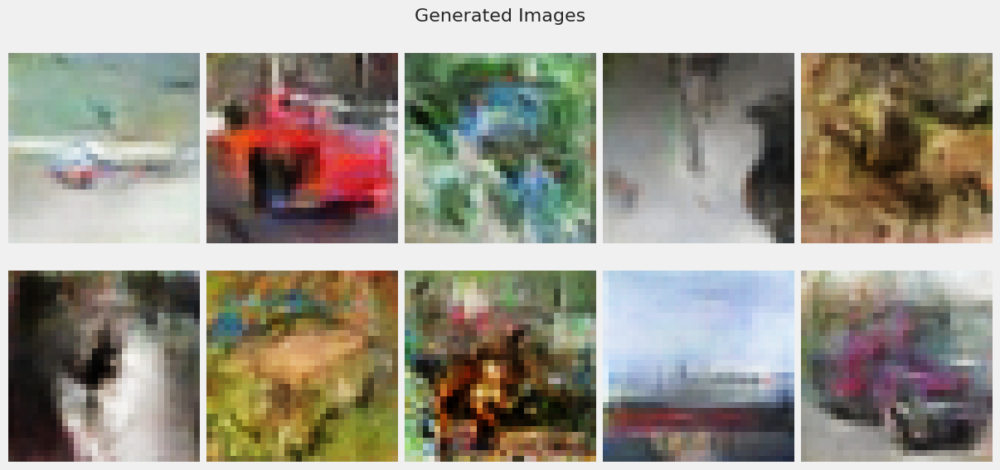

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.2510 - d_fake_loss: 0.2510 - g_loss: 3.1227 - d_acc: 0.8940 - d_realO: 0.1598 - d_fakeO: 0.8409
Epoch 32/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2468 - d_fake_loss: 0.2468 - g_loss: 3.1820 - d_acc: 0.8960 - d_realO: 0.1565 - d_fakeO: 0.8444
Epoch 33/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2756 - d_fake_loss: 0.2756 - g_loss: 3.1345 - d_acc: 0.8849 - d_realO: 0.1677 - d_fakeO: 0.8314
Epoch 34/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2547 - d_fake_loss: 0.2547 - g_loss: 3.0827 - d_acc: 0.8922 - d_realO: 0.1652 - d_fakeO: 0.8348
Epoch 35/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2352 - d_fake_loss: 0.2352 - g_loss: 3.3587 - d_acc: 0.9020 - d_realO: 0.1496 - d_fakeO: 0.8515
Epoch 36/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2314 - d_fake_los

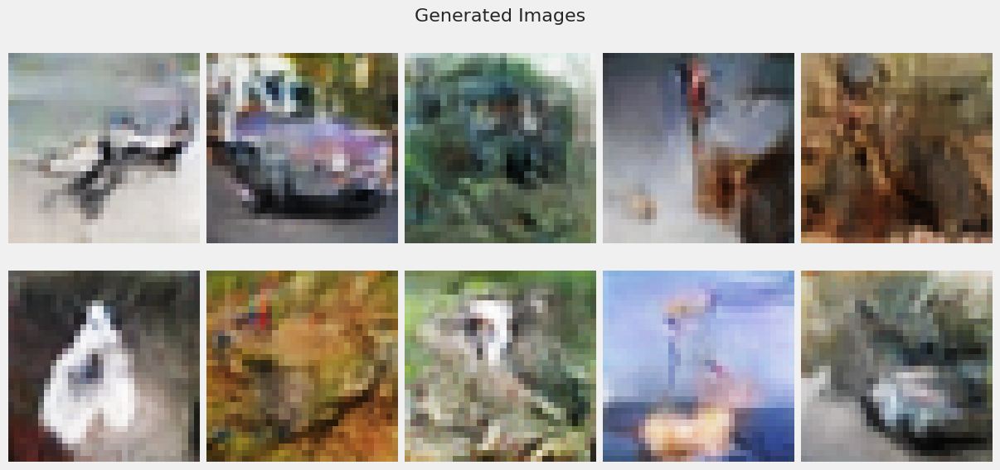

774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2051 - d_fake_loss: 0.2051 - g_loss: 3.8284 - d_acc: 0.9155 - d_realO: 0.1281 - d_fakeO: 0.8720
Epoch 42/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2039 - d_fake_loss: 0.2039 - g_loss: 3.8735 - d_acc: 0.9163 - d_realO: 0.1271 - d_fakeO: 0.8731
Epoch 43/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1995 - d_fake_loss: 0.1995 - g_loss: 3.9612 - d_acc: 0.9180 - d_realO: 0.1244 - d_fakeO: 0.8762
Epoch 44/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1915 - d_fake_loss: 0.1915 - g_loss: 4.0465 - d_acc: 0.9231 - d_realO: 0.1191 - d_fakeO: 0.8813
Epoch 45/100
774/774 [==============================] - 8s 10ms/step - d_real_loss: 0.1913 - d_fake_loss: 0.1913 - g_loss: 4.1450 - d_acc: 0.9224 - d_realO: 0.1185 - d_fakeO: 0.8818
Epoch 46/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1834 - d_fake_los

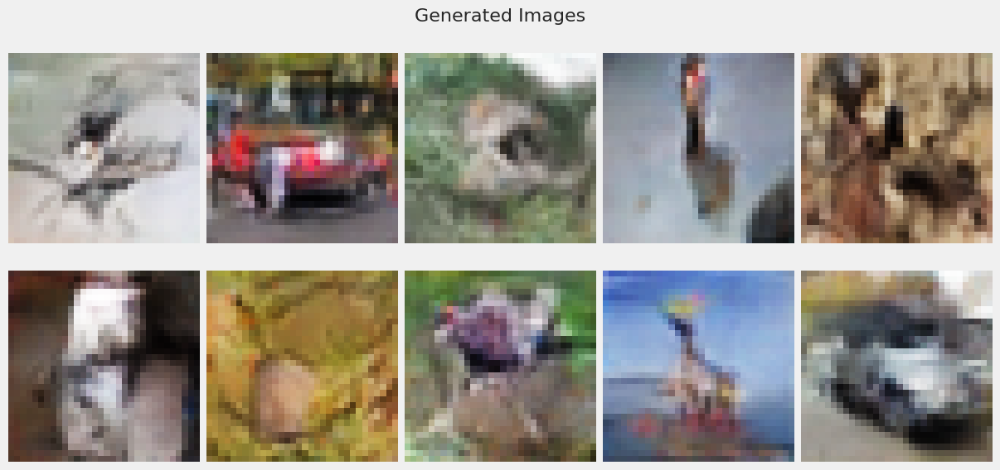

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1841 - d_fake_loss: 0.1841 - g_loss: 4.4181 - d_acc: 0.9275 - d_realO: 0.1114 - d_fakeO: 0.8892
Epoch 52/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1713 - d_fake_loss: 0.1713 - g_loss: 4.5724 - d_acc: 0.9325 - d_realO: 0.1053 - d_fakeO: 0.8950
Epoch 53/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1695 - d_fake_loss: 0.1695 - g_loss: 4.5715 - d_acc: 0.9329 - d_realO: 0.1045 - d_fakeO: 0.8958
Epoch 54/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1684 - d_fake_loss: 0.1684 - g_loss: 4.6727 - d_acc: 0.9330 - d_realO: 0.1031 - d_fakeO: 0.8974
Epoch 55/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1644 - d_fake_loss: 0.1644 - g_loss: 4.7401 - d_acc: 0.9351 - d_realO: 0.1004 - d_fakeO: 0.9001
Epoch 56/100
774/774 [==============================] - 8s 10ms/step - d_real_loss: 0.1626 - d_fake_los

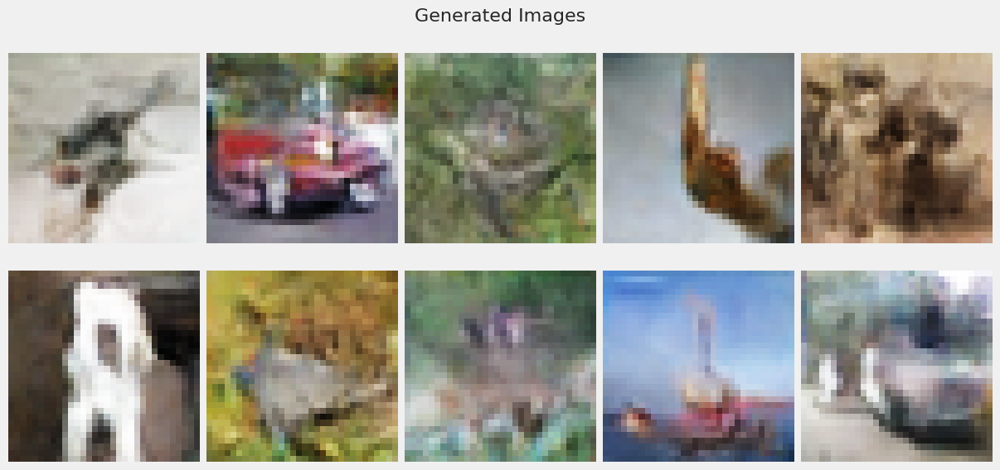

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1529 - d_fake_loss: 0.1529 - g_loss: 5.0900 - d_acc: 0.9407 - d_realO: 0.0931 - d_fakeO: 0.9075
Epoch 62/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1504 - d_fake_loss: 0.1504 - g_loss: 5.1097 - d_acc: 0.9422 - d_realO: 0.0914 - d_fakeO: 0.9092
Epoch 63/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1489 - d_fake_loss: 0.1489 - g_loss: 5.1412 - d_acc: 0.9426 - d_realO: 0.0905 - d_fakeO: 0.9098
Epoch 64/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1478 - d_fake_loss: 0.1478 - g_loss: 5.1923 - d_acc: 0.9431 - d_realO: 0.0893 - d_fakeO: 0.9108
Epoch 65/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1414 - d_fake_loss: 0.1414 - g_loss: 5.2674 - d_acc: 0.9454 - d_realO: 0.0862 - d_fakeO: 0.9143
Epoch 66/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1408 - d_fake_los

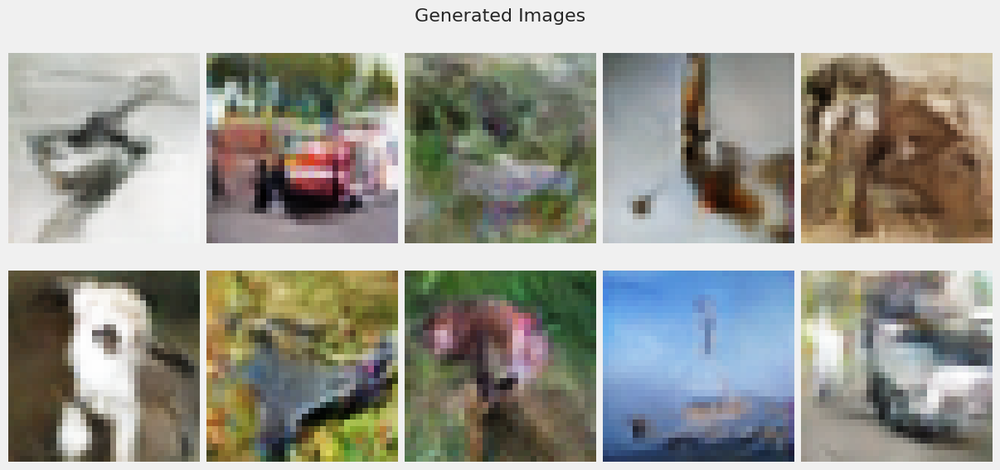

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1322 - d_fake_loss: 0.1322 - g_loss: 5.6172 - d_acc: 0.9490 - d_realO: 0.0794 - d_fakeO: 0.9209
Epoch 72/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1354 - d_fake_loss: 0.1354 - g_loss: 5.6034 - d_acc: 0.9479 - d_realO: 0.0804 - d_fakeO: 0.9200
Epoch 73/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1291 - d_fake_loss: 0.1291 - g_loss: 5.6881 - d_acc: 0.9512 - d_realO: 0.0772 - d_fakeO: 0.9232
Epoch 74/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1267 - d_fake_loss: 0.1267 - g_loss: 5.7745 - d_acc: 0.9524 - d_realO: 0.0756 - d_fakeO: 0.9247
Epoch 75/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1227 - d_fake_loss: 0.1227 - g_loss: 5.8906 - d_acc: 0.9538 - d_realO: 0.0734 - d_fakeO: 0.9272
Epoch 76/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1254 - d_fake_los

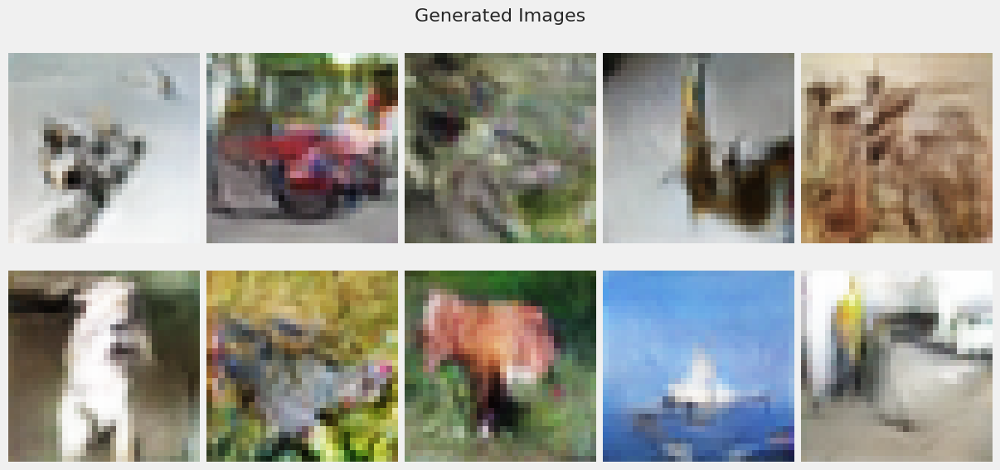

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1226 - d_fake_loss: 0.1226 - g_loss: 6.0569 - d_acc: 0.9539 - d_realO: 0.0713 - d_fakeO: 0.9286
Epoch 82/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1162 - d_fake_loss: 0.1162 - g_loss: 6.1471 - d_acc: 0.9566 - d_realO: 0.0688 - d_fakeO: 0.9315
Epoch 83/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1114 - d_fake_loss: 0.1114 - g_loss: 6.2535 - d_acc: 0.9584 - d_realO: 0.0662 - d_fakeO: 0.9340
Epoch 84/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1181 - d_fake_loss: 0.1181 - g_loss: 6.2272 - d_acc: 0.9552 - d_realO: 0.0691 - d_fakeO: 0.9313
Epoch 85/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1156 - d_fake_loss: 0.1156 - g_loss: 6.1790 - d_acc: 0.9563 - d_realO: 0.0679 - d_fakeO: 0.9324
Epoch 86/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1182 - d_fake_los

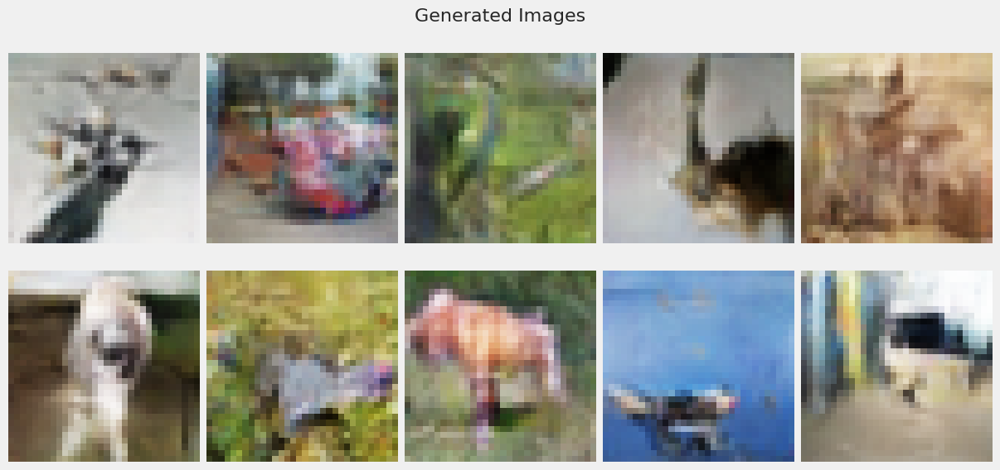

774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1082 - d_fake_loss: 0.1082 - g_loss: 6.4603 - d_acc: 0.9591 - d_realO: 0.0638 - d_fakeO: 0.9365
Epoch 92/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1081 - d_fake_loss: 0.1081 - g_loss: 6.5315 - d_acc: 0.9593 - d_realO: 0.0634 - d_fakeO: 0.9368
Epoch 93/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1094 - d_fake_loss: 0.1094 - g_loss: 6.5751 - d_acc: 0.9589 - d_realO: 0.0639 - d_fakeO: 0.9365
Epoch 94/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1084 - d_fake_loss: 0.1084 - g_loss: 6.5663 - d_acc: 0.9593 - d_realO: 0.0634 - d_fakeO: 0.9371
Epoch 95/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1068 - d_fake_loss: 0.1068 - g_loss: 6.6502 - d_acc: 0.9610 - d_realO: 0.0616 - d_fakeO: 0.9385
Epoch 96/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1053 - d_fake_los

In [30]:
gan_3 = train_gan(discriminator_cgan1, generator_cgan1, noise, 'Non-Outlier CGAN 1', dataset, 95, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  96% accuracy 
- No Model Collapse


</div>

87910968/87910968 [==============================] - 4s 0us/step


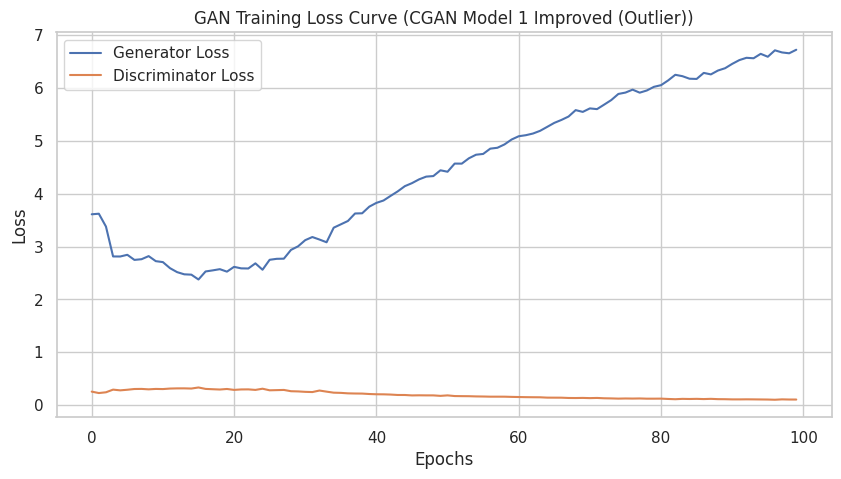

In [31]:
gan_history_3 = gan_3[0].history
generator = gan_3[1].generator  
gan_history_3['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_3['d_real_loss'], gan_history_3['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_3, title='GAN Training Loss Curve (CGAN Model 1 Improved (Outlier))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively high and drops quickly and then to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it remains around the same with minor drop at the start


</div>

In [32]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 35.389534352192214
KID Score: 0.021671562911021347


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 35 
- KID Score is 0.02
    
Around the same as baseline results

</div>

4/4 [==============================] - 0s 5ms/step
Class 0 - 100 Generated Images


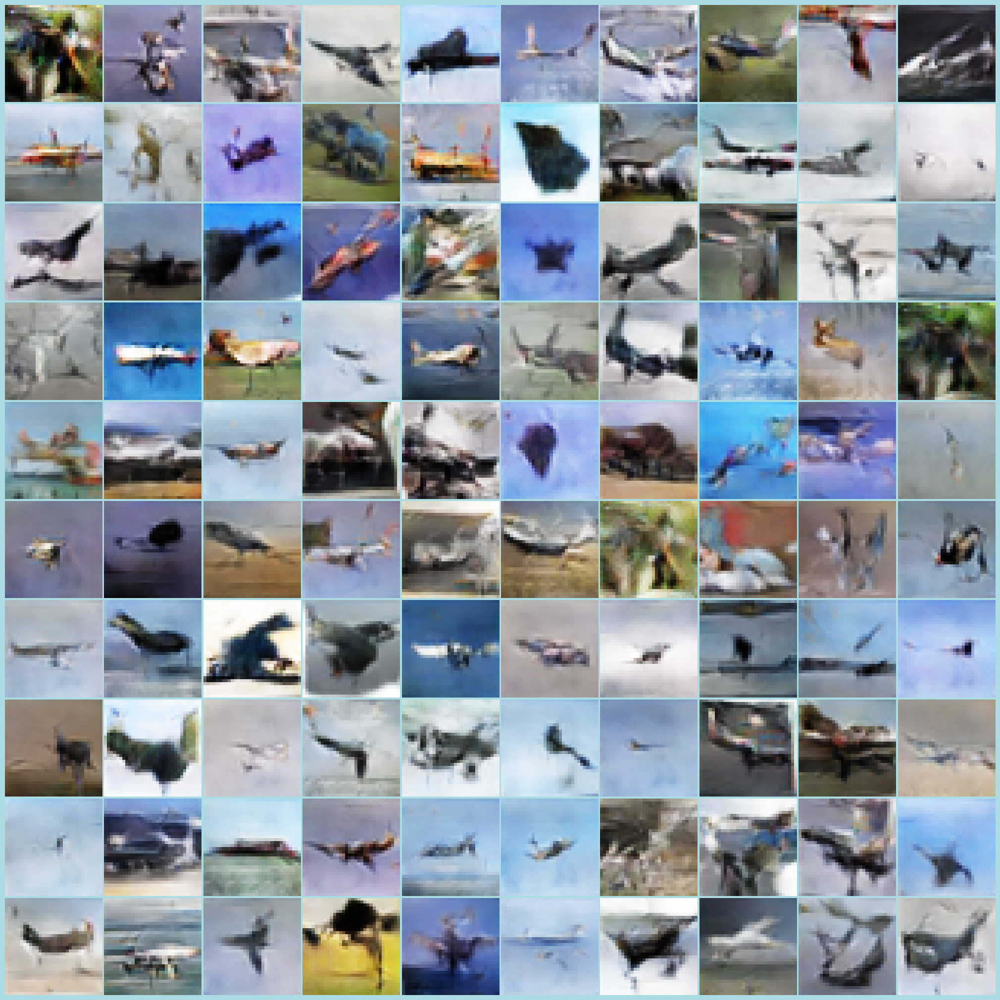

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


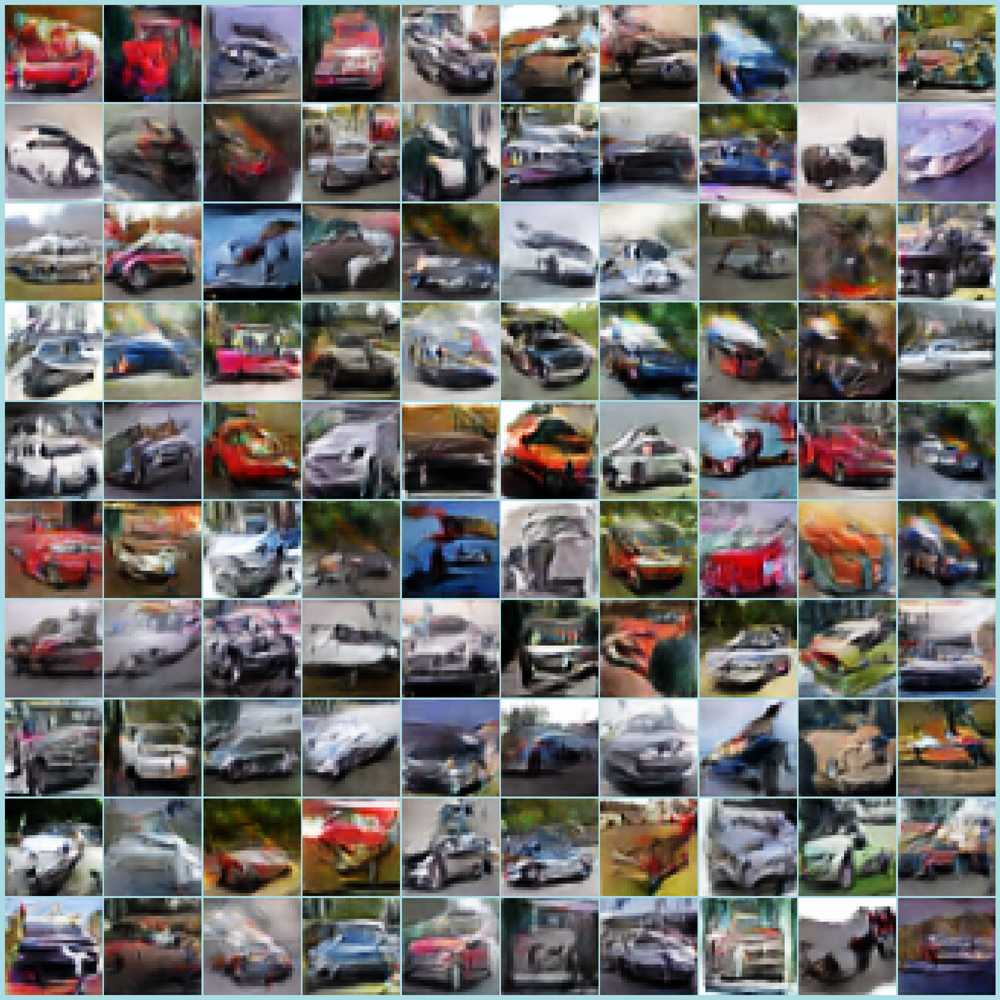

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


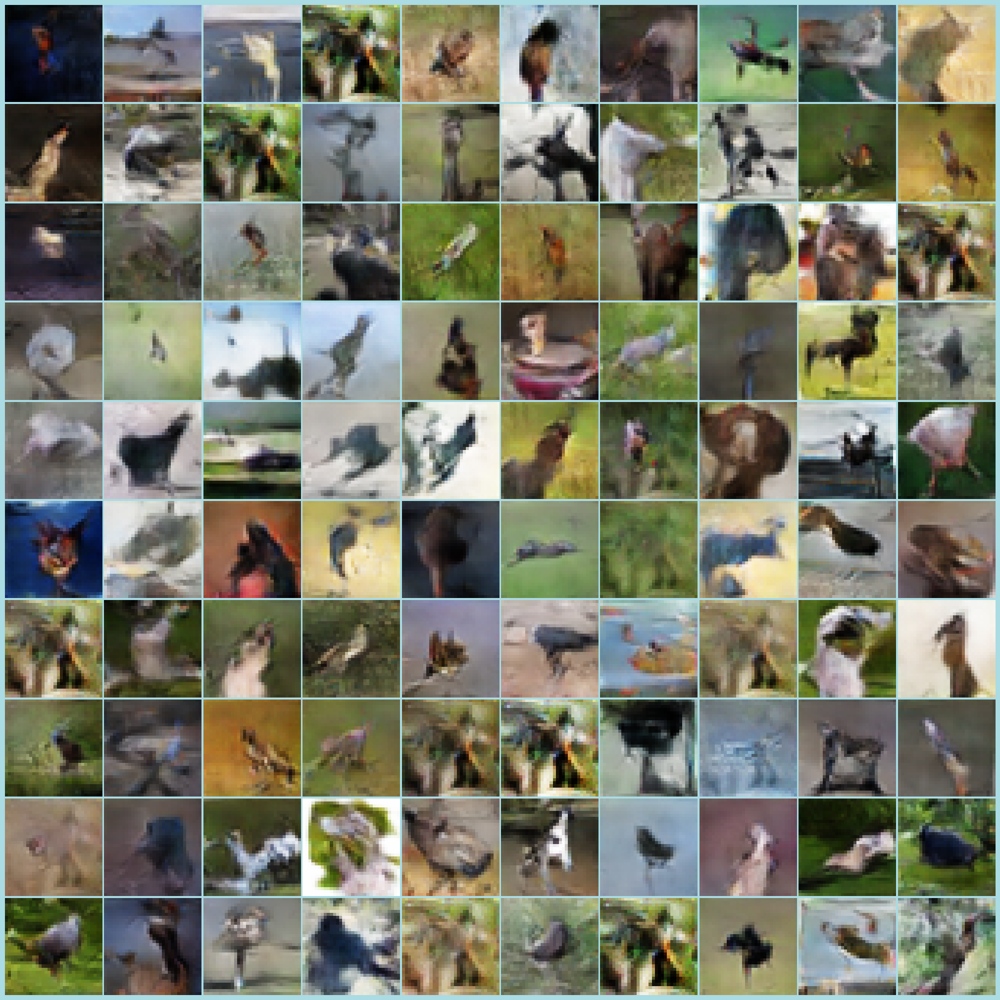

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


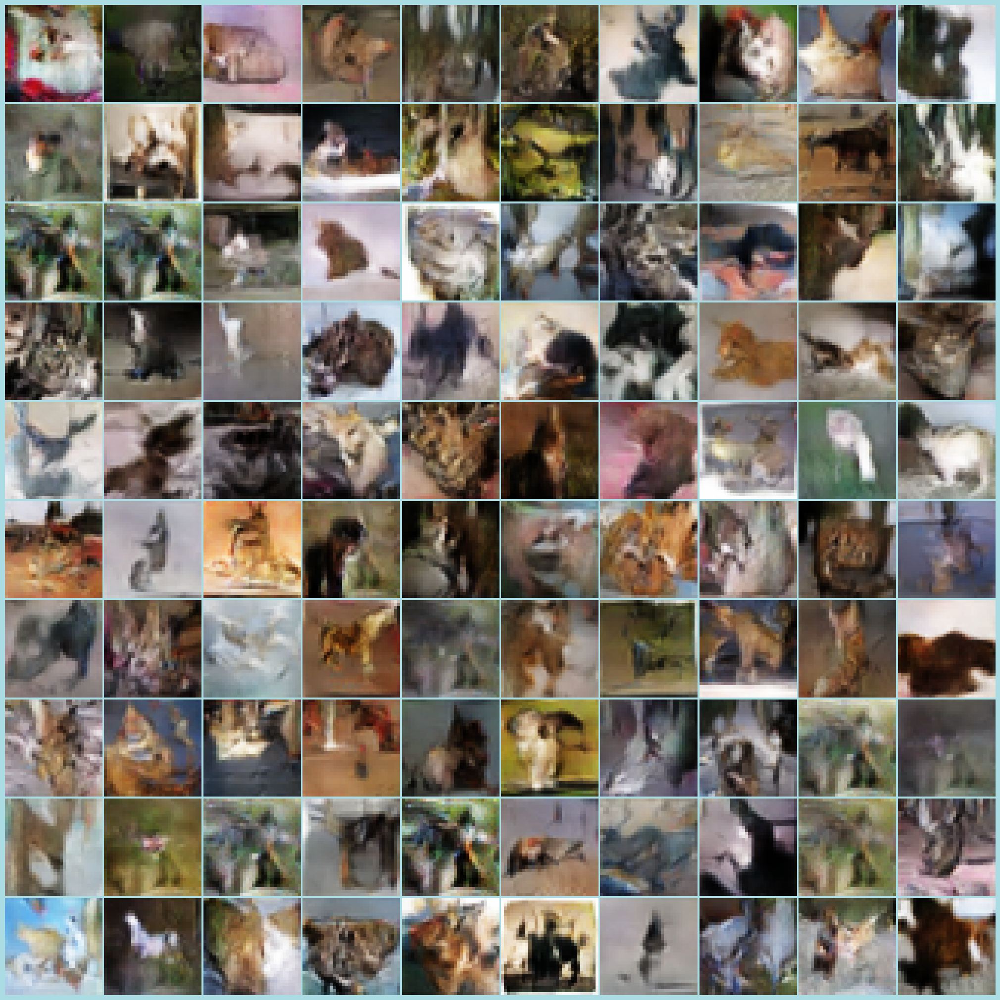

4/4 [==============================] - 0s 2ms/step
Class 4 - 100 Generated Images


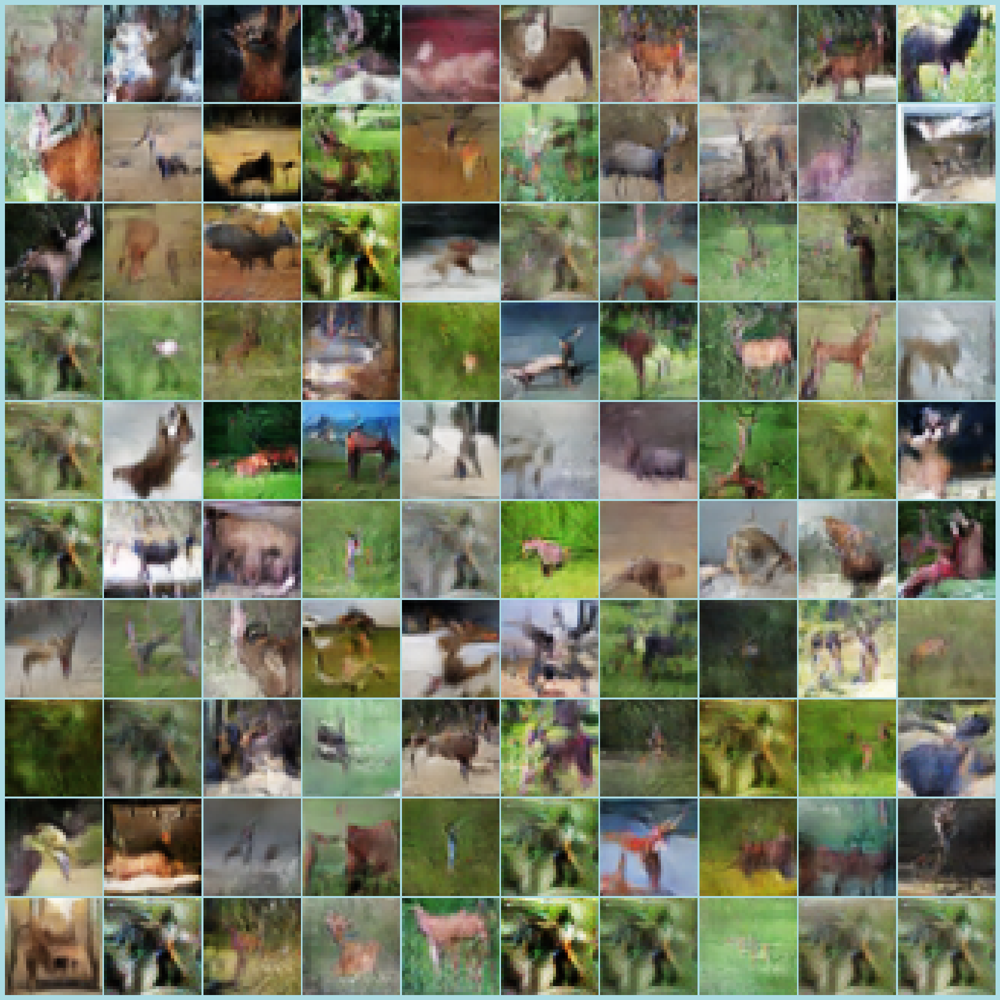

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


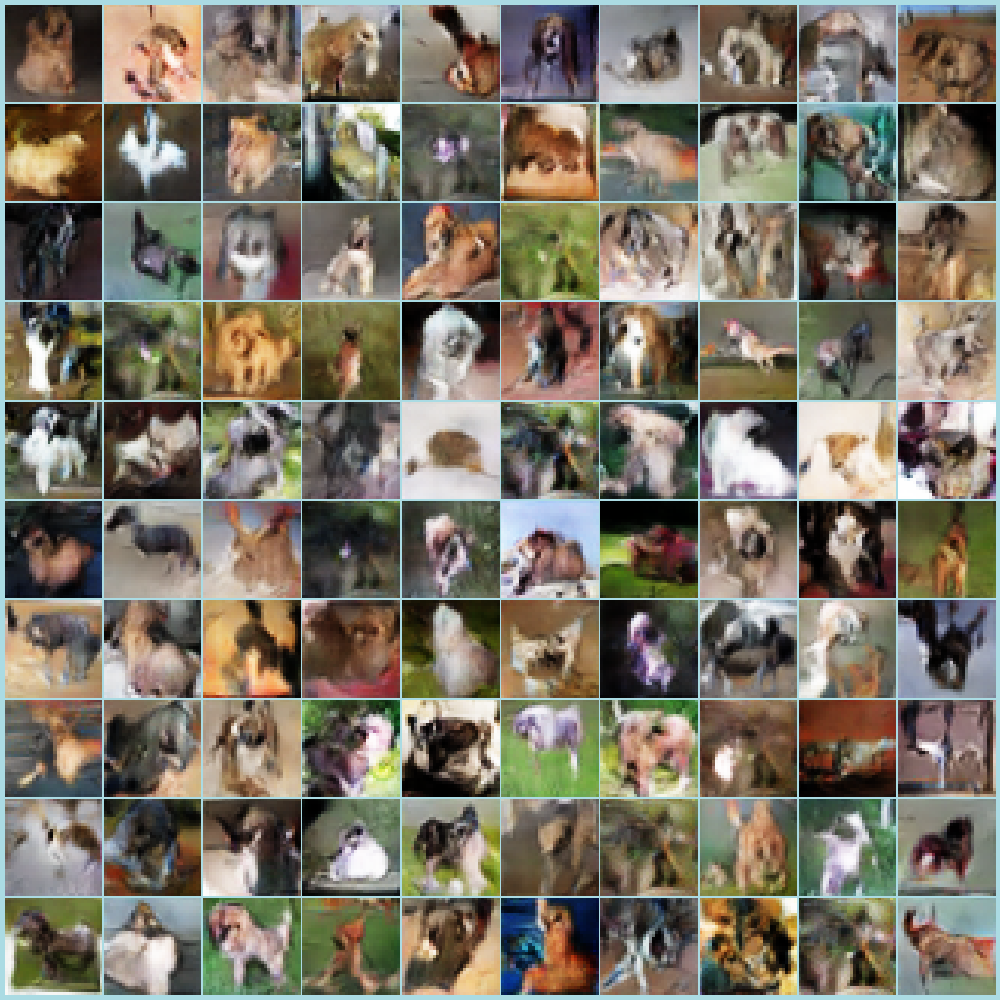

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


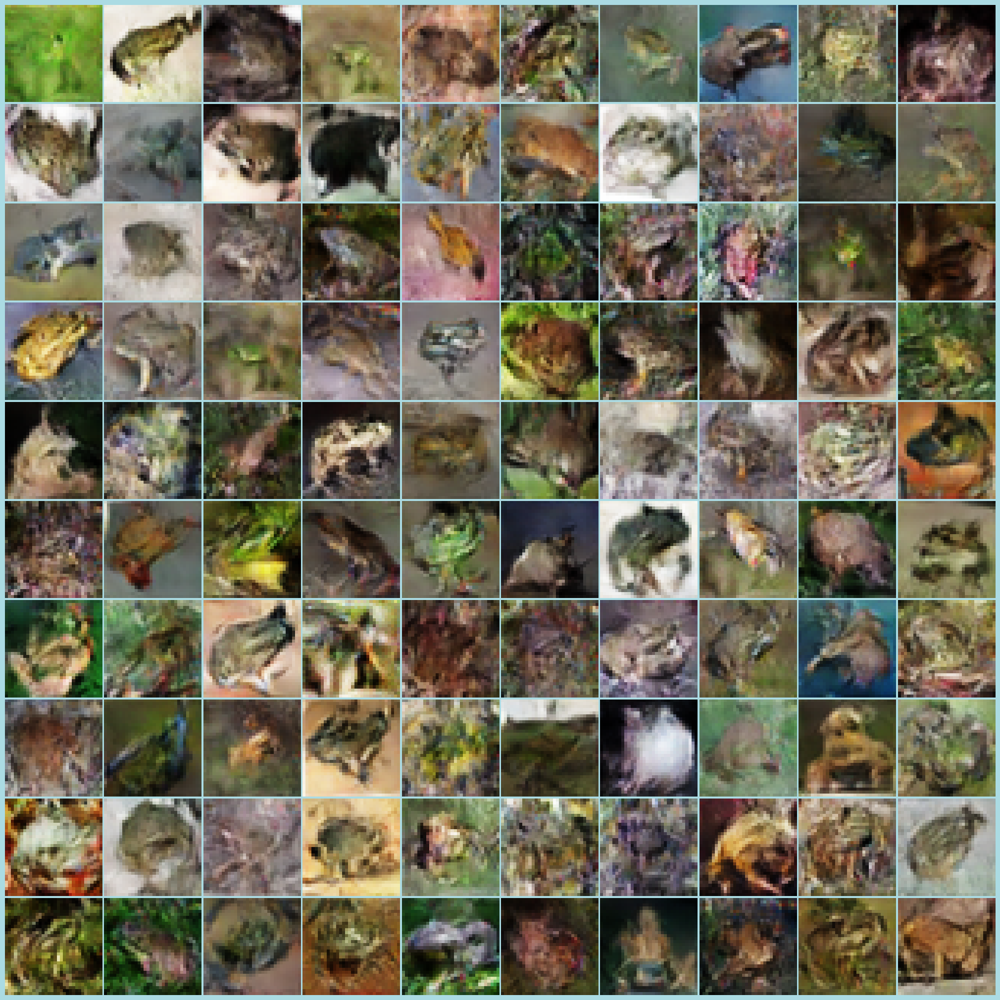

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


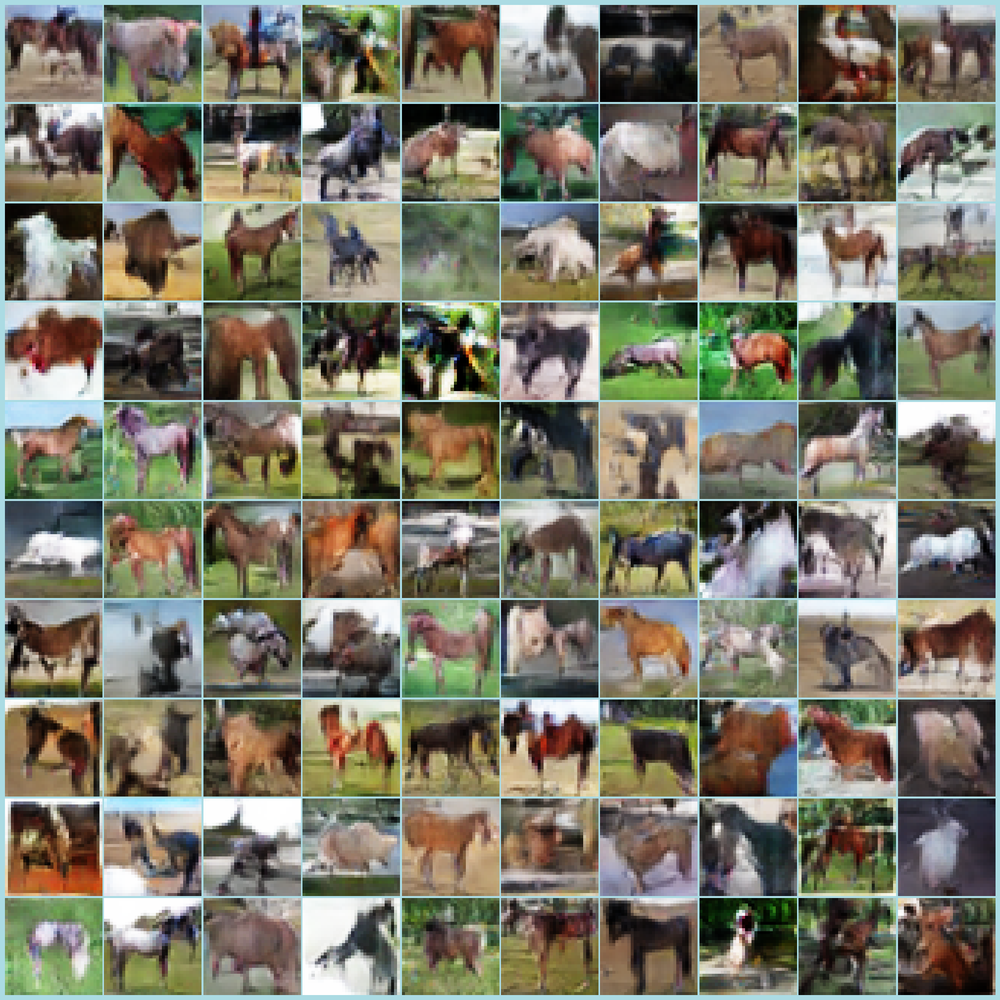

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


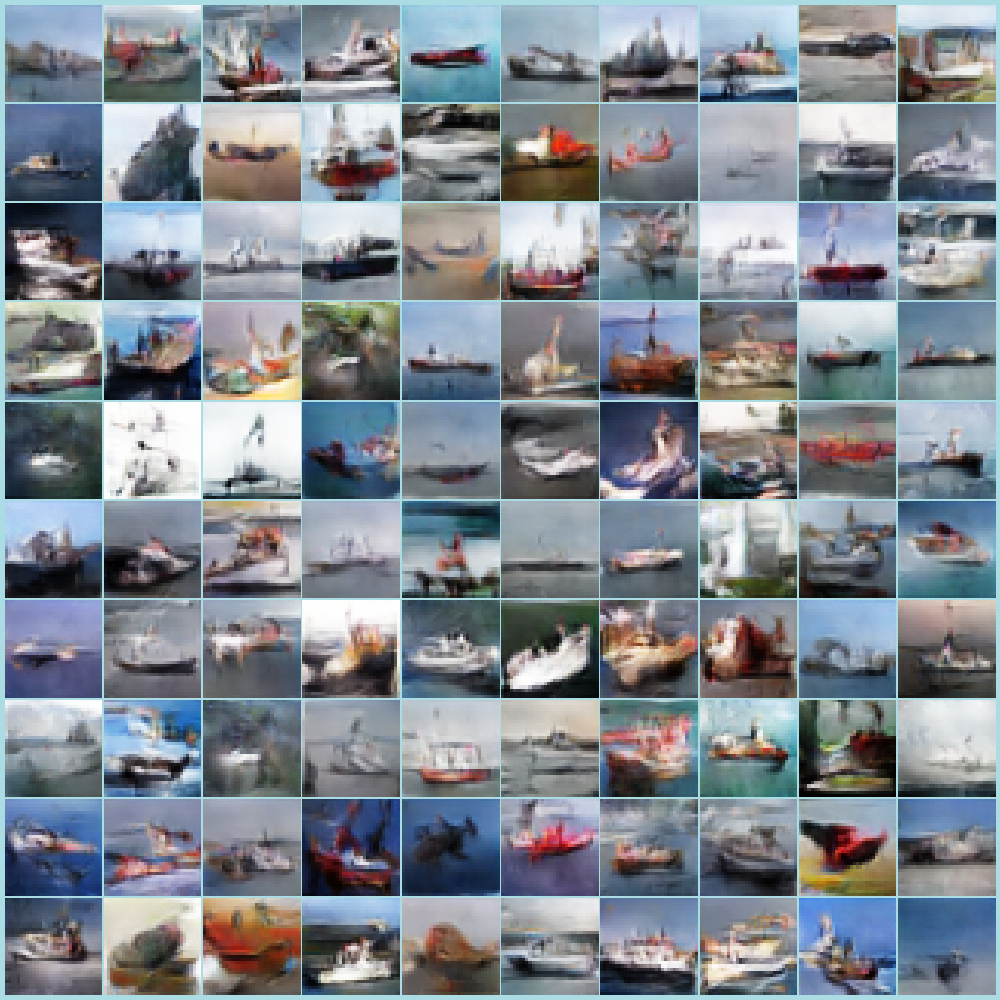

4/4 [==============================] - 0s 2ms/step
Class 9 - 100 Generated Images


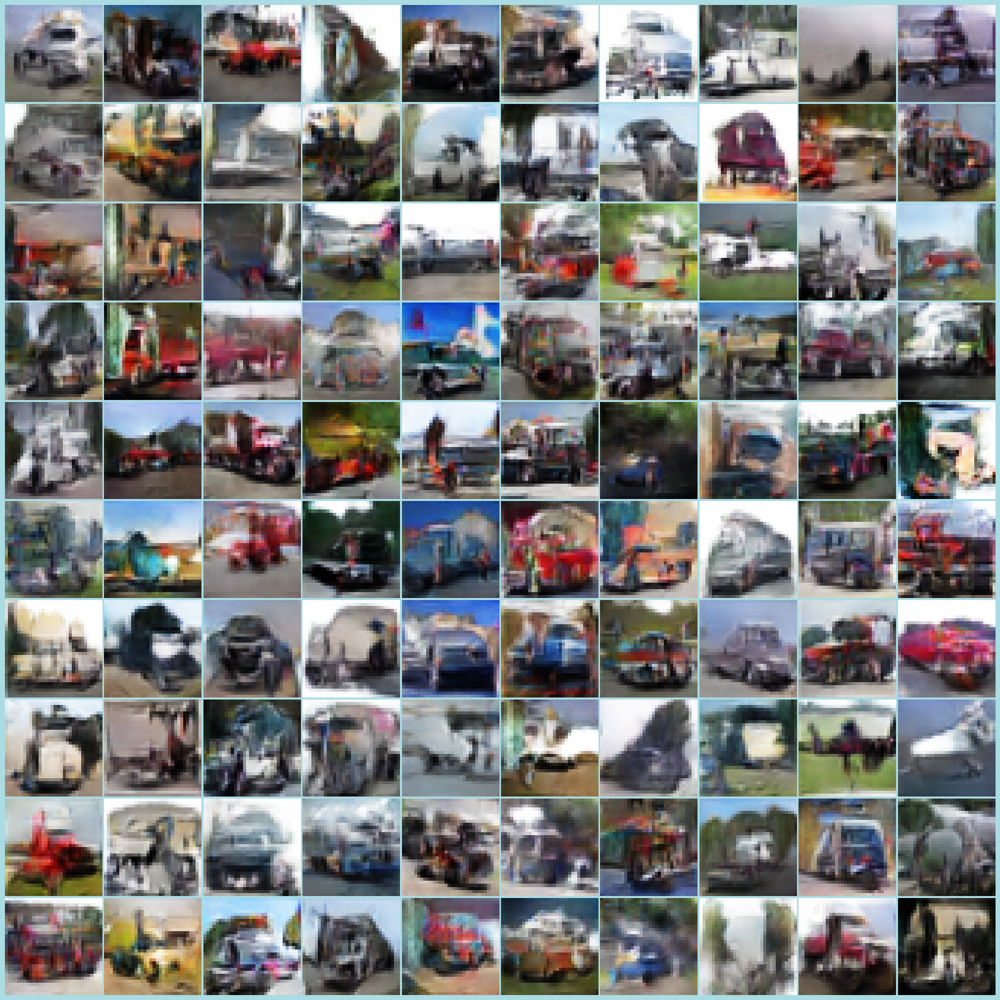

In [33]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images shows clear and concise images

</div>

#### Storing the scores

In [34]:
new_row = {'Model':'Non-Outlier CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_3['d_loss'][-1], 'g_loss':gan_history_3['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,0.021672,0.105153,6.727473


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Sharpened Image))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">

### 

## __Key Ideas__

1. Sharpening images in GANs is a post-processing step aimed at enhancing the clarity and detail of generated images, often addressing common issues like blurriness or lack of texture definition
2. This technique involves applying image processing filters, such as unsharp masking or high-pass filters, to emphasize edges and fine details, making the generated images more realistic and visually appealing
3. Image sharpening can be particularly beneficial in applications where GANs are used for super-resolution tasks, converting low-resolution images to high-resolution counterparts while maintaining high-quality details
4. Incorporating sharpening techniques into GAN frameworks can also aid in improving the perceptual quality of generated images, making them more convincing to the human eye and useful for practical applications

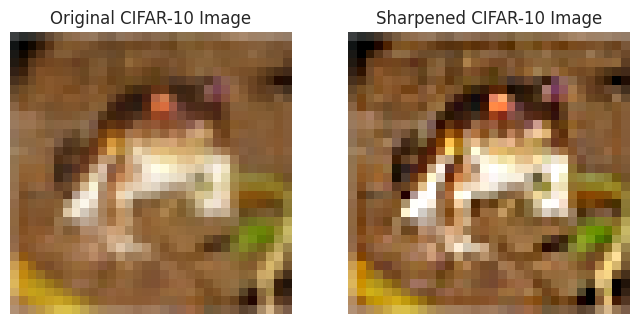

In [35]:
(x_train, _), (_, _) = tf.keras.datasets.cifar10.load_data()

image_index = 0
cifar_image = x_train[image_index]
pil_image = Image.fromarray(cifar_image)
sharpened_image = pil_image.filter(ImageFilter.SHARPEN)

plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
plt.title('Original CIFAR-10 Image')
plt.imshow(pil_image)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Sharpened CIFAR-10 Image')
plt.imshow(sharpened_image)
plt.axis('off')

plt.show()


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Image are sharpened even clearer here


</div>

In [36]:
def sharpen_images(batch):
    sharpened_batch = np.array([np.array(Image.fromarray(img).filter(ImageFilter.SHARPEN)) for img in batch])
    return sharpened_batch

#### Creating Checkpoint

In [37]:
callbacks = [CGANImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='SharpenedImage CGAN-1')]

#### Training

In [38]:
x_train_sharpened = sharpen_images(x_train)

In [39]:
dataset_s = tf.data.Dataset.from_tensor_slices((x_train_sharpened,y_train))
dataset_s = dataset_s.shuffle(buffer_size=sizeOfBuffer).batch(batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [40]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

Epoch 1/100
774/774 [==============================] - ETA: 0s - d_real_loss: 0.2407 - d_fake_loss: 0.2407 - g_loss: 3.5839 - d_acc: 0.9139 - d_realO: 0.1388 - d_fakeO: 0.8671

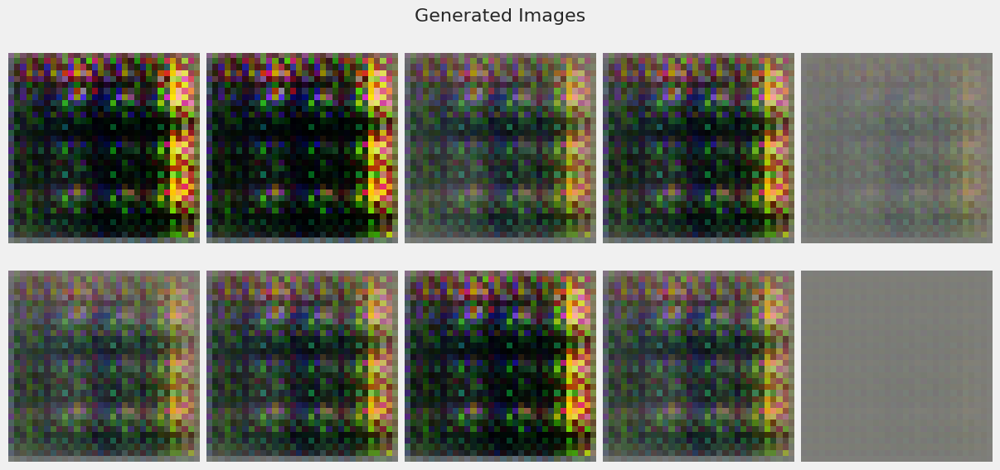

774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.2407 - d_fake_loss: 0.2407 - g_loss: 3.5839 - d_acc: 0.9139 - d_realO: 0.1388 - d_fakeO: 0.8671
Epoch 2/100
774/774 [==============================] - 8s 10ms/step - d_real_loss: 0.2635 - d_fake_loss: 0.2635 - g_loss: 3.3450 - d_acc: 0.9108 - d_realO: 0.1455 - d_fakeO: 0.8501
Epoch 3/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2269 - d_fake_loss: 0.2269 - g_loss: 3.4353 - d_acc: 0.9225 - d_realO: 0.1306 - d_fakeO: 0.8694
Epoch 4/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2932 - d_fake_loss: 0.2932 - g_loss: 2.7396 - d_acc: 0.8868 - d_realO: 0.1846 - d_fakeO: 0.8191
Epoch 5/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2830 - d_fake_loss: 0.2830 - g_loss: 2.7766 - d_acc: 0.8881 - d_realO: 0.1775 - d_fakeO: 0.8292
Epoch 6/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3247 - d_fake_loss: 0

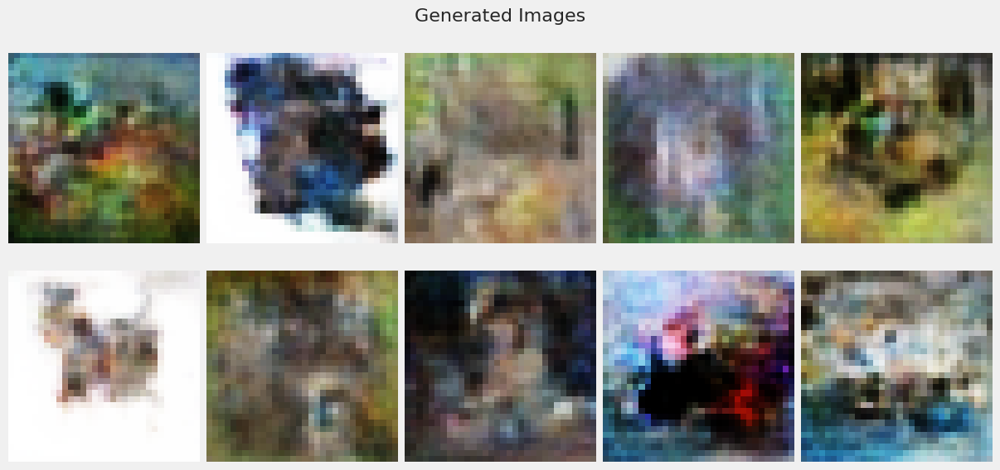

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.3260 - d_fake_loss: 0.3260 - g_loss: 2.5490 - d_acc: 0.8603 - d_realO: 0.2084 - d_fakeO: 0.7924
Epoch 12/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3191 - d_fake_loss: 0.3191 - g_loss: 2.5500 - d_acc: 0.8627 - d_realO: 0.2042 - d_fakeO: 0.7965
Epoch 13/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3366 - d_fake_loss: 0.3366 - g_loss: 2.4780 - d_acc: 0.8546 - d_realO: 0.2128 - d_fakeO: 0.7868
Epoch 14/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3247 - d_fake_loss: 0.3247 - g_loss: 2.4959 - d_acc: 0.8596 - d_realO: 0.2085 - d_fakeO: 0.7918
Epoch 15/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3236 - d_fake_loss: 0.3236 - g_loss: 2.4456 - d_acc: 0.8583 - d_realO: 0.2081 - d_fakeO: 0.7933
Epoch 16/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.3263 - d_fake_los

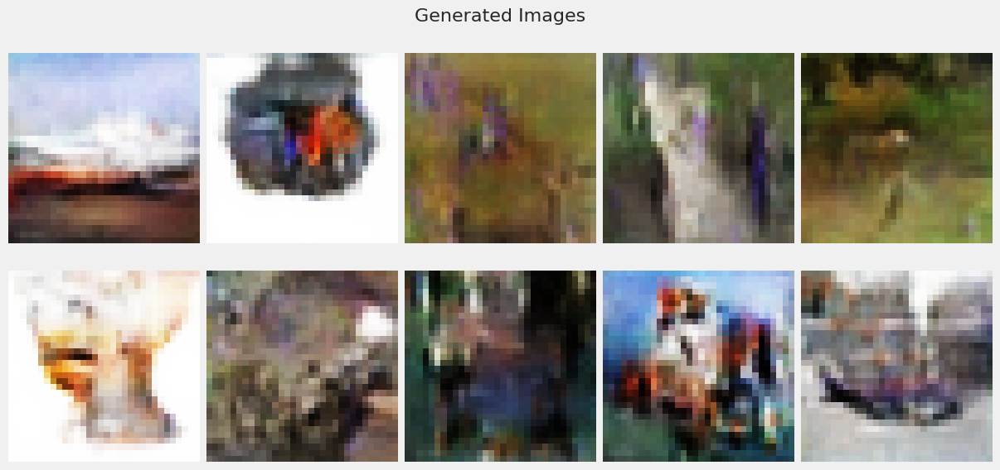

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.2980 - d_fake_loss: 0.2980 - g_loss: 2.5577 - d_acc: 0.8714 - d_realO: 0.1913 - d_fakeO: 0.8094
Epoch 22/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2895 - d_fake_loss: 0.2895 - g_loss: 2.6177 - d_acc: 0.8754 - d_realO: 0.1862 - d_fakeO: 0.8149
Epoch 23/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2915 - d_fake_loss: 0.2915 - g_loss: 2.6427 - d_acc: 0.8737 - d_realO: 0.1860 - d_fakeO: 0.8149
Epoch 24/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2907 - d_fake_loss: 0.2907 - g_loss: 2.6333 - d_acc: 0.8743 - d_realO: 0.1854 - d_fakeO: 0.8153
Epoch 25/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2842 - d_fake_loss: 0.2842 - g_loss: 2.7014 - d_acc: 0.8761 - d_realO: 0.1817 - d_fakeO: 0.8196
Epoch 26/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.3179 - d_fake_los

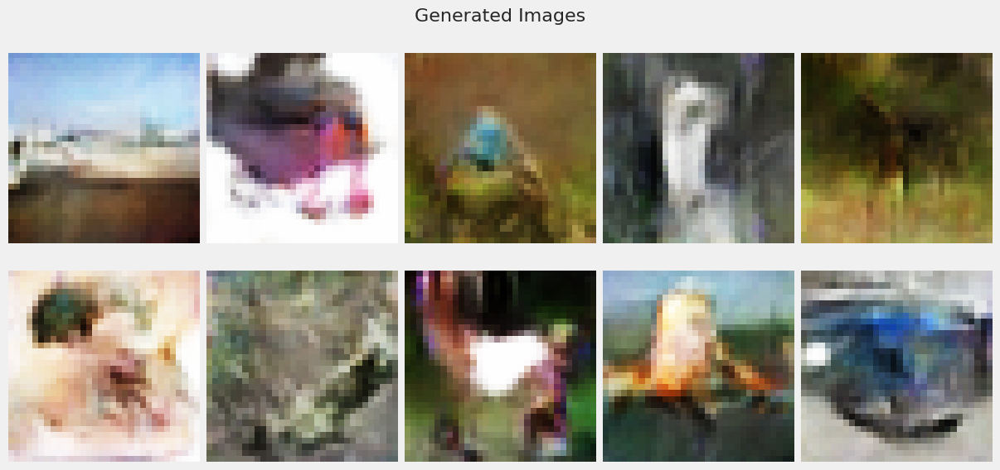

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.2551 - d_fake_loss: 0.2551 - g_loss: 3.0465 - d_acc: 0.8917 - d_realO: 0.1624 - d_fakeO: 0.8383
Epoch 32/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2459 - d_fake_loss: 0.2459 - g_loss: 3.1463 - d_acc: 0.8954 - d_realO: 0.1569 - d_fakeO: 0.8440
Epoch 33/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2449 - d_fake_loss: 0.2449 - g_loss: 3.1986 - d_acc: 0.8970 - d_realO: 0.1544 - d_fakeO: 0.8460
Epoch 34/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2789 - d_fake_loss: 0.2789 - g_loss: 3.0267 - d_acc: 0.8821 - d_realO: 0.1751 - d_fakeO: 0.8248
Epoch 35/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2350 - d_fake_loss: 0.2350 - g_loss: 3.3291 - d_acc: 0.9019 - d_realO: 0.1480 - d_fakeO: 0.8529
Epoch 36/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2812 - d_fake_los

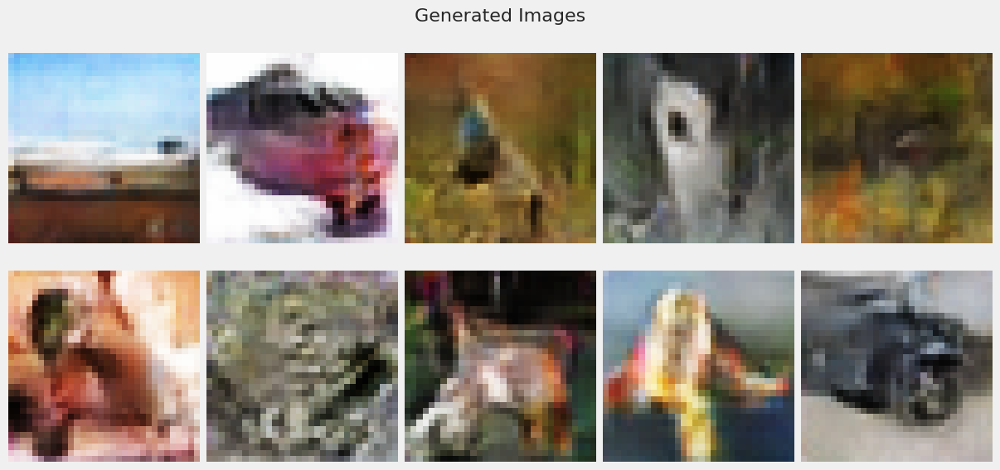

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.2134 - d_fake_loss: 0.2134 - g_loss: 3.7719 - d_acc: 0.9121 - d_realO: 0.1330 - d_fakeO: 0.8673
Epoch 42/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.2134 - d_fake_loss: 0.2134 - g_loss: 3.7814 - d_acc: 0.9118 - d_realO: 0.1325 - d_fakeO: 0.8682
Epoch 43/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.2063 - d_fake_loss: 0.2063 - g_loss: 3.8826 - d_acc: 0.9159 - d_realO: 0.1278 - d_fakeO: 0.8725
Epoch 44/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1998 - d_fake_loss: 0.1998 - g_loss: 3.9641 - d_acc: 0.9188 - d_realO: 0.1240 - d_fakeO: 0.8764
Epoch 45/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1932 - d_fake_loss: 0.1932 - g_loss: 4.0463 - d_acc: 0.9222 - d_realO: 0.1196 - d_fakeO: 0.8804
Epoch 46/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1858 - d_fake_los

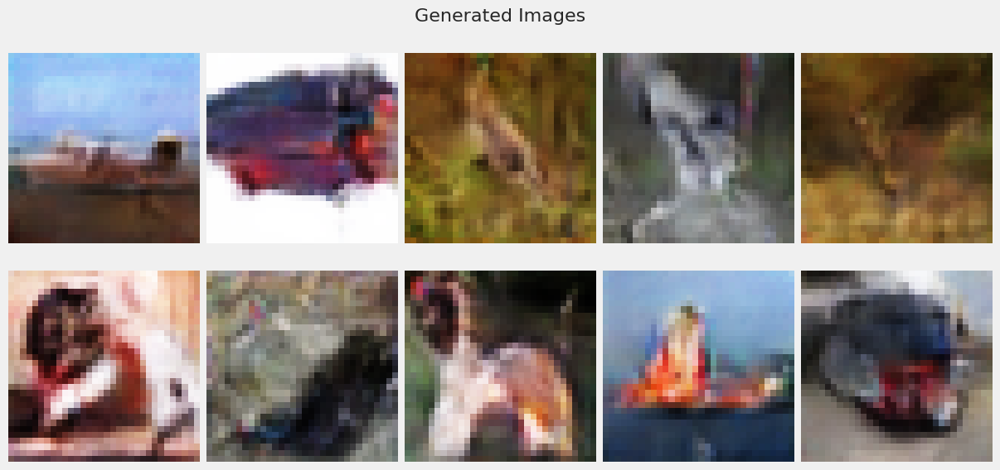

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1776 - d_fake_loss: 0.1776 - g_loss: 4.4955 - d_acc: 0.9294 - d_realO: 0.1079 - d_fakeO: 0.8920
Epoch 52/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1795 - d_fake_loss: 0.1795 - g_loss: 4.5076 - d_acc: 0.9283 - d_realO: 0.1094 - d_fakeO: 0.8916
Epoch 53/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1752 - d_fake_loss: 0.1752 - g_loss: 4.5068 - d_acc: 0.9313 - d_realO: 0.1066 - d_fakeO: 0.8933
Epoch 54/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1725 - d_fake_loss: 0.1725 - g_loss: 4.5872 - d_acc: 0.9319 - d_realO: 0.1052 - d_fakeO: 0.8952
Epoch 55/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1671 - d_fake_loss: 0.1671 - g_loss: 4.6249 - d_acc: 0.9334 - d_realO: 0.1027 - d_fakeO: 0.8977
Epoch 56/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1635 - d_fake_los

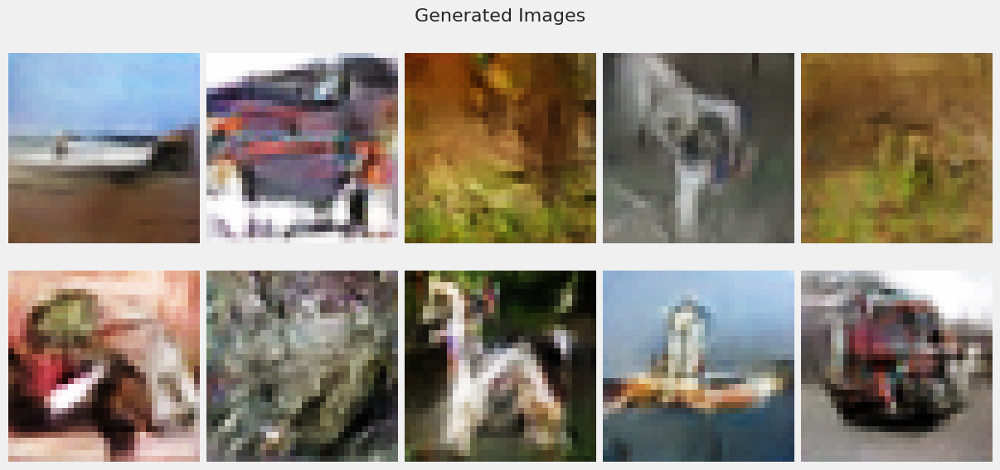

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1552 - d_fake_loss: 0.1552 - g_loss: 4.9495 - d_acc: 0.9387 - d_realO: 0.0941 - d_fakeO: 0.9062
Epoch 62/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1516 - d_fake_loss: 0.1516 - g_loss: 5.0714 - d_acc: 0.9410 - d_realO: 0.0919 - d_fakeO: 0.9088
Epoch 63/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1525 - d_fake_loss: 0.1525 - g_loss: 5.1088 - d_acc: 0.9407 - d_realO: 0.0908 - d_fakeO: 0.9093
Epoch 64/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1490 - d_fake_loss: 0.1490 - g_loss: 5.1527 - d_acc: 0.9417 - d_realO: 0.0895 - d_fakeO: 0.9109
Epoch 65/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1471 - d_fake_loss: 0.1471 - g_loss: 5.2179 - d_acc: 0.9435 - d_realO: 0.0883 - d_fakeO: 0.9120
Epoch 66/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1454 - d_fake_los

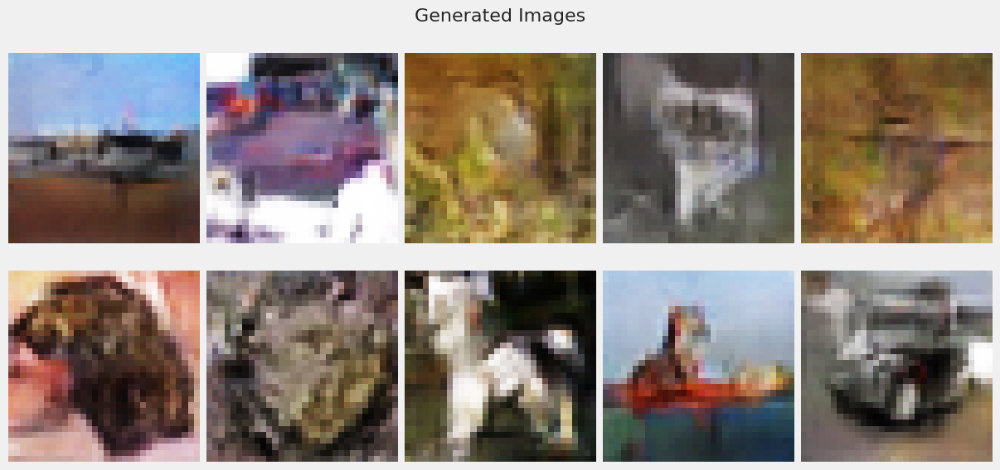

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1411 - d_fake_loss: 0.1411 - g_loss: 5.4181 - d_acc: 0.9453 - d_realO: 0.0839 - d_fakeO: 0.9166
Epoch 72/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1389 - d_fake_loss: 0.1389 - g_loss: 5.5567 - d_acc: 0.9468 - d_realO: 0.0825 - d_fakeO: 0.9178
Epoch 73/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1386 - d_fake_loss: 0.1386 - g_loss: 5.5084 - d_acc: 0.9466 - d_realO: 0.0823 - d_fakeO: 0.9183
Epoch 74/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1348 - d_fake_loss: 0.1348 - g_loss: 5.5386 - d_acc: 0.9485 - d_realO: 0.0806 - d_fakeO: 0.9198
Epoch 75/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1344 - d_fake_loss: 0.1344 - g_loss: 5.6573 - d_acc: 0.9482 - d_realO: 0.0802 - d_fakeO: 0.9203
Epoch 76/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1306 - d_fake_los

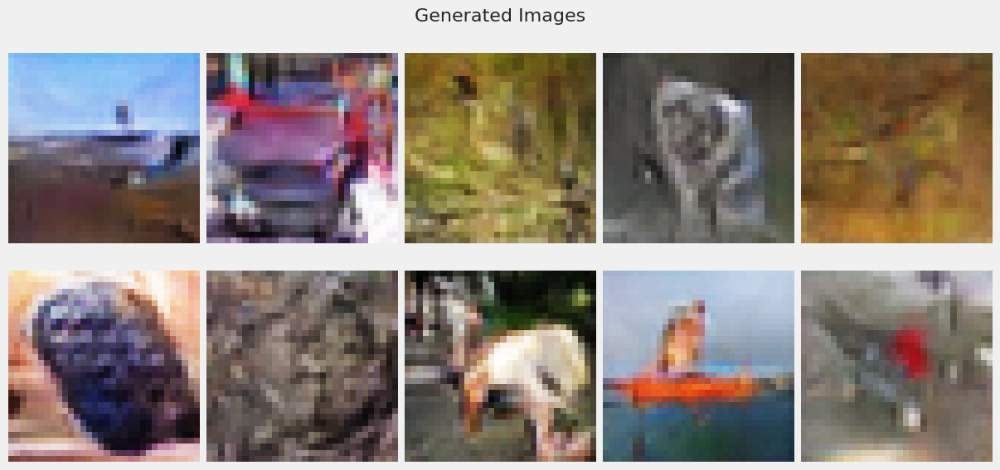

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1270 - d_fake_loss: 0.1270 - g_loss: 5.9201 - d_acc: 0.9509 - d_realO: 0.0746 - d_fakeO: 0.9256
Epoch 82/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1238 - d_fake_loss: 0.1238 - g_loss: 5.9303 - d_acc: 0.9533 - d_realO: 0.0729 - d_fakeO: 0.9272
Epoch 83/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1217 - d_fake_loss: 0.1217 - g_loss: 6.0223 - d_acc: 0.9535 - d_realO: 0.0723 - d_fakeO: 0.9283
Epoch 84/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1230 - d_fake_loss: 0.1230 - g_loss: 6.0622 - d_acc: 0.9538 - d_realO: 0.0723 - d_fakeO: 0.9279
Epoch 85/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1153 - d_fake_loss: 0.1153 - g_loss: 6.1731 - d_acc: 0.9560 - d_realO: 0.0681 - d_fakeO: 0.9321
Epoch 86/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1161 - d_fake_los

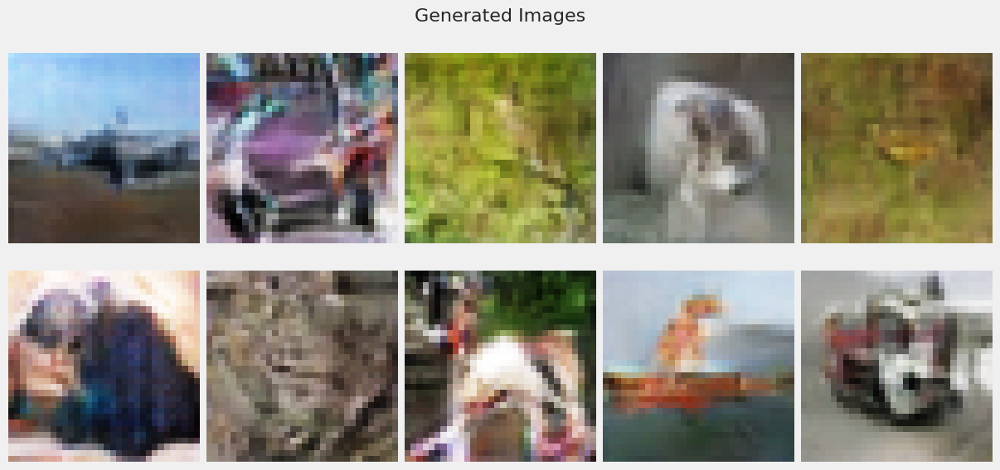

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.1098 - d_fake_loss: 0.1098 - g_loss: 6.4242 - d_acc: 0.9591 - d_realO: 0.0638 - d_fakeO: 0.9362
Epoch 92/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1100 - d_fake_loss: 0.1100 - g_loss: 6.4389 - d_acc: 0.9584 - d_realO: 0.0647 - d_fakeO: 0.9360
Epoch 93/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1122 - d_fake_loss: 0.1122 - g_loss: 6.4121 - d_acc: 0.9575 - d_realO: 0.0648 - d_fakeO: 0.9357
Epoch 94/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1082 - d_fake_loss: 0.1082 - g_loss: 6.4899 - d_acc: 0.9591 - d_realO: 0.0631 - d_fakeO: 0.9368
Epoch 95/100
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.1121 - d_fake_loss: 0.1121 - g_loss: 6.5413 - d_acc: 0.9587 - d_realO: 0.0643 - d_fakeO: 0.9363
Epoch 96/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.1052 - d_fake_los

In [41]:
gan_4 = train_gan(discriminator_cgan1, generator_cgan1, noise, 'Sharpened-Image CGAN 1', dataset_s, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  96% accuracy
- No model collapse


</div>

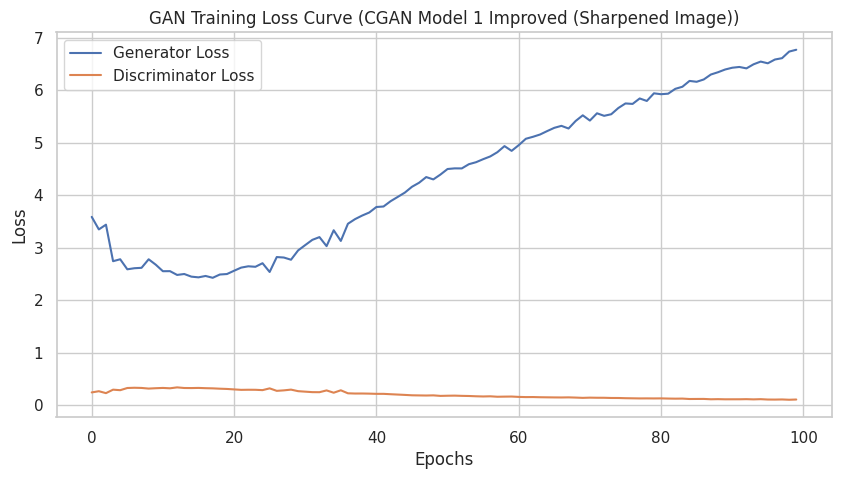

In [42]:
gan_history_4 = gan_4[0].history
generator = gan_4[1].generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (CGAN Model 1 Improved (Sharpened Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [43]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 680924.4694918189
KID Score: 33728960.70722568


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID and KID score may not be too good for evaluating this
    

</div>

4/4 [==============================] - 0s 2ms/step
Class 0 - 100 Generated Images


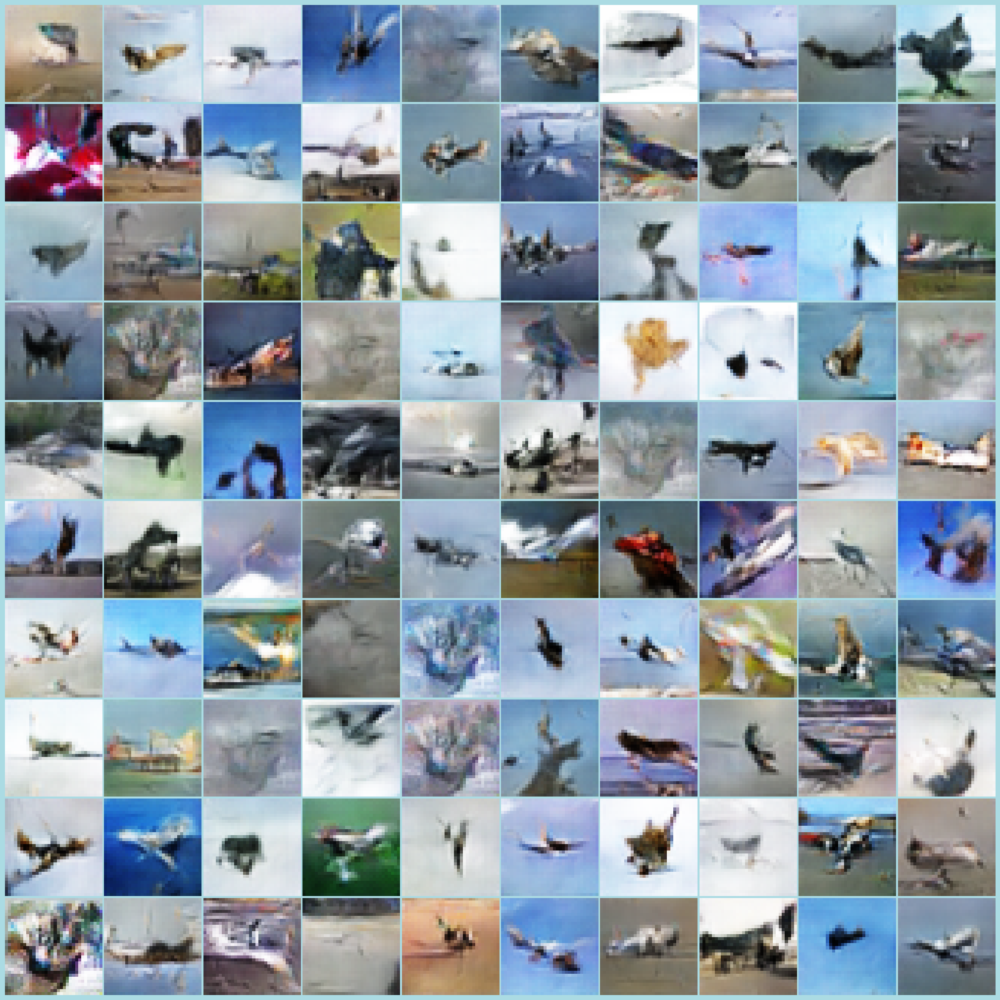

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


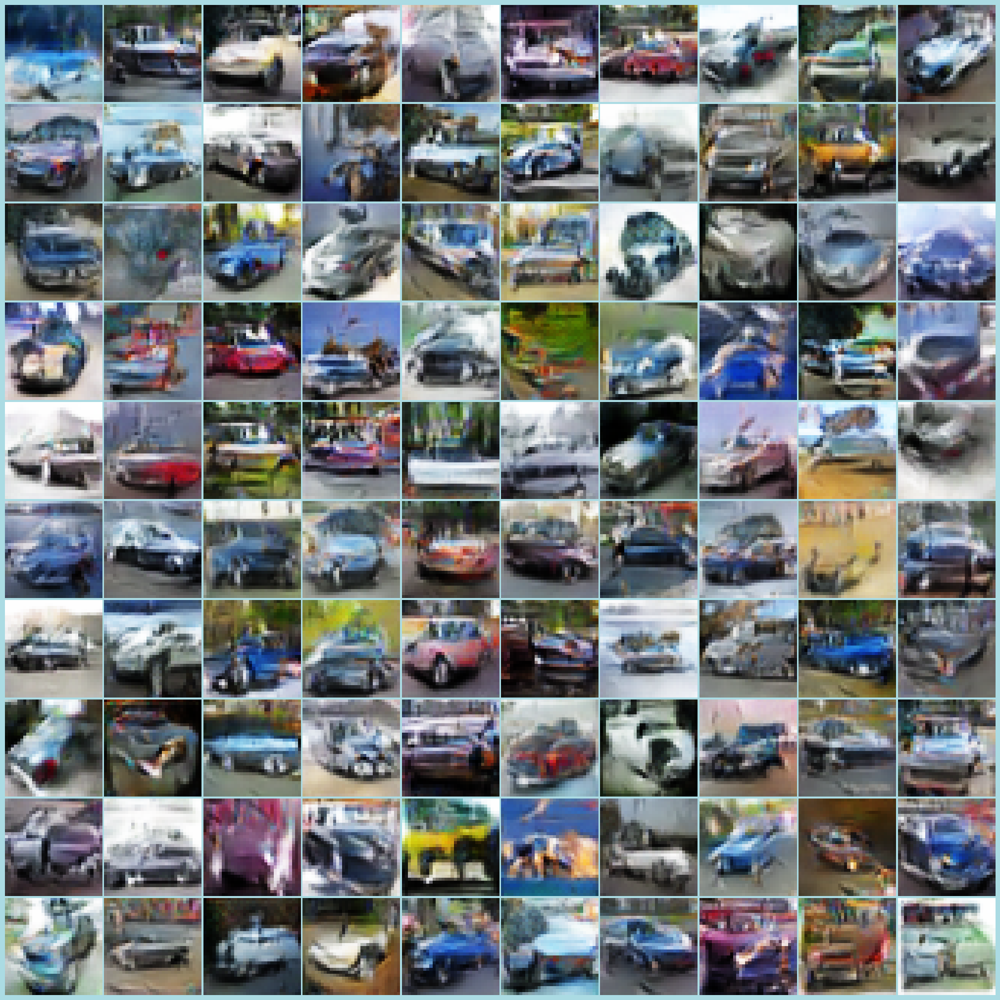

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


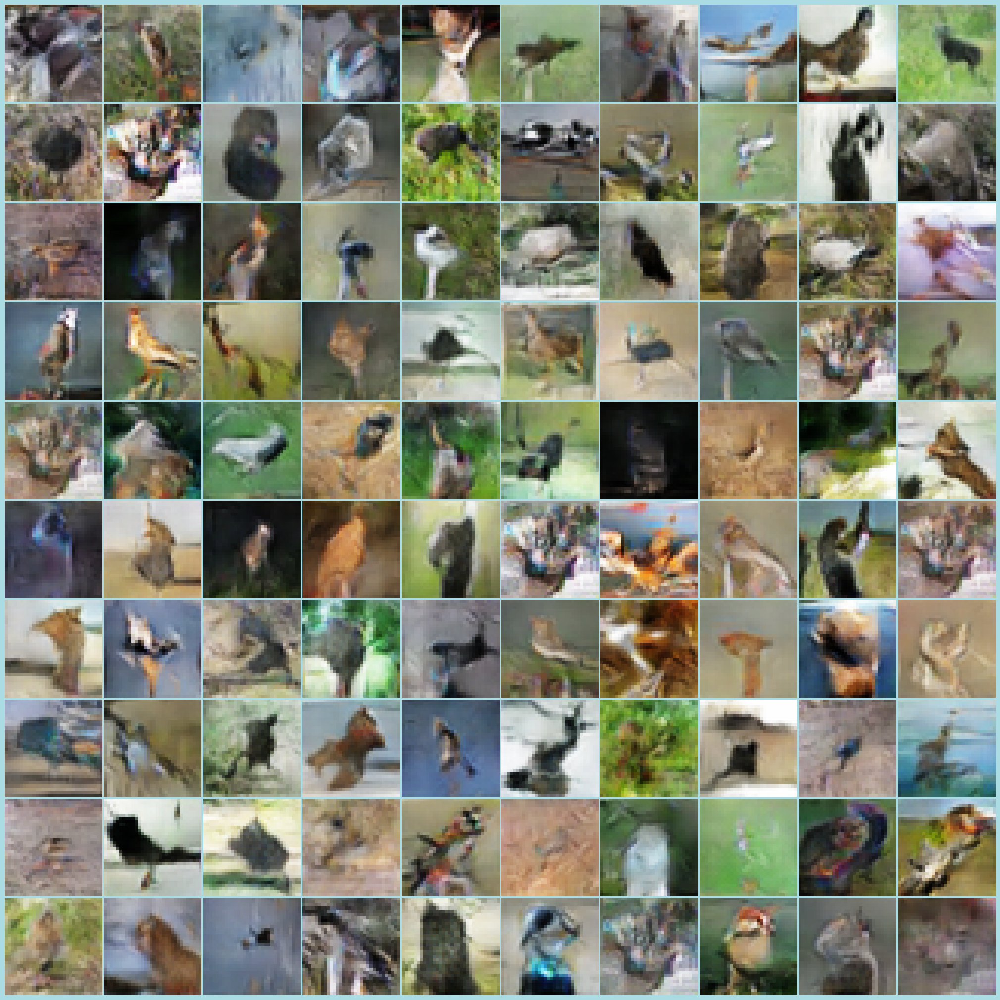

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


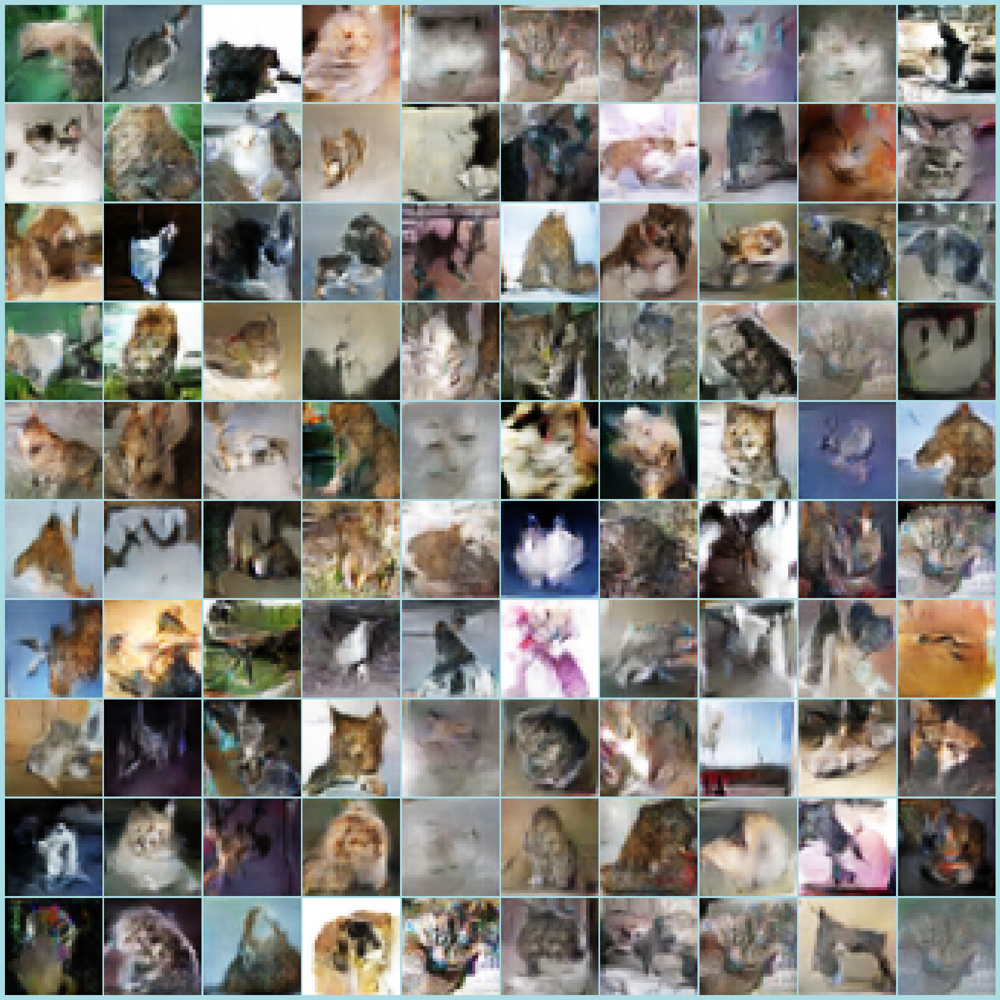

4/4 [==============================] - 0s 2ms/step
Class 4 - 100 Generated Images


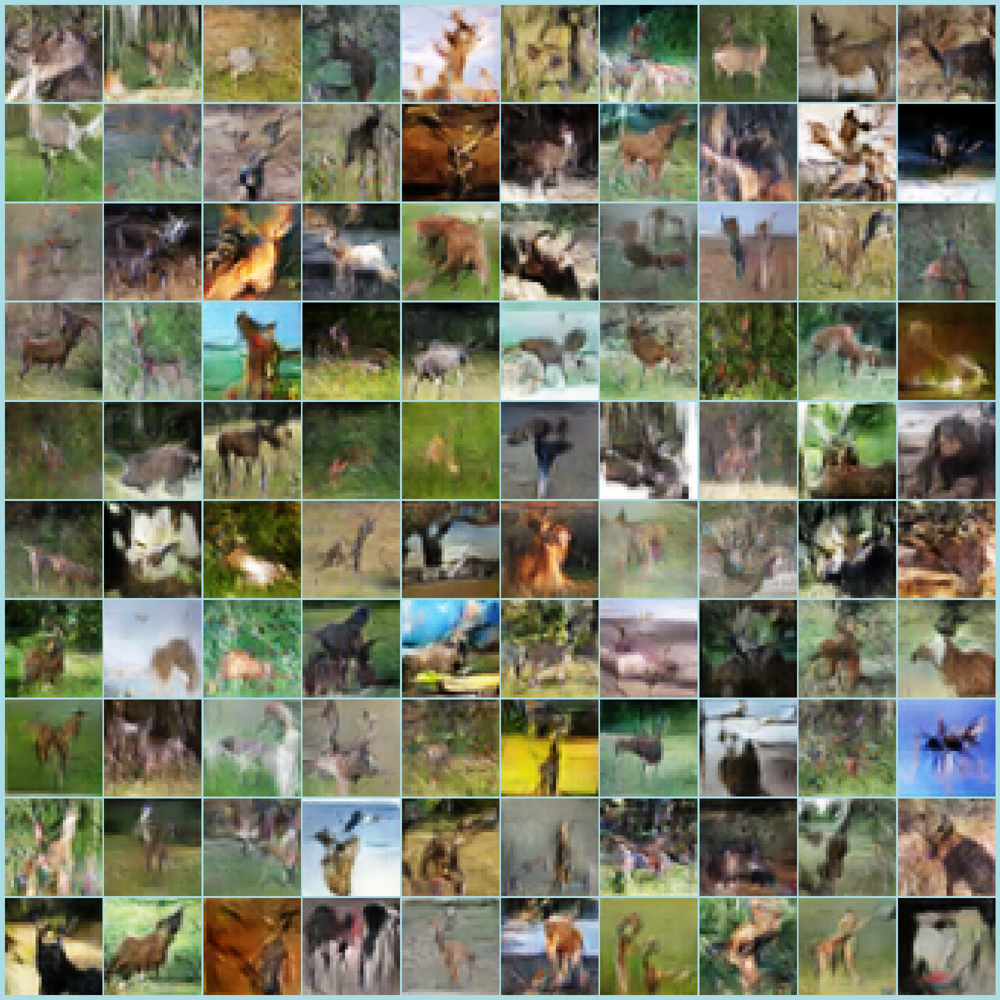

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


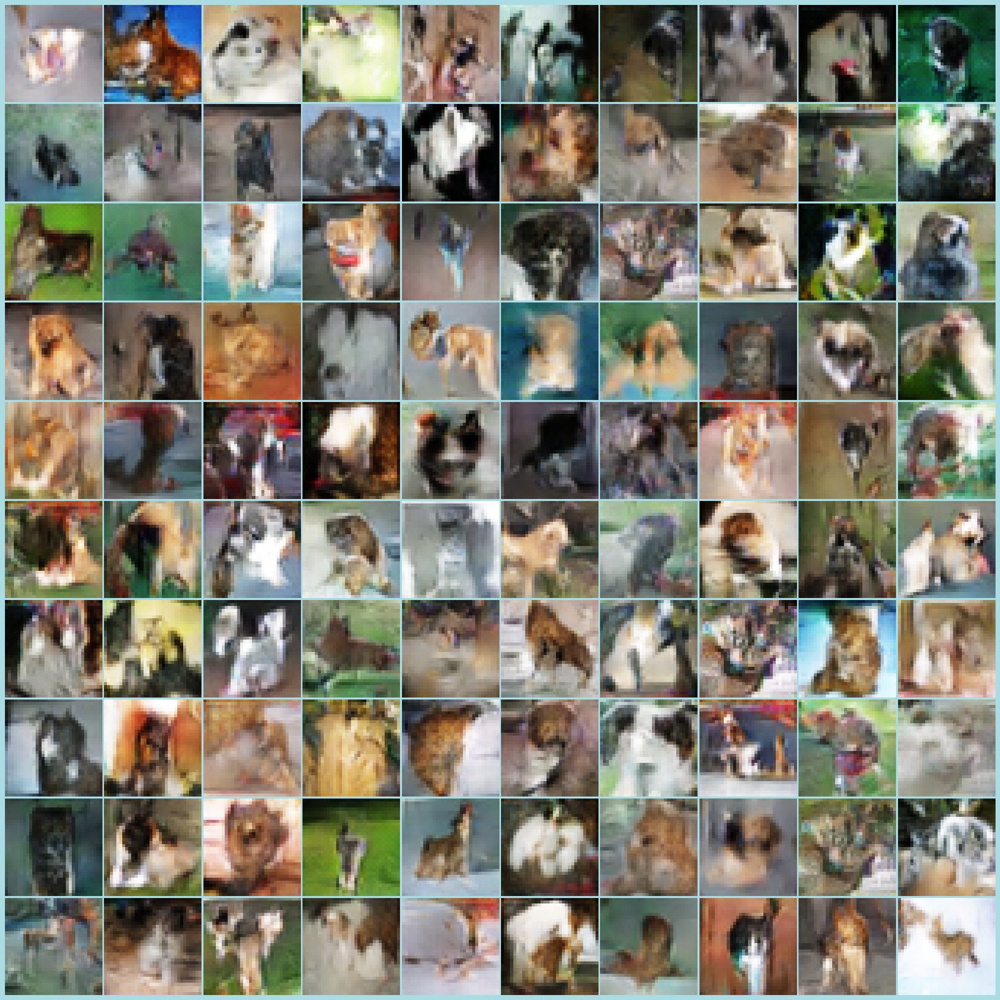

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


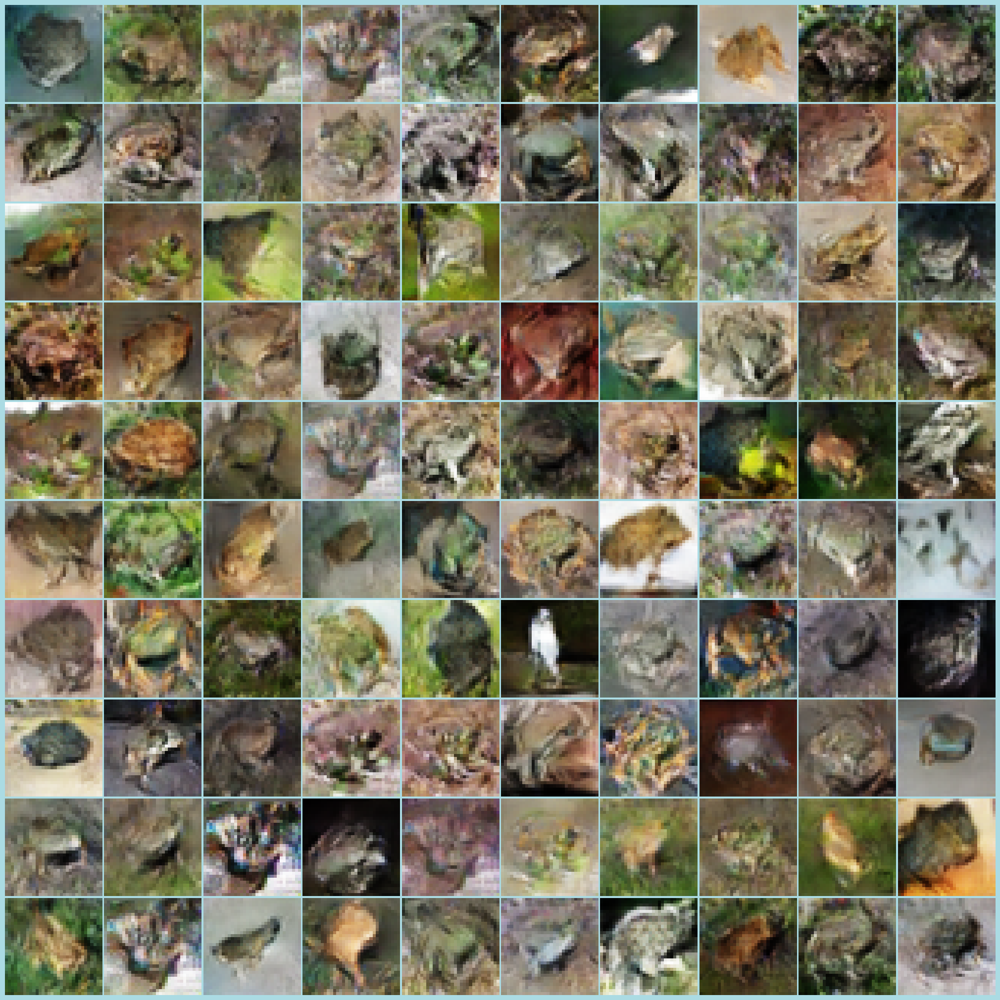

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


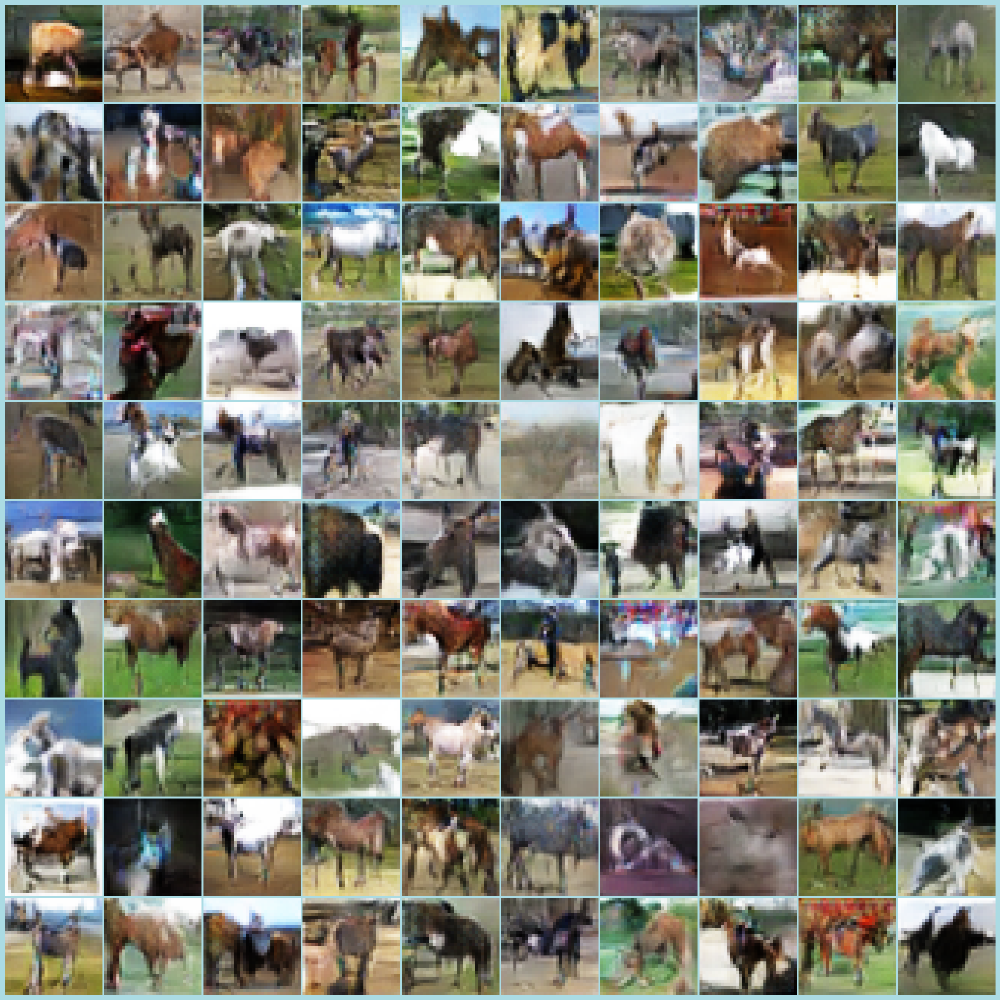

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


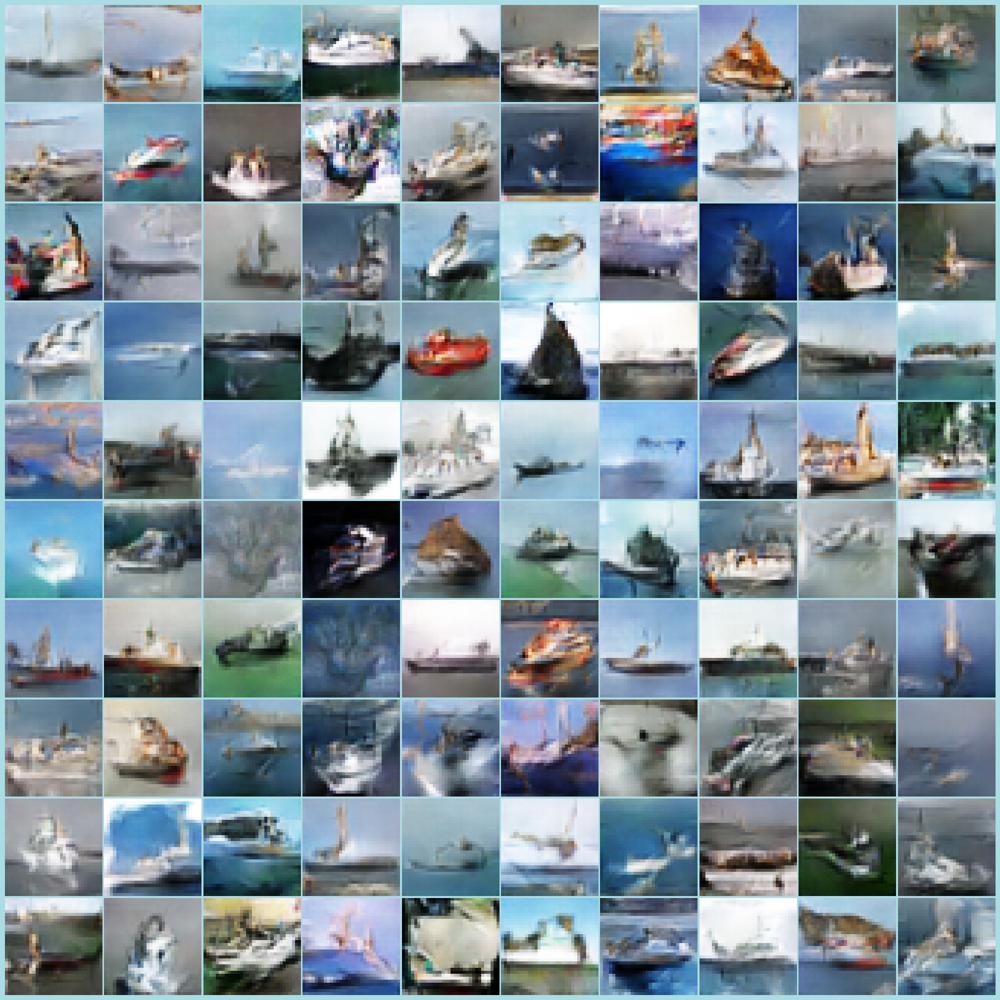

4/4 [==============================] - 0s 2ms/step
Class 9 - 100 Generated Images


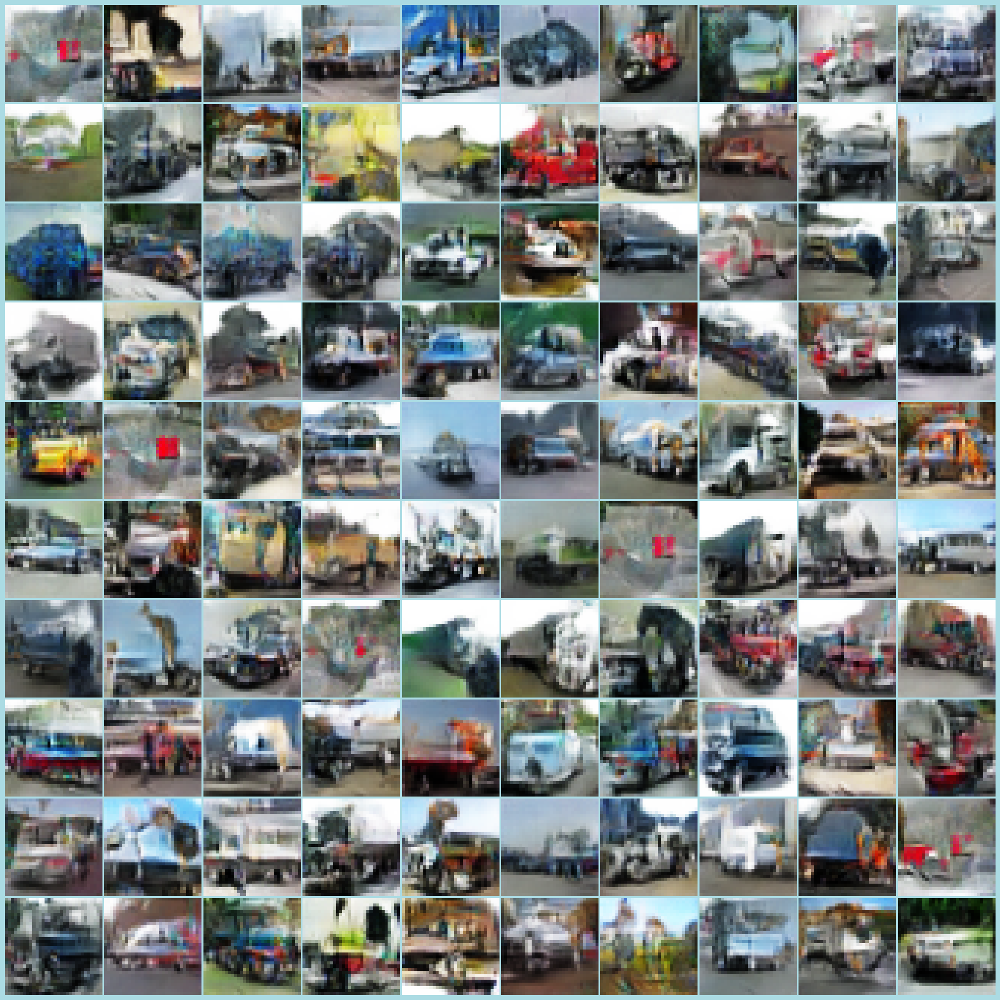

In [44]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images are pretty clear
</div>

#### Storing the scores

In [45]:
new_row = {'Model':'Sharpened Image CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,2.167156e-02,0.105153,6.727473
1,Sharpened Image CGAN 1,680924.469492,3.372896e+07,0.105472,6.766756


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Data Augmentation))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">



## __Key Ideas__

1. The idea of cutmix is to base on the labels mix two different images.
2. This helps with the discriminator such that the goal is to be able to learn more with less throguh this process
3. However, this could result in generated images being unrealistic with cutout portion



In [46]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
y_train = to_categorical(y_train)

In [47]:
class CGAN_CUTMIX(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(CGAN_CUTMIX, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.noise = latent_dim
        self.d_real_loss_metric = tf.keras.metrics.Mean(name="d_real_loss")
        self.d_fake_loss_metric = tf.keras.metrics.Mean(name="d_fake_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="g_loss")
        self.d_acc_metric = tf.keras.metrics.BinaryAccuracy(name="d_acc")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(CGAN_CUTMIX, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    def train_step(self, data):
        real_images, ohl = data
        batch_s = tf.shape(real_images)[0]
        lambda_value = tf.random.uniform([], 0, 1)
        bx1, by1, b_h, b_w = get_box(lambda_value)

        mask = tf.concat([
            tf.zeros((b_h, bx1, 3)), 
            tf.ones((b_h, b_w, 3)), 
            tf.zeros((b_h, 32 - bx1 - b_w, 3))
        ], axis=1)
        mask = tf.concat([
            tf.zeros((by1, 32, 3)),
            mask,
            tf.zeros((32 - by1 - b_h, 32, 3))
        ], axis=0)
        idx = tf.random.shuffle(tf.range(batch_s))
        real_images_mixed_part = tf.gather(real_images, idx)

        real_images = real_images * (1 - mask) + real_images_mixed_part * mask
        real_labels = tf.zeros((batch_s, 1))  

        # Generate the noise and iamges
        latent_noise_vector = tf.random.normal(shape=(batch_s, self.noise))
        generated_images = self.generator([latent_noise_vector, ohl])
        combined_images = tf.concat([generated_images, real_images], axis=0)
        combined_condition = tf.concat([ohl, ohl], axis=0)
        labels = tf.concat(
            [tf.zeros((batch_s, 1)), tf.ones((batch_s, 1))], axis=0
        )

        # Training the discriminator
        with tf.GradientTape() as tape:
            first_predictions = self.discriminator(
                [combined_images, combined_condition])
            d_loss = self.loss_fn(labels, first_predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )
        
        # Training the discriminator
        latent_noise_vector = tf.random.normal(shape=(batch_s, self.noise))

        misleading_labels = tf.ones((batch_s, 1))

        with tf.GradientTape() as tape:
            fake_images = self.generator([latent_noise_vector, ohl])
            second_predictions = self.discriminator([fake_images, ohl])
            g_loss = self.loss_fn(misleading_labels, second_predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(
            zip(grads, self.generator.trainable_weights))

        self.d_real_loss_metric.update_state(d_loss)
        self.d_fake_loss_metric.update_state(d_loss) 
        self.g_loss_metric.update_state(g_loss)
        self.d_acc_metric.update_state(labels, first_predictions)  

        return {
            "d_real_loss": self.d_real_loss_metric.result(),
            "d_fake_loss": self.d_fake_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
            "d_acc": self.d_acc_metric.result(),
            "d_realO": tf.reduce_mean(first_predictions[:batch_s]), 
            "d_fakeO": tf.reduce_mean(first_predictions[batch_s:])   
        }


#### Creating Checkpoint

In [48]:
callbacks = [CGANImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='CutMix CGAN-1')]

In [49]:
def preprocess_data(image, label):
    return image, label

def sample_beta_distribution(size, concentration_0=300, concentration_1=0.1):
    gamma_1_sample = tf.random.gamma(shape=[size], alpha=concentration_1)
    gamma_2_sample = tf.random.gamma(shape=[size], alpha=concentration_0)
    return gamma_1_sample / (gamma_1_sample + gamma_2_sample)

@tf.function
def get_box(lambda_value):
    cut_rat = tf.math.sqrt(1.0 - lambda_value) * 0.5
    image_wh = 32  
    cut_wh = image_wh * cut_rat
    cut_wh = tf.cast(cut_wh, tf.int32)

    cut_x = tf.random.uniform((1,), minval=0, maxval=image_wh, dtype=tf.int32)
    cut_y = tf.random.uniform((1,), minval=0, maxval=image_wh, dtype=tf.int32)

    boundaryx1 = tf.clip_by_value(cut_x[0] - cut_wh // 2, 0, image_wh)
    boundaryy1 = tf.clip_by_value(cut_y[0] - cut_wh // 2, 0, image_wh)
    bbx2 = tf.clip_by_value(cut_x[0] + cut_wh // 2, 0, image_wh)
    bby2 = tf.clip_by_value(cut_y[0] + cut_wh // 2, 0, image_wh)

    target_h = bby2 - boundaryy1
    target_w = bbx2 - boundaryx1
    return boundaryx1, boundaryy1, target_h, target_w

@tf.function
def cutmix(train_ds_one, train_ds_two):
    (image1, label1), (image2, label2) = train_ds_one, train_ds_two
    label1 = tf.cast(label1, tf.float32)
    label2 = tf.cast(label2, tf.float32)

    image_size = 32  # CIFAR-10 image size
    alpha = [0.3]
    beta = [0.3]
    lambda_value = sample_beta_distribution(1, alpha, beta)
    lambda_value = lambda_value[0][0]
    boundaryx1, boundaryy1, target_h, target_w = get_box(lambda_value)

    target_w = tf.maximum(1, target_w)
    target_h = tf.maximum(1, target_h)

    crop2 = tf.image.crop_to_bounding_box(image2, boundaryy1, boundaryx1, target_h, target_w)
    crop2 = tf.image.pad_to_bounding_box(crop2, boundaryy1, boundaryx1, image_size, image_size)

    crop1 = tf.image.crop_to_bounding_box(image1, boundaryy1, boundaryx1, target_h, target_w)
    crop1 = tf.image.pad_to_bounding_box(crop1, boundaryy1, boundaryx1, image_size, image_size)

    image1 = image1 - crop1
    image = image1 + crop2
    lambda_value = 1 - (target_w * target_h) / (image_size * image_size)
    lambda_value = tf.cast(lambda_value, tf.float32)

    label = lambda_value * label1 + (1 - lambda_value) * label2
    return image, label



In [50]:
train_ds_one = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(2048).map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)
train_ds_two = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(2048).map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)

train_ds_cutmix = tf.data.Dataset.zip((train_ds_one, train_ds_two))
train_ds_cutmix = (
    train_ds_cutmix.shuffle(1024)
    .map(cutmix, num_parallel_calls=tf.data.AUTOTUNE)
    .batch(128)
    .prefetch(tf.data.AUTOTUNE)
)
x_train_cutmix = []
for x_batch, _ in train_ds_cutmix:
    x_train_cutmix.extend(x_batch.numpy()) 
x_train_cutmix = np.array(x_train_cutmix)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


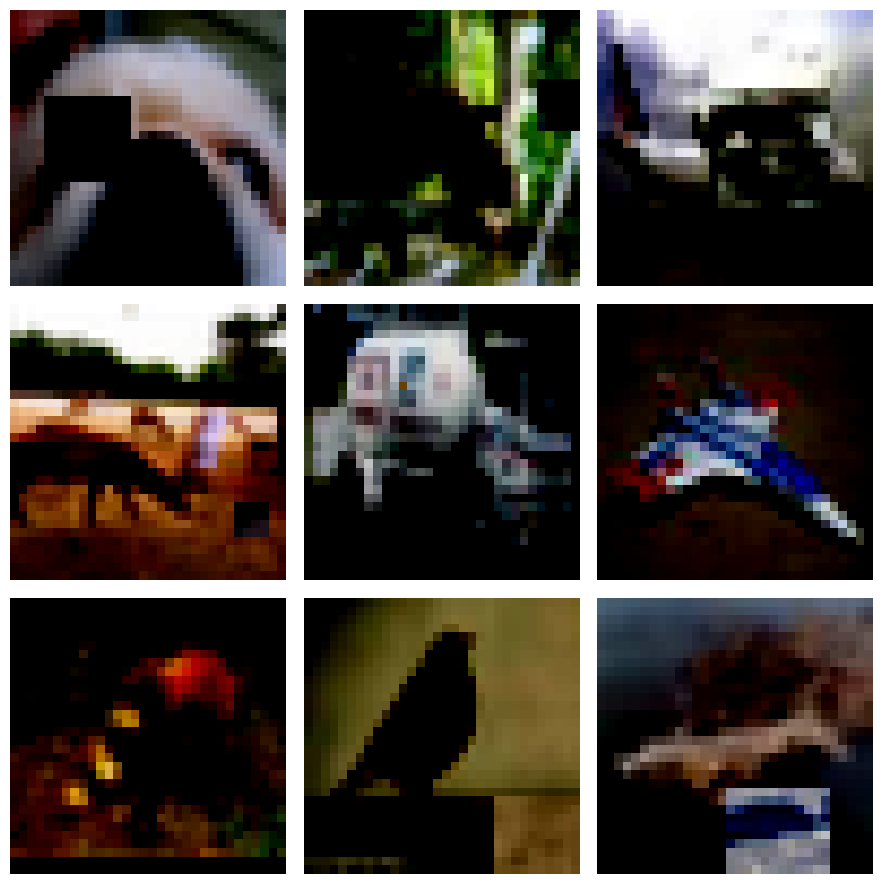

In [51]:
x_train_cutmix = np.array(x_train_cutmix)
num_images_to_show = 9
images_to_show = x_train_cutmix[:num_images_to_show]
fig, axes = plt.subplots(3, 3, figsize=(9, 9))  
axes = axes.flatten()

for img, ax in zip(images_to_show, axes):
    ax.imshow(img)
    ax.axis('off') 

plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- cutmix can be seen in the images

</div>

In [52]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

In [53]:
dataset = tf.data.Dataset.from_tensor_slices((x_train_cutmix,y_train))
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

Epoch 1/100
782/782 [==============================] - ETA: 0s - d_real_loss: 0.2624 - d_fake_loss: 0.2624 - g_loss: 3.7446 - d_acc: 0.9123 - d_realO: 0.1538 - d_fakeO: 0.8616

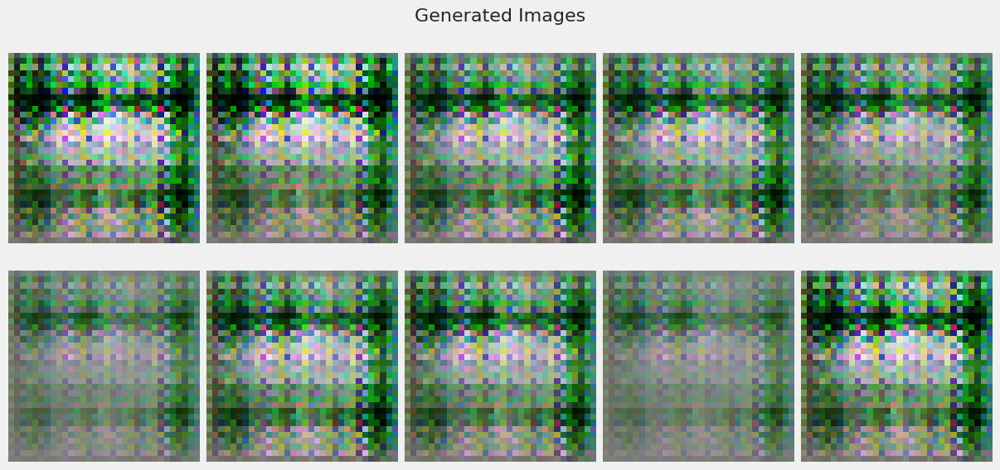

782/782 [==============================] - 11s 12ms/step - d_real_loss: 0.2624 - d_fake_loss: 0.2624 - g_loss: 3.7446 - d_acc: 0.9123 - d_realO: 0.1538 - d_fakeO: 0.8616
Epoch 2/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2509 - d_fake_loss: 0.2509 - g_loss: 3.5476 - d_acc: 0.9167 - d_realO: 0.1413 - d_fakeO: 0.8541
Epoch 3/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2225 - d_fake_loss: 0.2225 - g_loss: 3.6338 - d_acc: 0.9267 - d_realO: 0.1206 - d_fakeO: 0.8750
Epoch 4/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1971 - d_fake_loss: 0.1971 - g_loss: 3.7705 - d_acc: 0.9358 - d_realO: 0.1051 - d_fakeO: 0.8896
Epoch 5/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2247 - d_fake_loss: 0.2247 - g_loss: 3.3853 - d_acc: 0.9228 - d_realO: 0.1286 - d_fakeO: 0.8700
Epoch 6/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2795 - d_fake_loss: 0

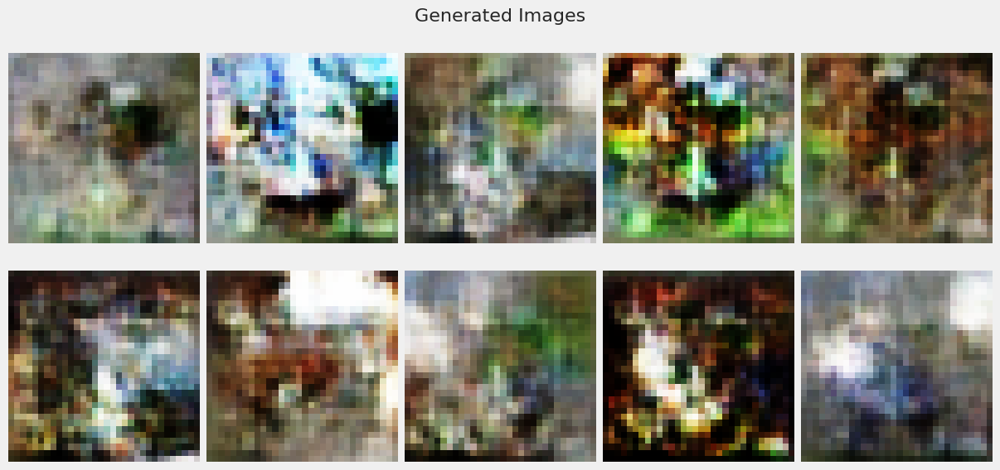

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.2726 - d_fake_loss: 0.2726 - g_loss: 2.8516 - d_acc: 0.8907 - d_realO: 0.1675 - d_fakeO: 0.8338
Epoch 12/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2502 - d_fake_loss: 0.2502 - g_loss: 3.0747 - d_acc: 0.9003 - d_realO: 0.1508 - d_fakeO: 0.8485
Epoch 13/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2446 - d_fake_loss: 0.2446 - g_loss: 3.0712 - d_acc: 0.9015 - d_realO: 0.1499 - d_fakeO: 0.8519
Epoch 14/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2347 - d_fake_loss: 0.2347 - g_loss: 3.1855 - d_acc: 0.9067 - d_realO: 0.1407 - d_fakeO: 0.8590
Epoch 15/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2188 - d_fake_loss: 0.2188 - g_loss: 3.3242 - d_acc: 0.9138 - d_realO: 0.1307 - d_fakeO: 0.8696
Epoch 16/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2178 - d_fake_lo

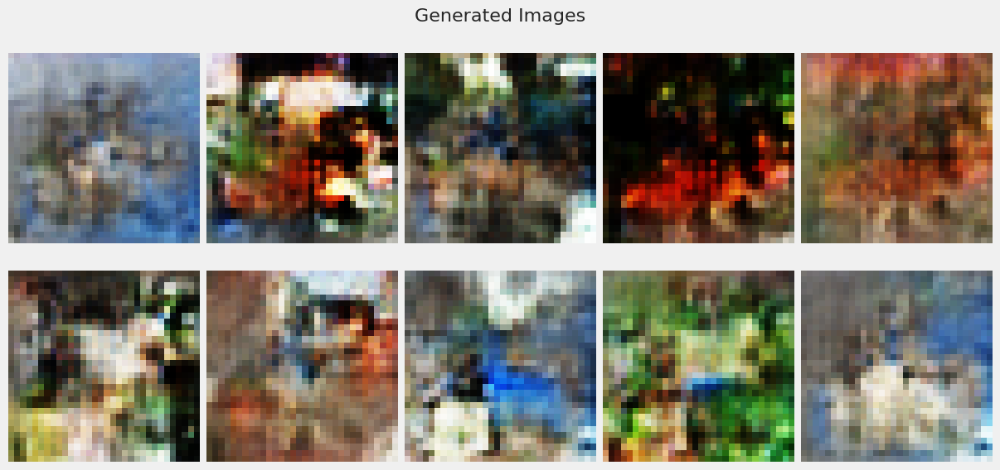

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1831 - d_fake_loss: 0.1831 - g_loss: 3.7568 - d_acc: 0.9309 - d_realO: 0.1053 - d_fakeO: 0.8950
Epoch 22/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1715 - d_fake_loss: 0.1715 - g_loss: 3.7838 - d_acc: 0.9363 - d_realO: 0.1000 - d_fakeO: 0.9010
Epoch 23/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1573 - d_fake_loss: 0.1573 - g_loss: 3.9539 - d_acc: 0.9416 - d_realO: 0.0912 - d_fakeO: 0.9096
Epoch 24/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1694 - d_fake_loss: 0.1694 - g_loss: 3.8289 - d_acc: 0.9376 - d_realO: 0.0958 - d_fakeO: 0.9045
Epoch 25/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1530 - d_fake_loss: 0.1530 - g_loss: 3.9654 - d_acc: 0.9428 - d_realO: 0.0895 - d_fakeO: 0.9115
Epoch 26/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1489 - d_fake_los

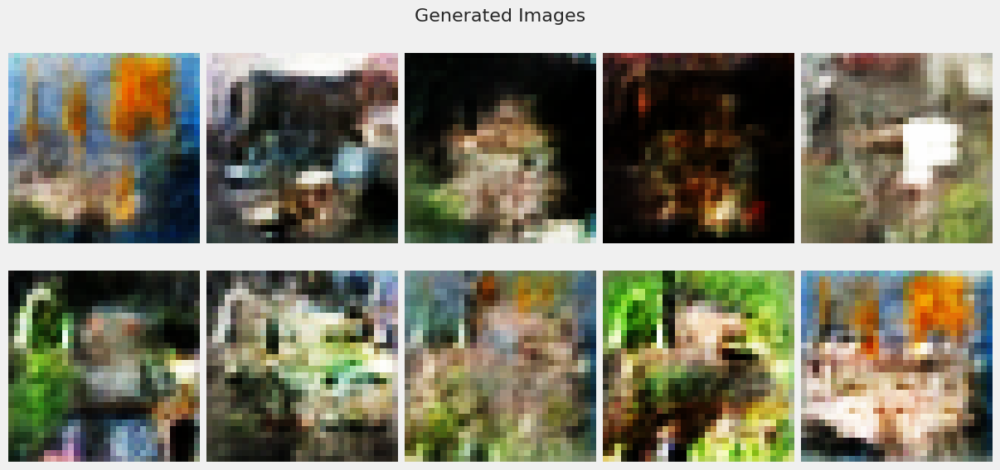

782/782 [==============================] - 10s 13ms/step - d_real_loss: 0.1416 - d_fake_loss: 0.1416 - g_loss: 4.0709 - d_acc: 0.9485 - d_realO: 0.0815 - d_fakeO: 0.9188
Epoch 32/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1386 - d_fake_loss: 0.1386 - g_loss: 4.0386 - d_acc: 0.9496 - d_realO: 0.0790 - d_fakeO: 0.9225
Epoch 33/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1523 - d_fake_loss: 0.1523 - g_loss: 3.9400 - d_acc: 0.9435 - d_realO: 0.0865 - d_fakeO: 0.9138
Epoch 34/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1489 - d_fake_loss: 0.1489 - g_loss: 3.9325 - d_acc: 0.9454 - d_realO: 0.0851 - d_fakeO: 0.9153
Epoch 35/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1473 - d_fake_loss: 0.1473 - g_loss: 4.0151 - d_acc: 0.9456 - d_realO: 0.0839 - d_fakeO: 0.9165
Epoch 36/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1382 - d_fake_lo

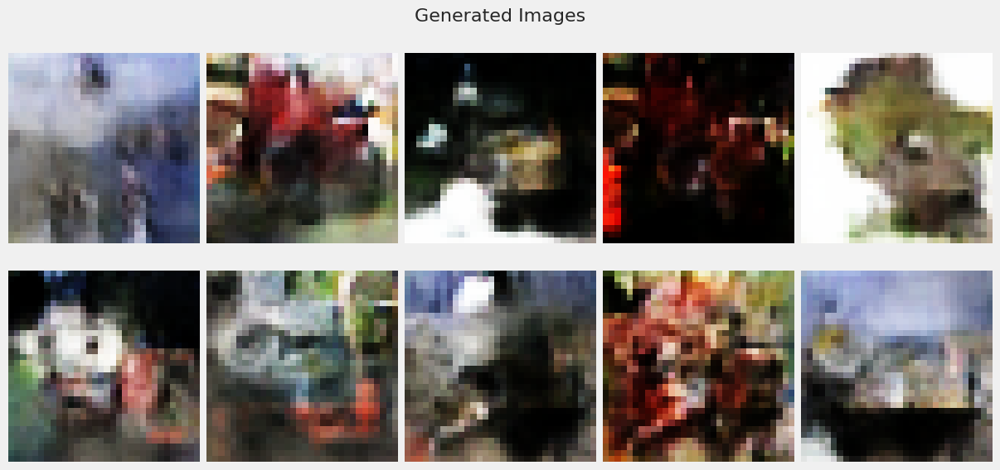

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.1261 - d_fake_loss: 0.1261 - g_loss: 4.2685 - d_acc: 0.9545 - d_realO: 0.0716 - d_fakeO: 0.9288
Epoch 42/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1317 - d_fake_loss: 0.1317 - g_loss: 4.1604 - d_acc: 0.9521 - d_realO: 0.0747 - d_fakeO: 0.9254
Epoch 43/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1277 - d_fake_loss: 0.1277 - g_loss: 4.2248 - d_acc: 0.9538 - d_realO: 0.0718 - d_fakeO: 0.9287
Epoch 44/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1304 - d_fake_loss: 0.1304 - g_loss: 4.1055 - d_acc: 0.9526 - d_realO: 0.0740 - d_fakeO: 0.9265
Epoch 45/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1258 - d_fake_loss: 0.1258 - g_loss: 4.1923 - d_acc: 0.9540 - d_realO: 0.0714 - d_fakeO: 0.9291
Epoch 46/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1335 - d_fake_lo

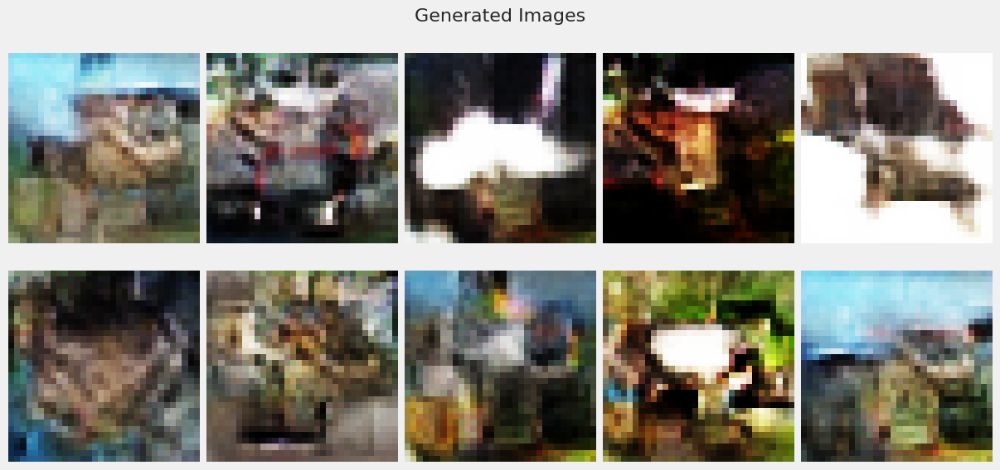

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.1286 - d_fake_loss: 0.1286 - g_loss: 4.1335 - d_acc: 0.9526 - d_realO: 0.0735 - d_fakeO: 0.9273
Epoch 52/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1338 - d_fake_loss: 0.1338 - g_loss: 4.0428 - d_acc: 0.9510 - d_realO: 0.0760 - d_fakeO: 0.9242
Epoch 53/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1334 - d_fake_loss: 0.1334 - g_loss: 4.1508 - d_acc: 0.9512 - d_realO: 0.0753 - d_fakeO: 0.9248
Epoch 54/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1355 - d_fake_loss: 0.1355 - g_loss: 4.1524 - d_acc: 0.9498 - d_realO: 0.0769 - d_fakeO: 0.9231
Epoch 55/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1244 - d_fake_loss: 0.1244 - g_loss: 4.2668 - d_acc: 0.9552 - d_realO: 0.0707 - d_fakeO: 0.9299
Epoch 56/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1123 - d_fake_lo

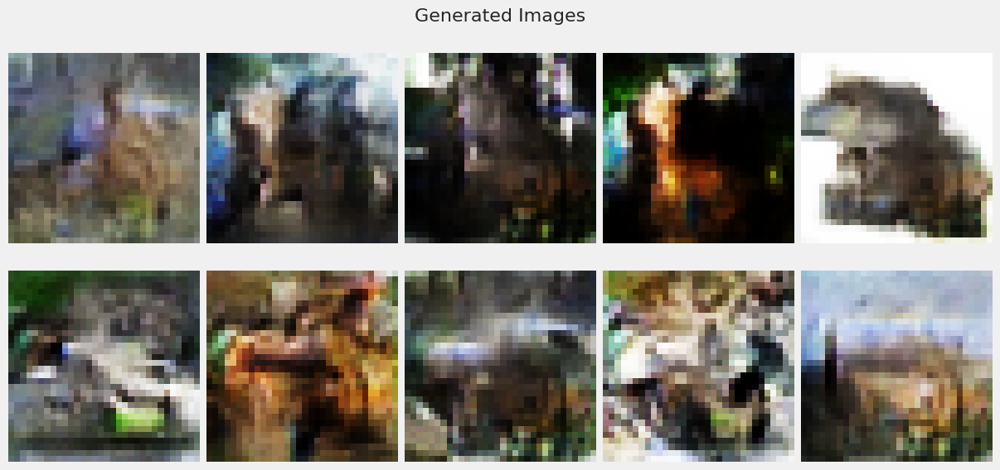

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1148 - d_fake_loss: 0.1148 - g_loss: 4.3732 - d_acc: 0.9587 - d_realO: 0.0653 - d_fakeO: 0.9352
Epoch 62/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1141 - d_fake_loss: 0.1141 - g_loss: 4.4796 - d_acc: 0.9586 - d_realO: 0.0649 - d_fakeO: 0.9360
Epoch 63/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1141 - d_fake_loss: 0.1141 - g_loss: 4.5101 - d_acc: 0.9586 - d_realO: 0.0646 - d_fakeO: 0.9355
Epoch 64/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1200 - d_fake_loss: 0.1200 - g_loss: 4.4057 - d_acc: 0.9568 - d_realO: 0.0678 - d_fakeO: 0.9327
Epoch 65/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1165 - d_fake_loss: 0.1165 - g_loss: 4.4118 - d_acc: 0.9590 - d_realO: 0.0646 - d_fakeO: 0.9357
Epoch 66/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1032 - d_fake_los

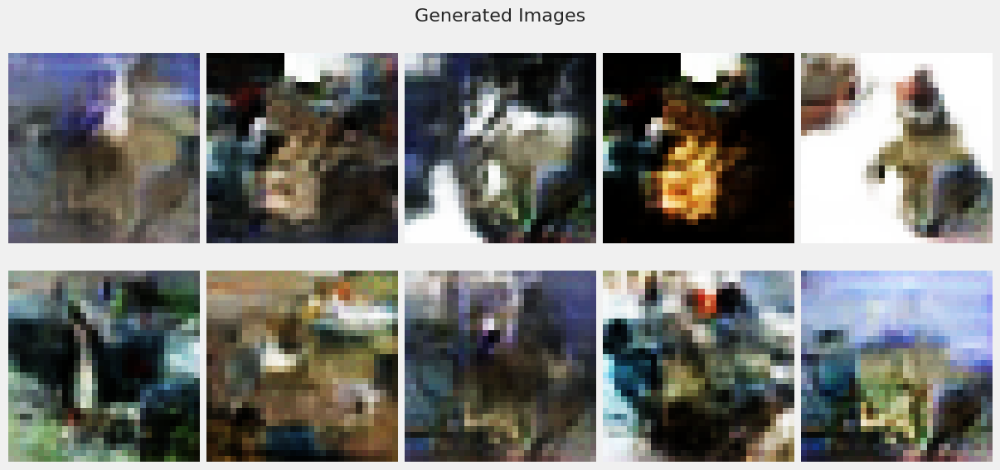

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1197 - d_fake_loss: 0.1197 - g_loss: 4.3014 - d_acc: 0.9574 - d_realO: 0.0677 - d_fakeO: 0.9327
Epoch 72/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1194 - d_fake_loss: 0.1194 - g_loss: 4.2575 - d_acc: 0.9573 - d_realO: 0.0665 - d_fakeO: 0.9339
Epoch 73/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1166 - d_fake_loss: 0.1166 - g_loss: 4.3536 - d_acc: 0.9575 - d_realO: 0.0660 - d_fakeO: 0.9346
Epoch 74/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1183 - d_fake_loss: 0.1183 - g_loss: 4.3523 - d_acc: 0.9575 - d_realO: 0.0670 - d_fakeO: 0.9336
Epoch 75/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1088 - d_fake_loss: 0.1088 - g_loss: 4.6173 - d_acc: 0.9608 - d_realO: 0.0604 - d_fakeO: 0.9397
Epoch 76/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1073 - d_fake_los

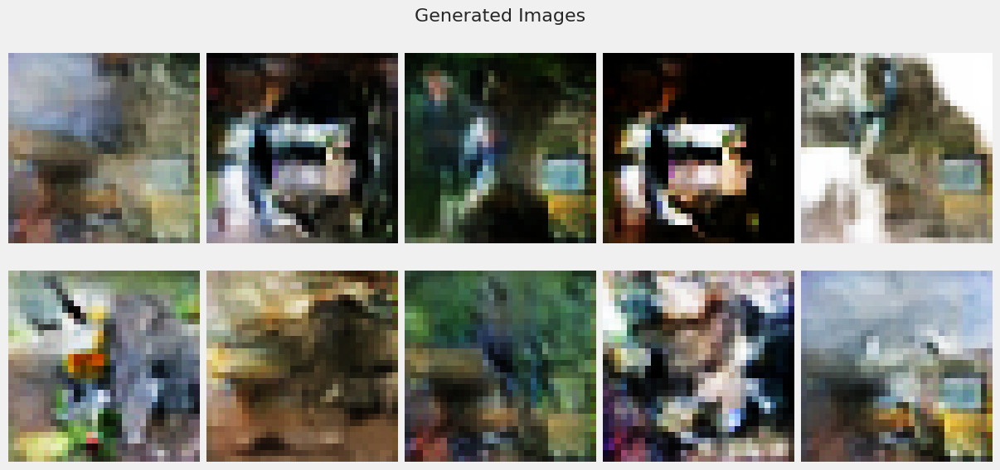

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.1083 - d_fake_loss: 0.1083 - g_loss: 4.5527 - d_acc: 0.9612 - d_realO: 0.0608 - d_fakeO: 0.9394
Epoch 82/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1041 - d_fake_loss: 0.1041 - g_loss: 4.6217 - d_acc: 0.9630 - d_realO: 0.0585 - d_fakeO: 0.9426
Epoch 83/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1109 - d_fake_loss: 0.1109 - g_loss: 4.5503 - d_acc: 0.9594 - d_realO: 0.0626 - d_fakeO: 0.9377
Epoch 84/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1032 - d_fake_loss: 0.1032 - g_loss: 4.6971 - d_acc: 0.9628 - d_realO: 0.0581 - d_fakeO: 0.9427
Epoch 85/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1312 - d_fake_loss: 0.1312 - g_loss: 4.4653 - d_acc: 0.9535 - d_realO: 0.0704 - d_fakeO: 0.9284
Epoch 86/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1083 - d_fake_lo

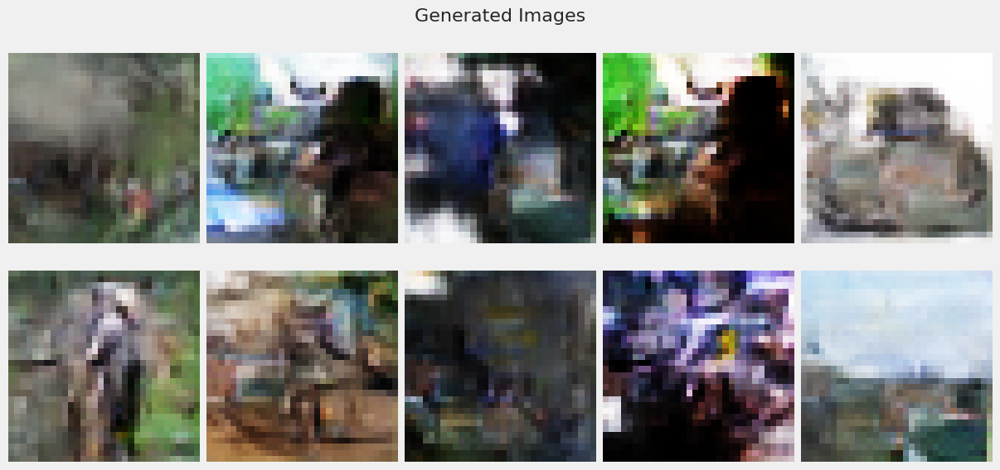

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.1044 - d_fake_loss: 0.1044 - g_loss: 4.7399 - d_acc: 0.9624 - d_realO: 0.0582 - d_fakeO: 0.9419
Epoch 92/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1062 - d_fake_loss: 0.1062 - g_loss: 4.6212 - d_acc: 0.9612 - d_realO: 0.0598 - d_fakeO: 0.9408
Epoch 93/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1131 - d_fake_loss: 0.1131 - g_loss: 4.5077 - d_acc: 0.9588 - d_realO: 0.0627 - d_fakeO: 0.9374
Epoch 94/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1126 - d_fake_loss: 0.1126 - g_loss: 4.4643 - d_acc: 0.9590 - d_realO: 0.0639 - d_fakeO: 0.9366
Epoch 95/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1042 - d_fake_loss: 0.1042 - g_loss: 4.6006 - d_acc: 0.9625 - d_realO: 0.0589 - d_fakeO: 0.9419
Epoch 96/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1074 - d_fake_lo

In [54]:
gan_4 = CGAN_CUTMIX(discriminator=discriminator_cgan1,generator=generator_cgan1,latent_dim=128)
gan_4.compile(d_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),g_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),loss_fn=tf.keras.losses.BinaryCrossentropy(),)
gan_history_4 = gan_4.fit(dataset,epochs=100,use_multiprocessing=True,workers=16,callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  96% accuracy
- No model collapse


</div>

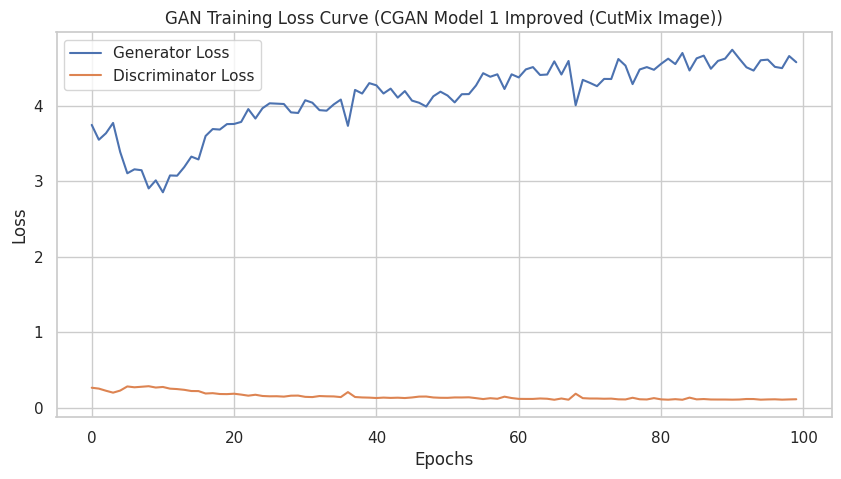

In [55]:
gan_history_4 = gan_4.history.history
generator = gan_4.generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (CGAN Model 1 Improved (CutMix Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase quickly


</div>

In [56]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 91.51945172192848
KID Score: 0.07159535642904702


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 91
- KID Score is 0.07
    
It may not be the best to use this metrics here
</div>

4/4 [==============================] - 0s 2ms/step
Class 0 - 100 Generated Images


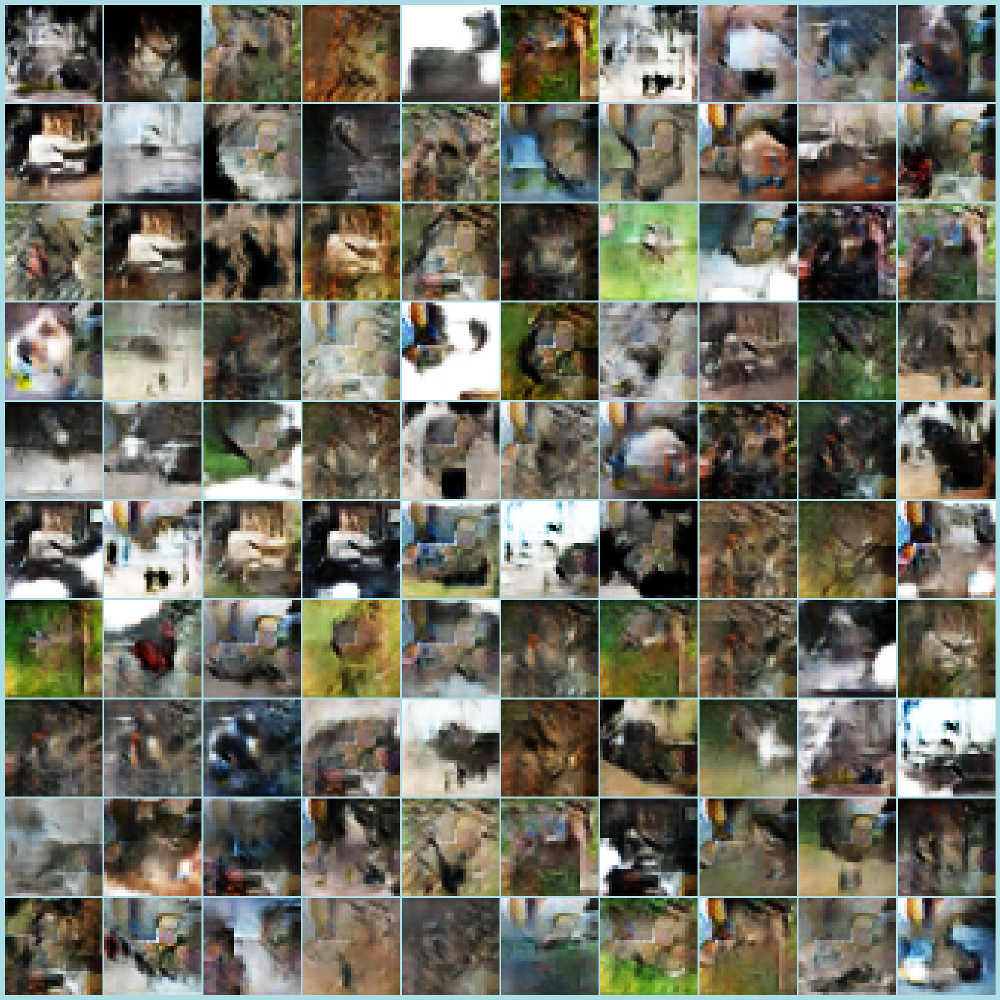

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


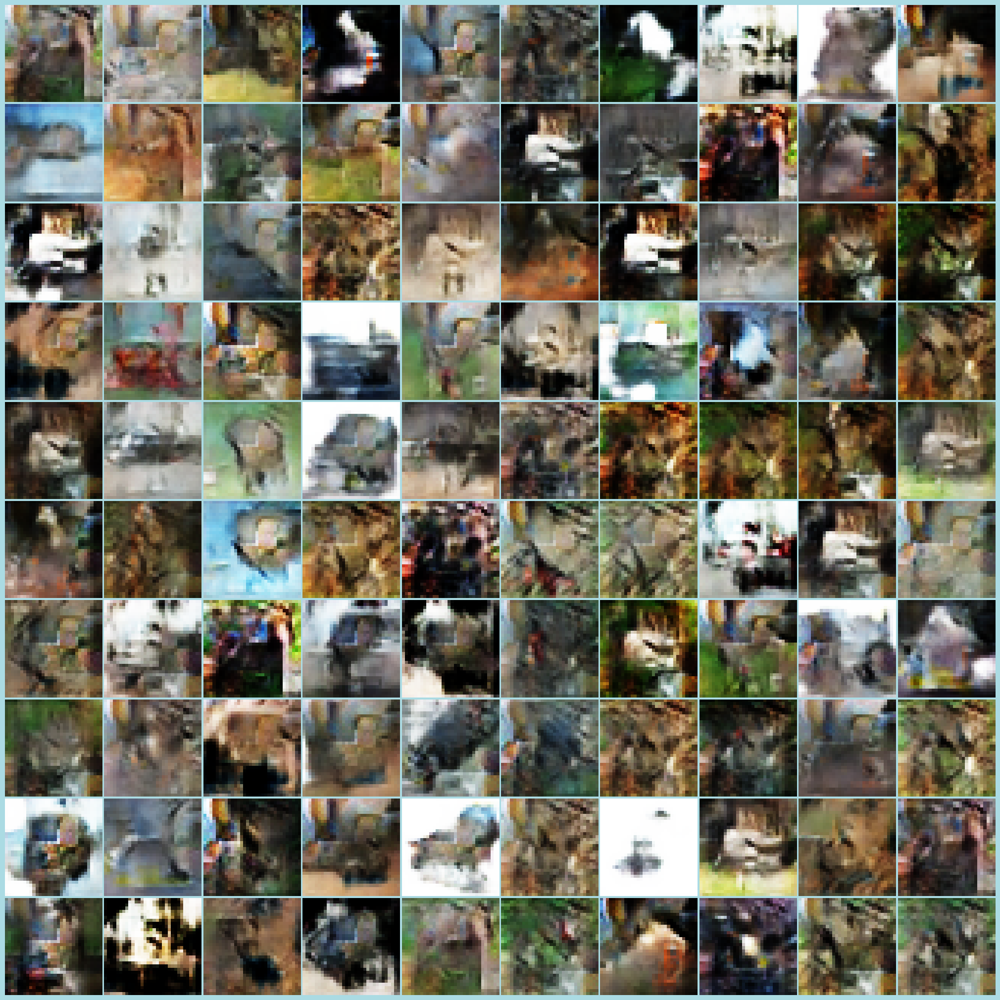

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


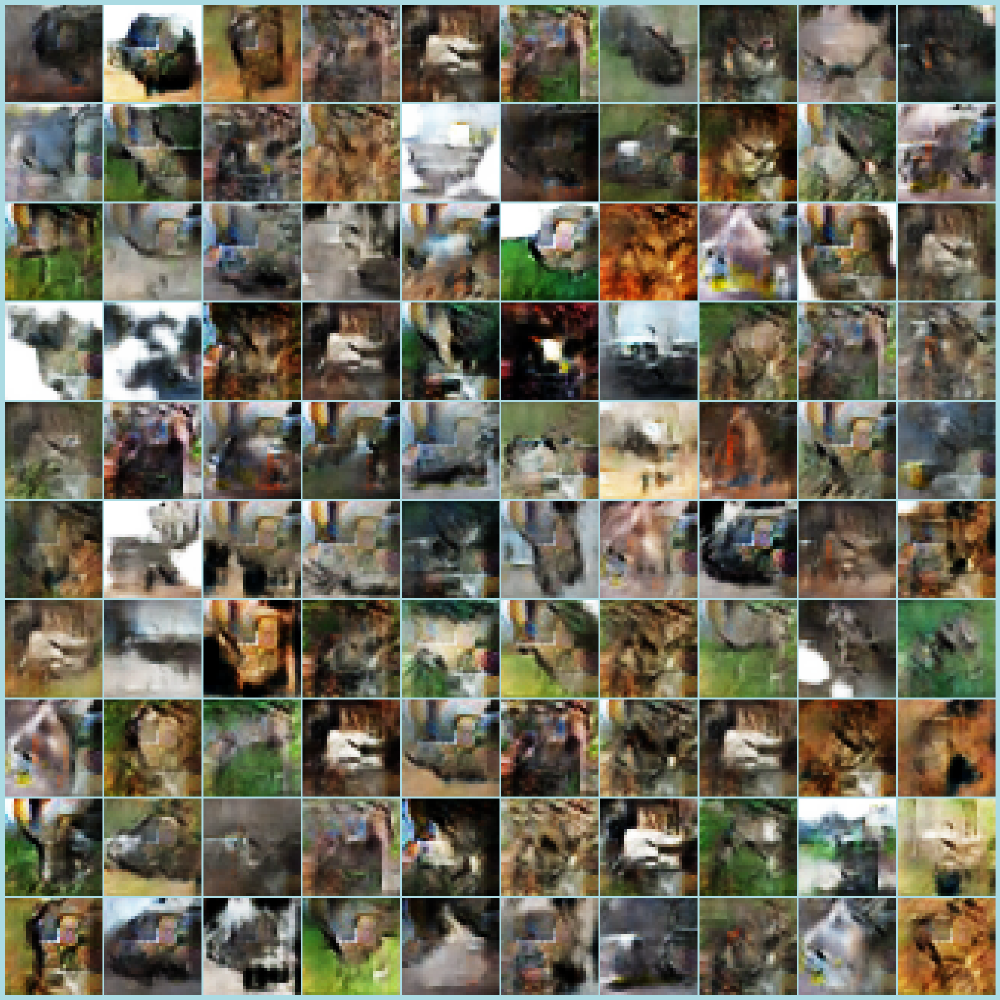

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


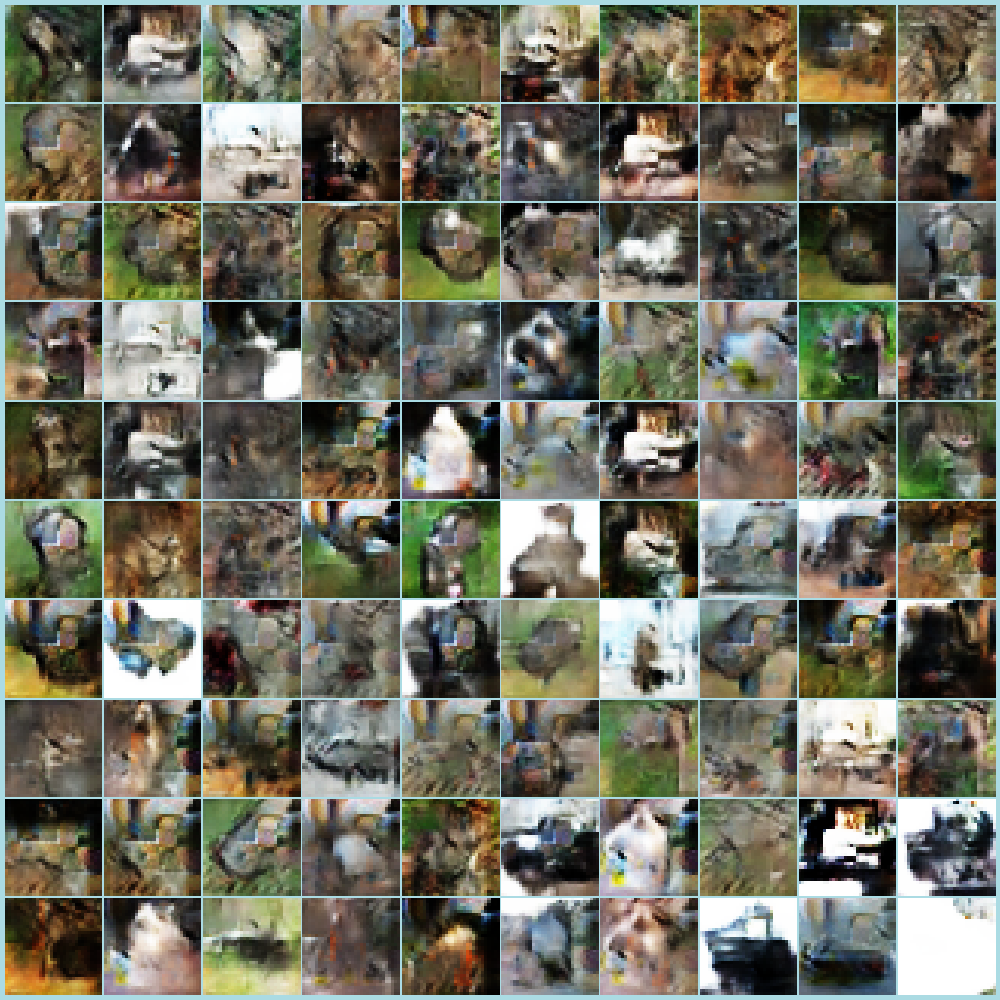

4/4 [==============================] - 0s 2ms/step
Class 4 - 100 Generated Images


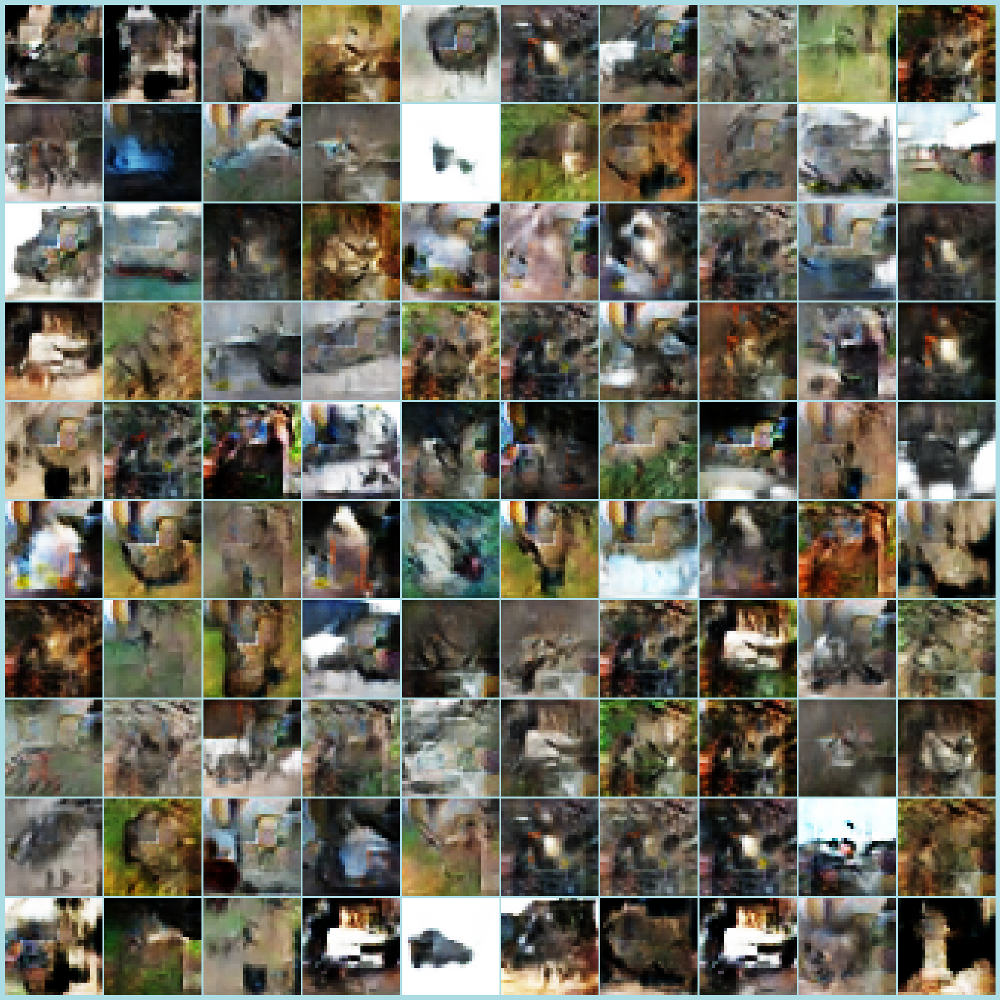

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


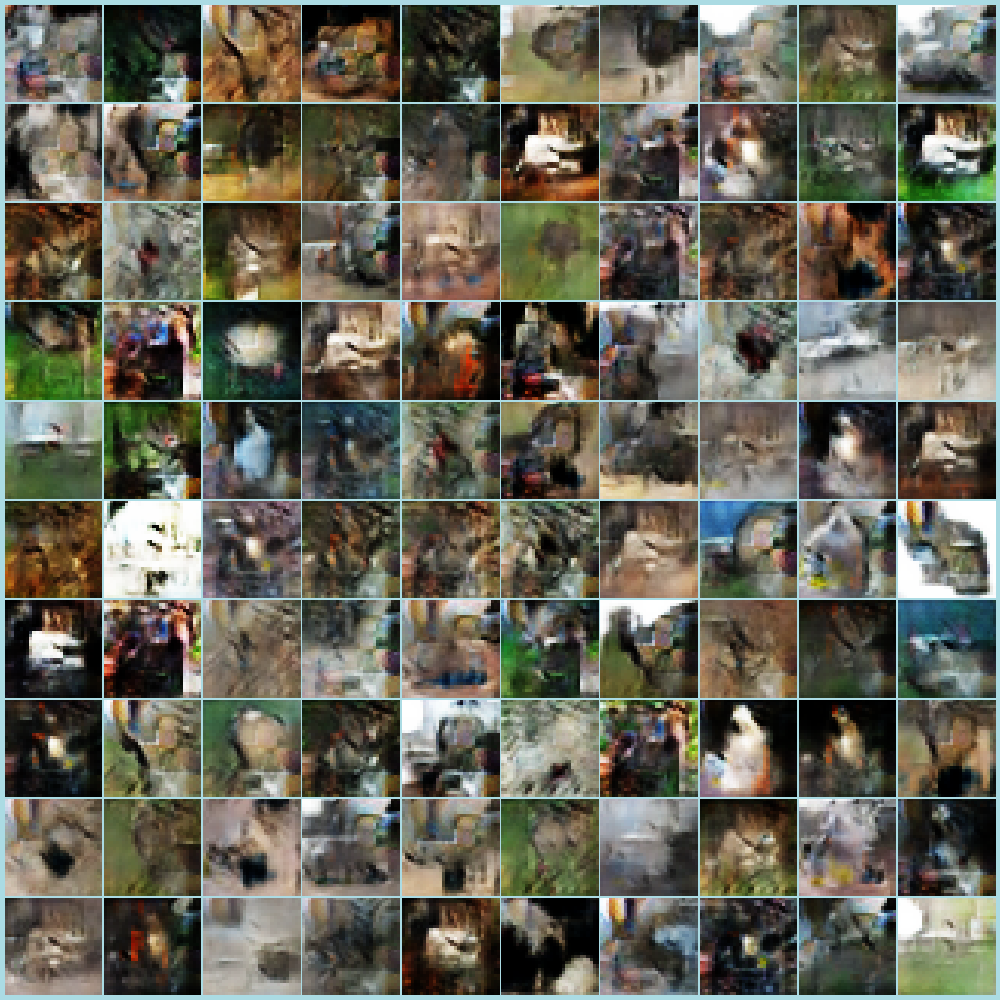

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


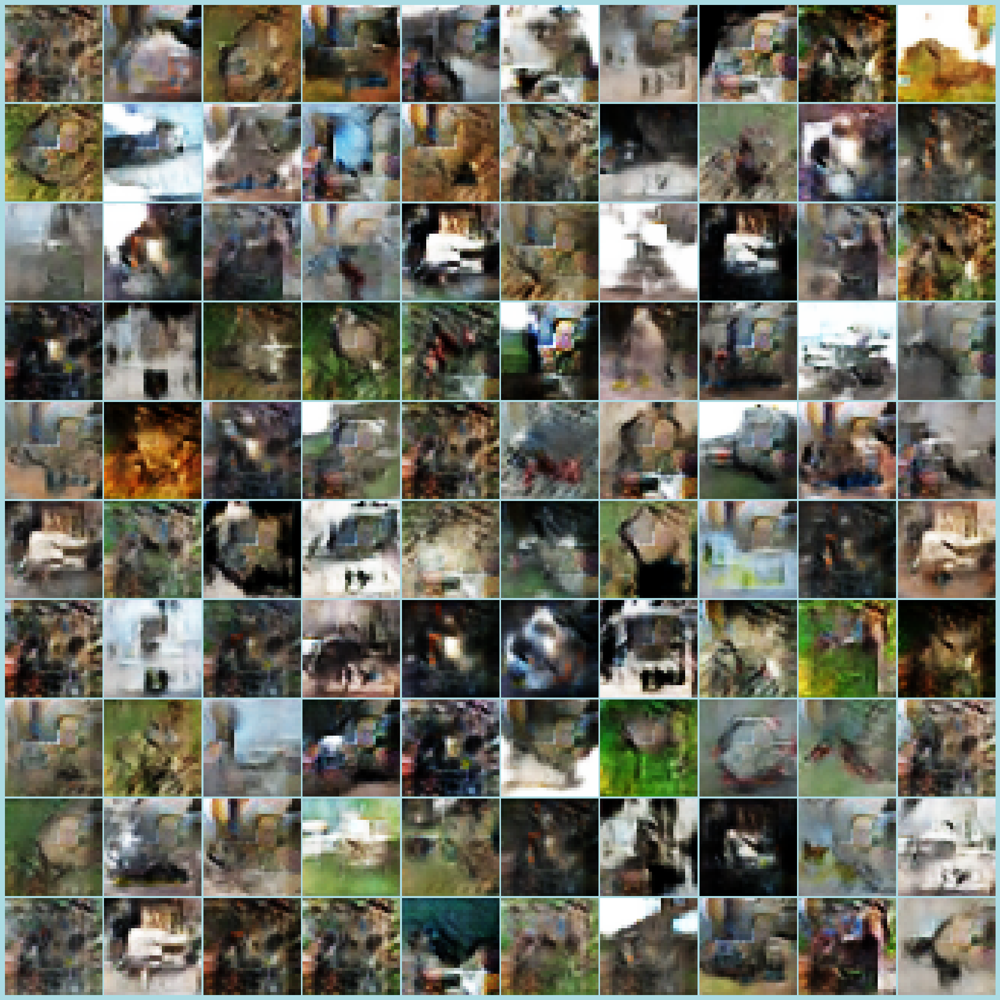

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


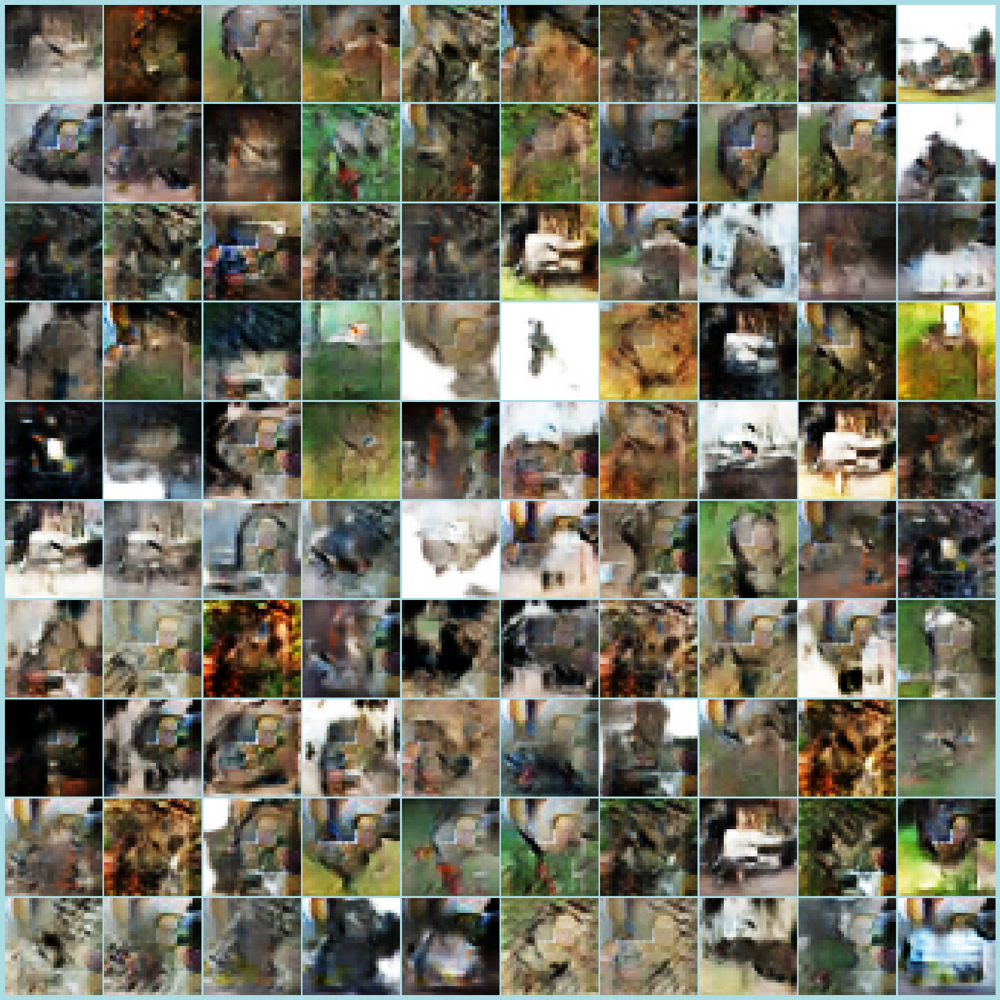

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


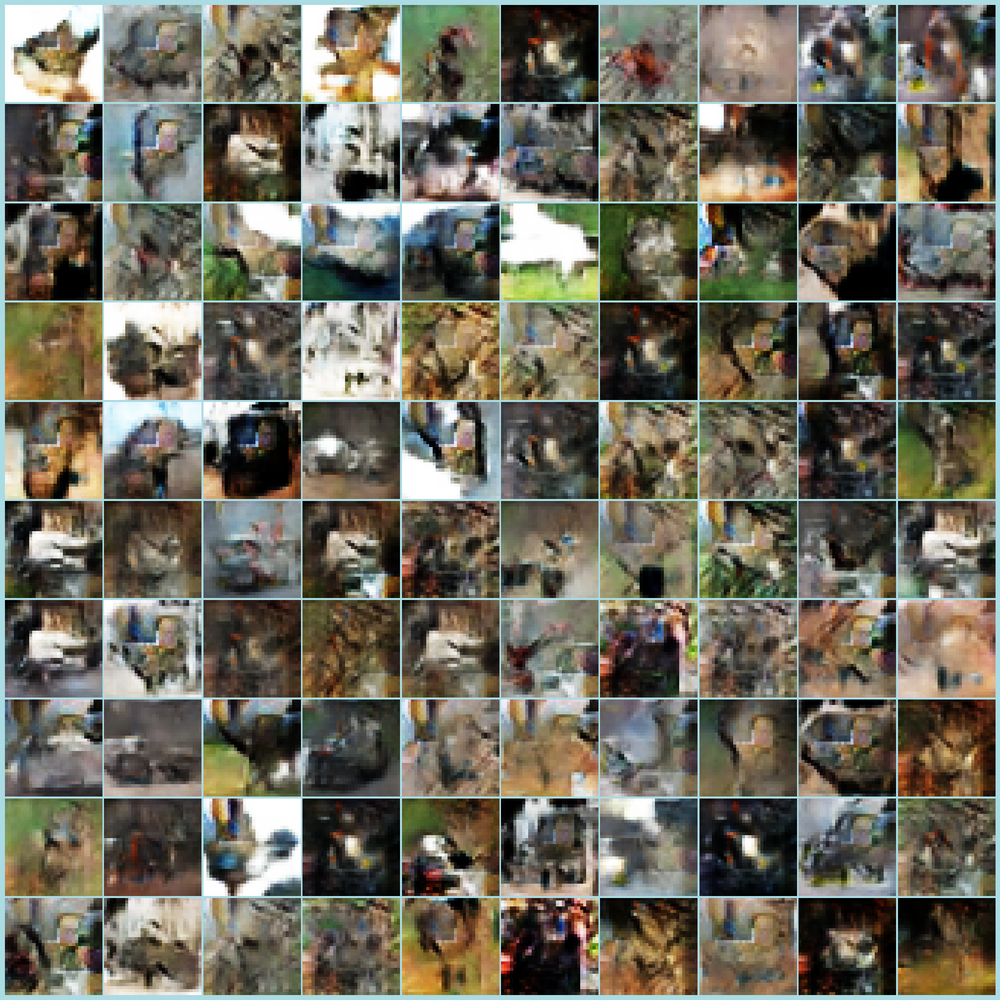

4/4 [==============================] - 0s 2ms/step
Class 9 - 100 Generated Images


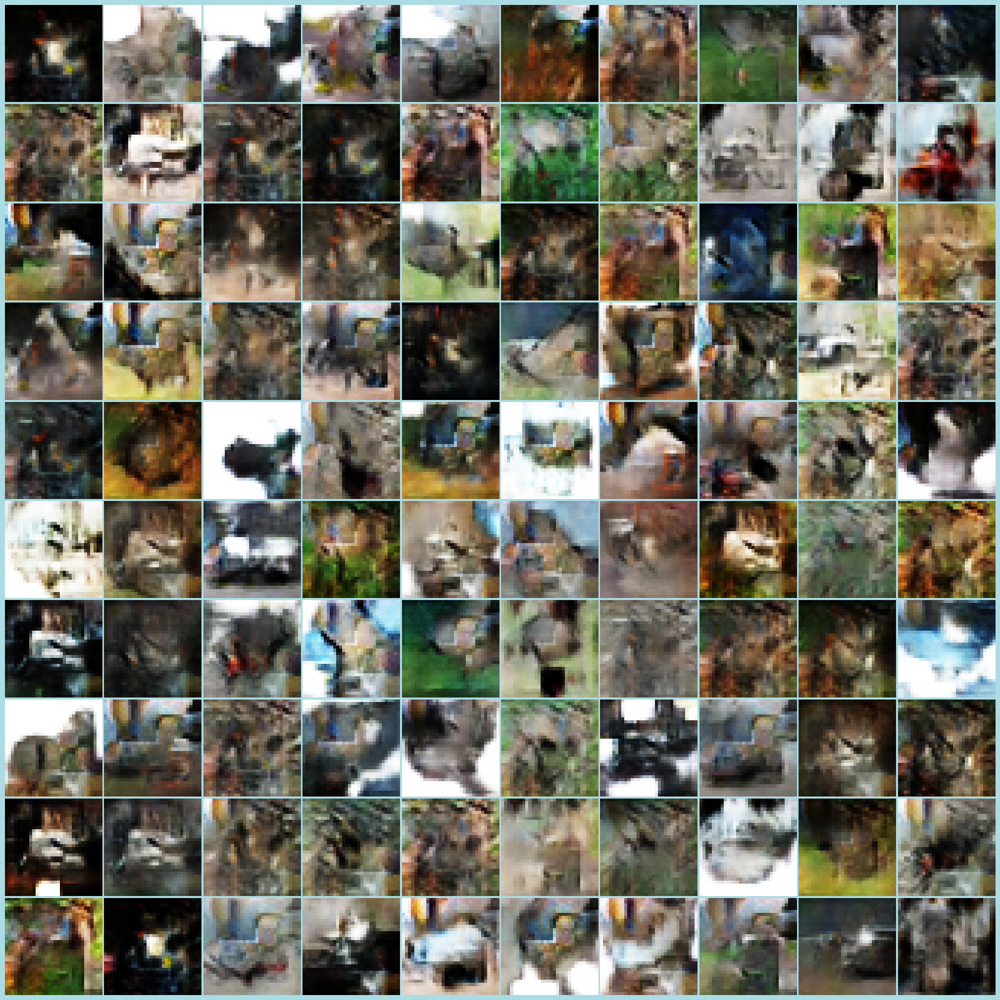

In [57]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>
- Image quality isnt very good here
</div>

#### Storing of results

In [58]:
new_row = {'Model':'CutMix Image CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,2.167156e-02,0.105153,6.727473
1,Sharpened Image CGAN 1,680924.469492,3.372896e+07,0.105472,6.766756
2,CutMix Image CGAN 1,91.519452,7.159536e-02,0.109868,4.574687


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Oversampiling))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">



## __Key Ideas__

1. The idea here is to oversample the dataset that we have
2. The goal is to generate more dataset to be able to have more data to put into training for ga.
3. Resample from sklearn was used to oversample the data here
4. The process was first done on the train data


In [59]:
from sklearn.utils import resample
data =  cifar10.load_data()
(x_train, y_train), (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train, x_test = x_train / 127.5 - 1, x_test / 127.5 - 1
y_train= to_categorical(y_train)
train_data = [(x, y) for x, y in zip(x_train, y_train)]

max_samples = 10000  
oversampled_train_data = []
for class_index in range(10):  
    class_data = [data for data in train_data if data[1][class_index] == 1]
    oversampled_class_data = resample(class_data, replace=True, n_samples=max_samples, random_state=123)
    oversampled_train_data.extend(oversampled_class_data)

x_train_oversampled, y_train_oversampled = zip(*oversampled_train_data)
x_train_oversampled, y_train_oversampled = np.array(x_train_oversampled), np.array(y_train_oversampled)


#### Creating Checkpoint

In [60]:
callbacks = [CGANImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='Oversample CGAN-1')]

#### Training

In [61]:
dataset = tf.data.Dataset.from_tensor_slices((x_train_oversampled, y_train_oversampled))
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [62]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

Epoch 1/100
1559/1563 [============================>.] - ETA: 0s - d_real_loss: 0.3514 - d_fake_loss: 0.3514 - g_loss: 2.7701 - d_acc: 0.8668 - d_realO: 0.2151 - d_fakeO: 0.7897

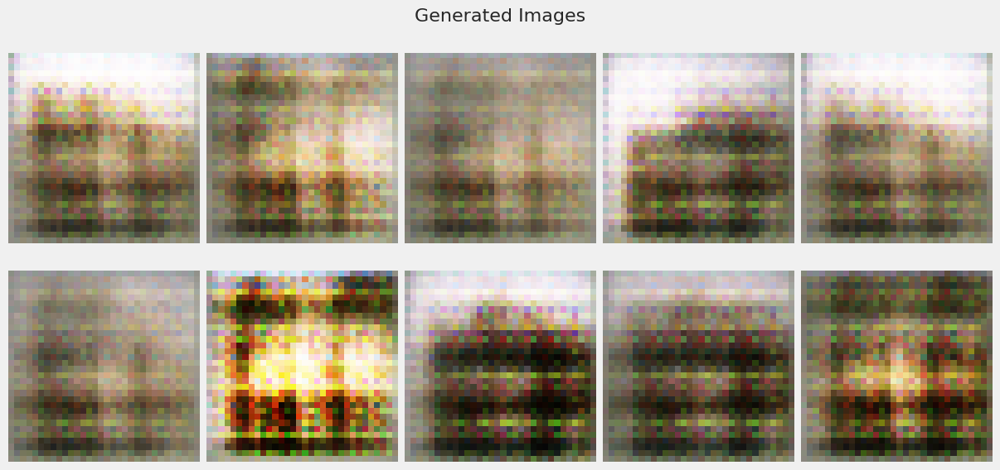

1563/1563 [==============================] - 19s 12ms/step - d_real_loss: 0.3519 - d_fake_loss: 0.3519 - g_loss: 2.7673 - d_acc: 0.8666 - d_realO: 0.2155 - d_fakeO: 0.7891
Epoch 2/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3475 - d_fake_loss: 0.3475 - g_loss: 2.3789 - d_acc: 0.8592 - d_realO: 0.2215 - d_fakeO: 0.7818
Epoch 3/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3310 - d_fake_loss: 0.3310 - g_loss: 2.5689 - d_acc: 0.8636 - d_realO: 0.2074 - d_fakeO: 0.7940
Epoch 4/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3507 - d_fake_loss: 0.3507 - g_loss: 2.4891 - d_acc: 0.8485 - d_realO: 0.2225 - d_fakeO: 0.7783
Epoch 5/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3252 - d_fake_loss: 0.3252 - g_loss: 2.6622 - d_acc: 0.8612 - d_realO: 0.2035 - d_fakeO: 0.7968
Epoch 6/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3201

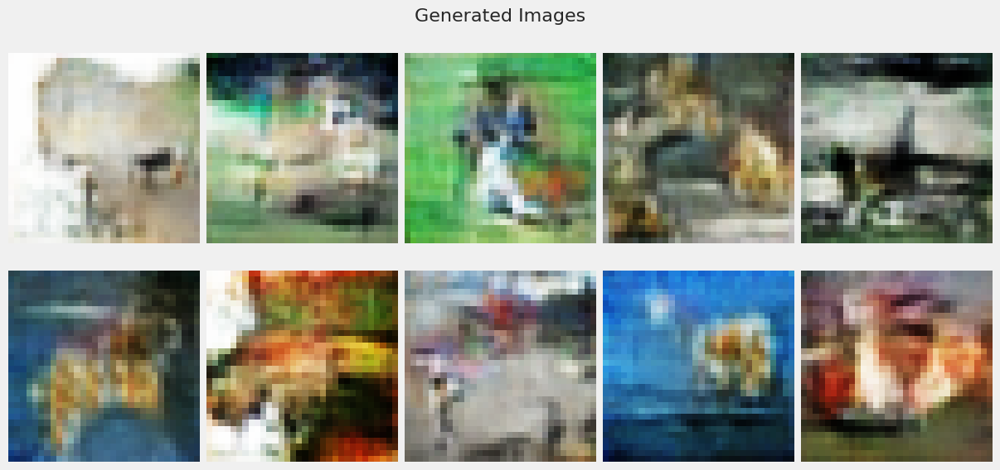

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.3415 - d_fake_loss: 0.3415 - g_loss: 2.3606 - d_acc: 0.8507 - d_realO: 0.2172 - d_fakeO: 0.7833
Epoch 12/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3251 - d_fake_loss: 0.3251 - g_loss: 2.4919 - d_acc: 0.8589 - d_realO: 0.2064 - d_fakeO: 0.7941
Epoch 13/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3204 - d_fake_loss: 0.3204 - g_loss: 2.5406 - d_acc: 0.8607 - d_realO: 0.2032 - d_fakeO: 0.7975
Epoch 14/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.3164 - d_fake_loss: 0.3164 - g_loss: 2.6149 - d_acc: 0.8626 - d_realO: 0.2001 - d_fakeO: 0.8002
Epoch 15/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.3067 - d_fake_loss: 0.3067 - g_loss: 2.6835 - d_acc: 0.8690 - d_realO: 0.1930 - d_fakeO: 0.8078
Epoch 16/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0

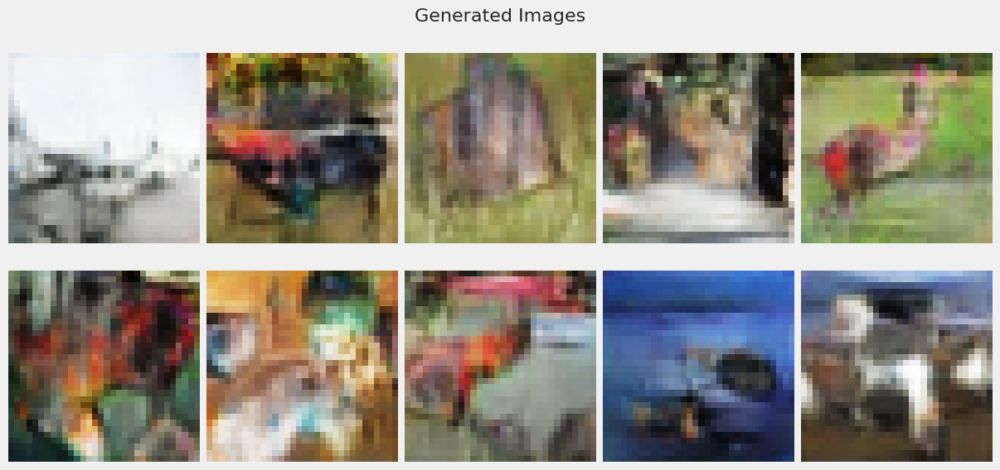

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.2395 - d_fake_loss: 0.2395 - g_loss: 3.4185 - d_acc: 0.9022 - d_realO: 0.1477 - d_fakeO: 0.8528
Epoch 22/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.2285 - d_fake_loss: 0.2285 - g_loss: 3.5663 - d_acc: 0.9066 - d_realO: 0.1407 - d_fakeO: 0.8595
Epoch 23/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.2181 - d_fake_loss: 0.2181 - g_loss: 3.7223 - d_acc: 0.9120 - d_realO: 0.1339 - d_fakeO: 0.8663
Epoch 24/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.2167 - d_fake_loss: 0.2167 - g_loss: 3.7869 - d_acc: 0.9132 - d_realO: 0.1317 - d_fakeO: 0.8685
Epoch 25/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.2048 - d_fake_loss: 0.2048 - g_loss: 3.9543 - d_acc: 0.9182 - d_realO: 0.1251 - d_fakeO: 0.8752
Epoch 26/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

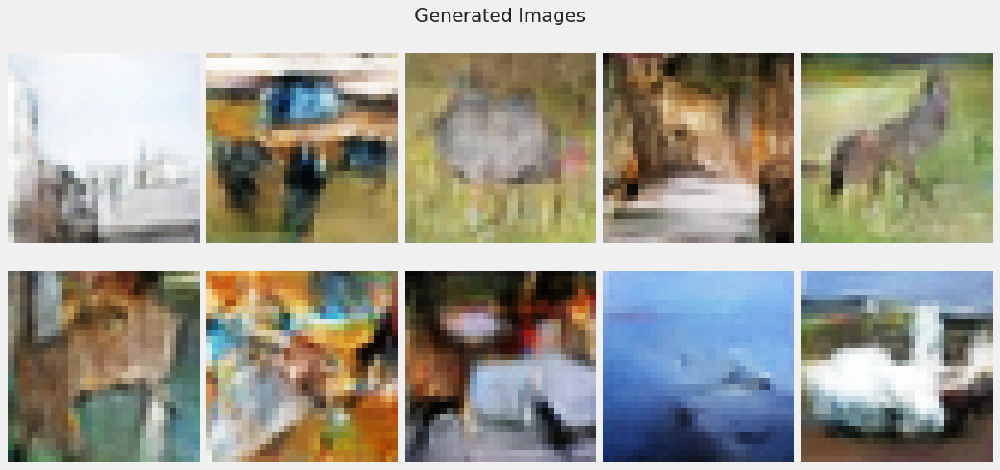

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.1609 - d_fake_loss: 0.1609 - g_loss: 4.8348 - d_acc: 0.9374 - d_realO: 0.0965 - d_fakeO: 0.9036
Epoch 32/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.1580 - d_fake_loss: 0.1580 - g_loss: 4.9496 - d_acc: 0.9389 - d_realO: 0.0945 - d_fakeO: 0.9058
Epoch 33/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.2221 - d_fake_loss: 0.2221 - g_loss: 4.4463 - d_acc: 0.9110 - d_realO: 0.1291 - d_fakeO: 0.8696
Epoch 34/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.1548 - d_fake_loss: 0.1548 - g_loss: 5.0787 - d_acc: 0.9403 - d_realO: 0.0923 - d_fakeO: 0.9081
Epoch 35/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.1470 - d_fake_loss: 0.1470 - g_loss: 5.2495 - d_acc: 0.9439 - d_realO: 0.0871 - d_fakeO: 0.9130
Epoch 36/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0

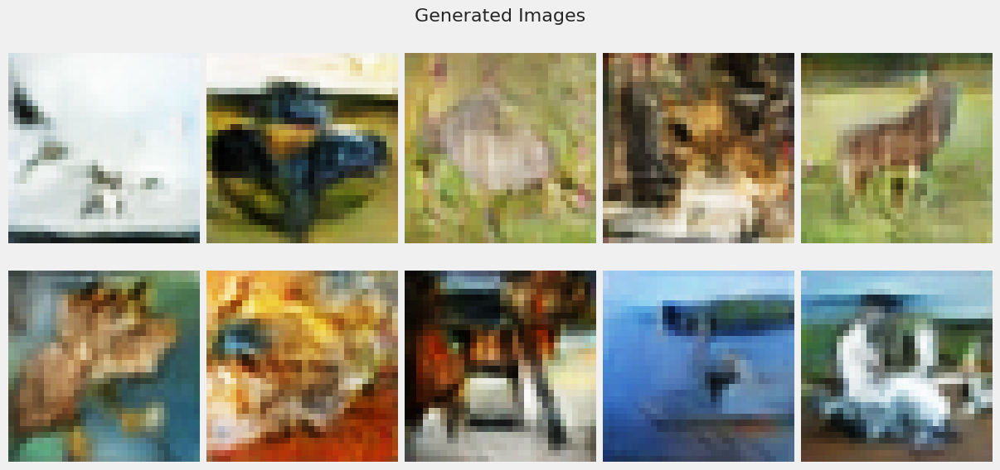

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.1289 - d_fake_loss: 0.1289 - g_loss: 5.8487 - d_acc: 0.9510 - d_realO: 0.0752 - d_fakeO: 0.9251
Epoch 42/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.1222 - d_fake_loss: 0.1222 - g_loss: 6.0192 - d_acc: 0.9538 - d_realO: 0.0713 - d_fakeO: 0.9291
Epoch 43/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.1221 - d_fake_loss: 0.1221 - g_loss: 6.0511 - d_acc: 0.9534 - d_realO: 0.0709 - d_fakeO: 0.9296
Epoch 44/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.1188 - d_fake_loss: 0.1188 - g_loss: 6.0891 - d_acc: 0.9558 - d_realO: 0.0688 - d_fakeO: 0.9315
Epoch 45/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.1126 - d_fake_loss: 0.1126 - g_loss: 6.3160 - d_acc: 0.9579 - d_realO: 0.0653 - d_fakeO: 0.9349
Epoch 46/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

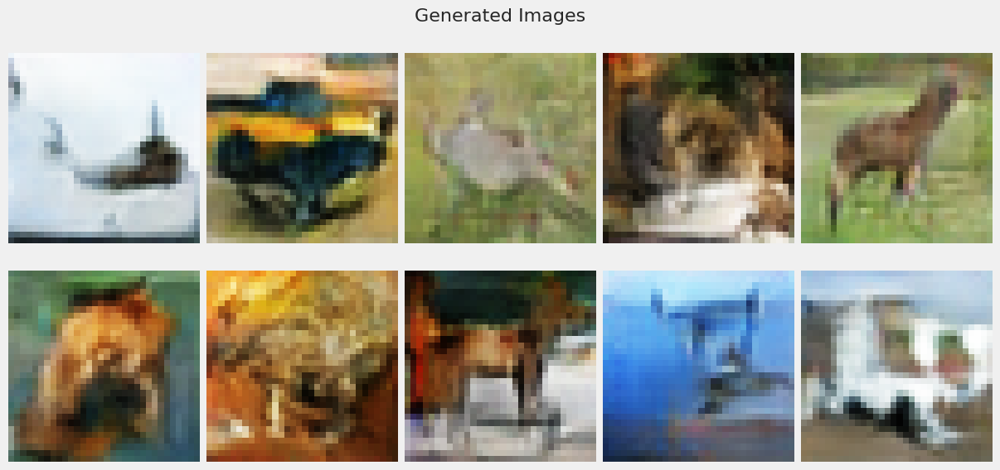

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.1056 - d_fake_loss: 0.1056 - g_loss: 6.6100 - d_acc: 0.9607 - d_realO: 0.0606 - d_fakeO: 0.9398
Epoch 52/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.1058 - d_fake_loss: 0.1058 - g_loss: 6.7079 - d_acc: 0.9611 - d_realO: 0.0605 - d_fakeO: 0.9399
Epoch 53/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0994 - d_fake_loss: 0.0994 - g_loss: 6.7843 - d_acc: 0.9634 - d_realO: 0.0567 - d_fakeO: 0.9435
Epoch 54/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0973 - d_fake_loss: 0.0973 - g_loss: 6.9150 - d_acc: 0.9643 - d_realO: 0.0558 - d_fakeO: 0.9446
Epoch 55/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0965 - d_fake_loss: 0.0965 - g_loss: 6.9833 - d_acc: 0.9645 - d_realO: 0.0550 - d_fakeO: 0.9454
Epoch 56/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

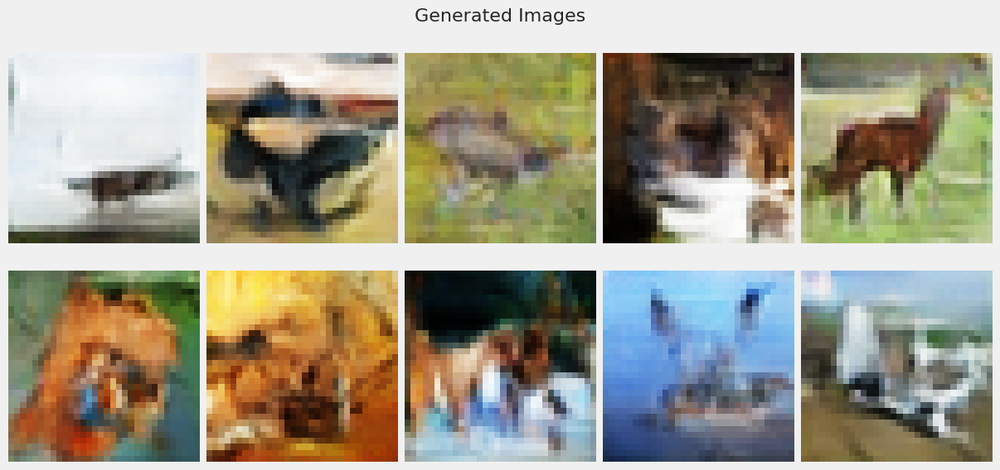

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0851 - d_fake_loss: 0.0851 - g_loss: 7.4029 - d_acc: 0.9691 - d_realO: 0.0481 - d_fakeO: 0.9522
Epoch 62/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0833 - d_fake_loss: 0.0833 - g_loss: 7.5288 - d_acc: 0.9694 - d_realO: 0.0471 - d_fakeO: 0.9533
Epoch 63/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0846 - d_fake_loss: 0.0846 - g_loss: 7.5752 - d_acc: 0.9689 - d_realO: 0.0475 - d_fakeO: 0.9528
Epoch 64/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0830 - d_fake_loss: 0.0830 - g_loss: 7.6000 - d_acc: 0.9694 - d_realO: 0.0470 - d_fakeO: 0.9534
Epoch 65/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0850 - d_fake_loss: 0.0850 - g_loss: 7.6619 - d_acc: 0.9686 - d_realO: 0.0475 - d_fakeO: 0.9530
Epoch 66/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

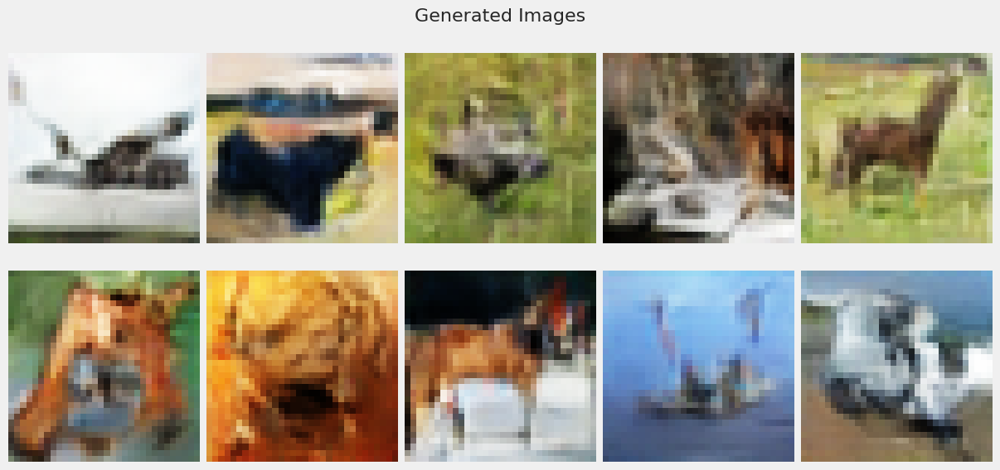

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0760 - d_fake_loss: 0.0760 - g_loss: 7.9725 - d_acc: 0.9724 - d_realO: 0.0425 - d_fakeO: 0.9580
Epoch 72/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0734 - d_fake_loss: 0.0734 - g_loss: 8.0439 - d_acc: 0.9735 - d_realO: 0.0409 - d_fakeO: 0.9592
Epoch 73/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0780 - d_fake_loss: 0.0780 - g_loss: 7.9584 - d_acc: 0.9720 - d_realO: 0.0429 - d_fakeO: 0.9575
Epoch 74/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0732 - d_fake_loss: 0.0732 - g_loss: 8.0318 - d_acc: 0.9739 - d_realO: 0.0405 - d_fakeO: 0.9597
Epoch 75/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0704 - d_fake_loss: 0.0704 - g_loss: 8.2183 - d_acc: 0.9743 - d_realO: 0.0395 - d_fakeO: 0.9609
Epoch 76/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

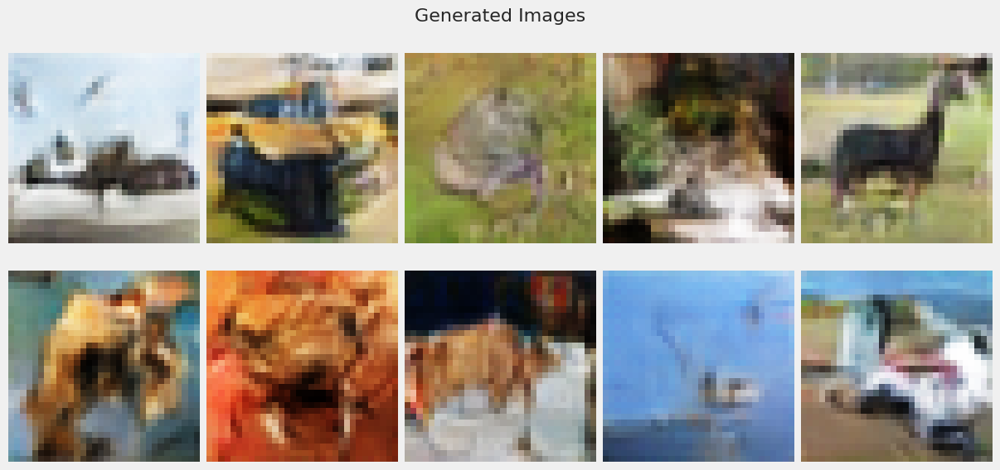

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0695 - d_fake_loss: 0.0695 - g_loss: 8.4540 - d_acc: 0.9751 - d_realO: 0.0387 - d_fakeO: 0.9618
Epoch 82/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0702 - d_fake_loss: 0.0702 - g_loss: 8.4743 - d_acc: 0.9746 - d_realO: 0.0387 - d_fakeO: 0.9618
Epoch 83/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0688 - d_fake_loss: 0.0688 - g_loss: 8.5698 - d_acc: 0.9748 - d_realO: 0.0380 - d_fakeO: 0.9623
Epoch 84/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0659 - d_fake_loss: 0.0659 - g_loss: 8.5958 - d_acc: 0.9761 - d_realO: 0.0364 - d_fakeO: 0.9640
Epoch 85/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0701 - d_fake_loss: 0.0701 - g_loss: 8.5628 - d_acc: 0.9747 - d_realO: 0.0384 - d_fakeO: 0.9622
Epoch 86/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0

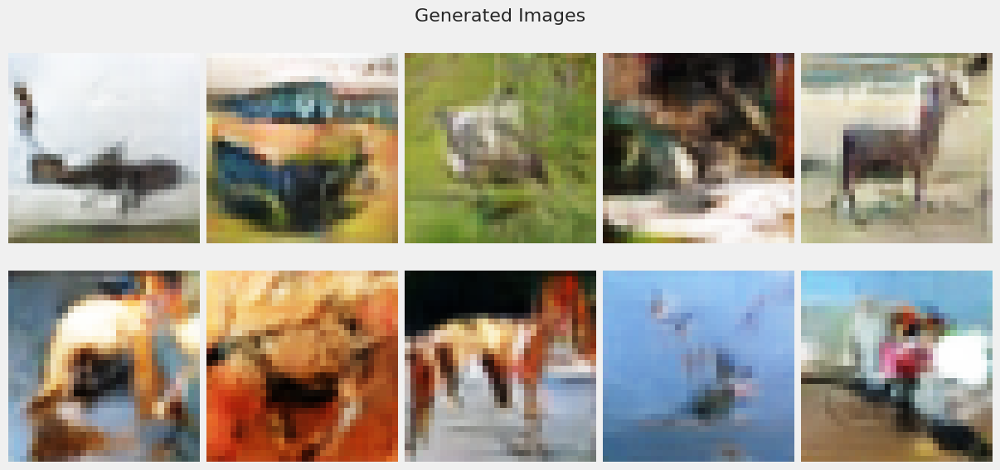

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.0656 - d_fake_loss: 0.0656 - g_loss: 8.7830 - d_acc: 0.9760 - d_realO: 0.0358 - d_fakeO: 0.9645
Epoch 92/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0626 - d_fake_loss: 0.0626 - g_loss: 8.7939 - d_acc: 0.9776 - d_realO: 0.0343 - d_fakeO: 0.9660
Epoch 93/100
1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.0616 - d_fake_loss: 0.0616 - g_loss: 8.8274 - d_acc: 0.9780 - d_realO: 0.0338 - d_fakeO: 0.9668
Epoch 94/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0636 - d_fake_loss: 0.0636 - g_loss: 8.8763 - d_acc: 0.9774 - d_realO: 0.0341 - d_fakeO: 0.9661
Epoch 95/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.0651 - d_fake_loss: 0.0651 - g_loss: 8.8227 - d_acc: 0.9768 - d_realO: 0.0352 - d_fakeO: 0.9653
Epoch 96/100
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0

In [63]:
gan_5 = train_gan(discriminator_cgan1, generator_cgan1, noise, 'Oversample CGAN 1', dataset, 90, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  97% accuracy
- No model collapse


</div>

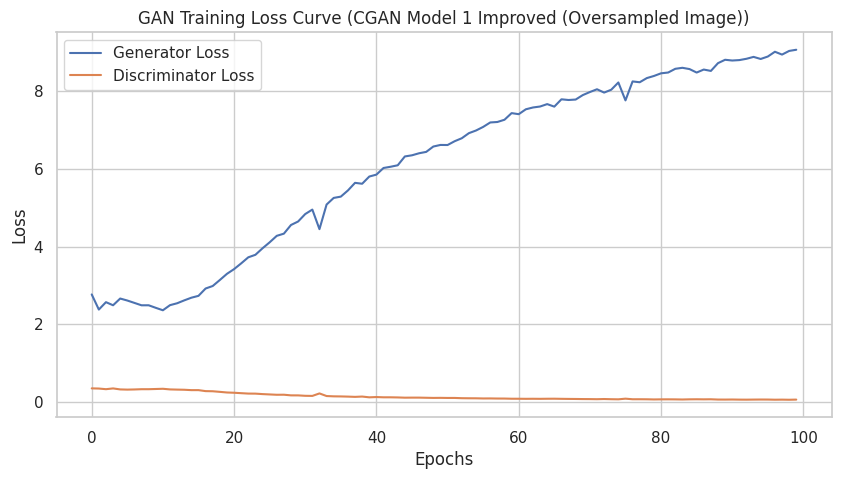

In [64]:
gan_history_5 = gan_5[0].history
generator = gan_5[1].generator  
gan_history_5['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_5['d_real_loss'], gan_history_5['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_5, title='GAN Training Loss Curve (CGAN Model 1 Improved (Oversampled Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it proceeded to increase slowly


</div>

In [65]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 32.97242519021577
KID Score: 0.020732207608177067


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 52
- KID Score is 0.02
Improvement seen over baseline model

</div>

4/4 [==============================] - 0s 1ms/step
Class 0 - 100 Generated Images


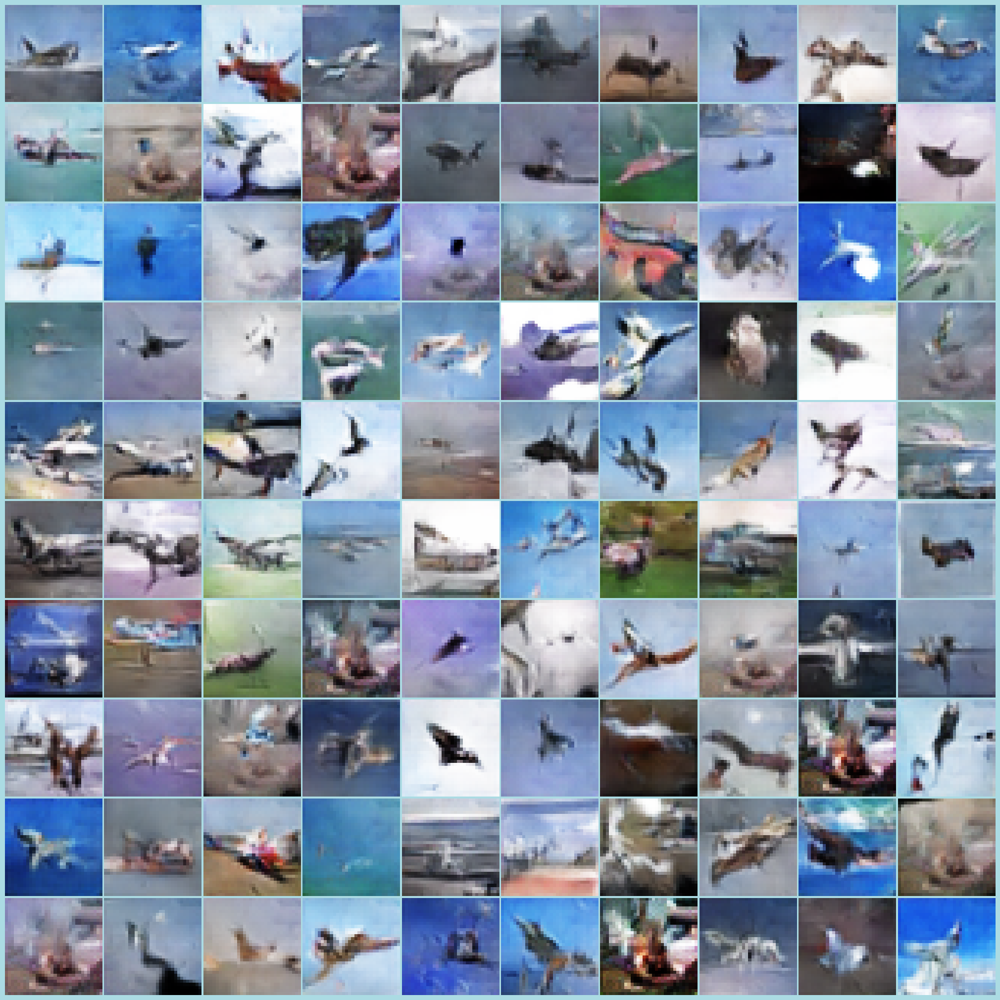

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


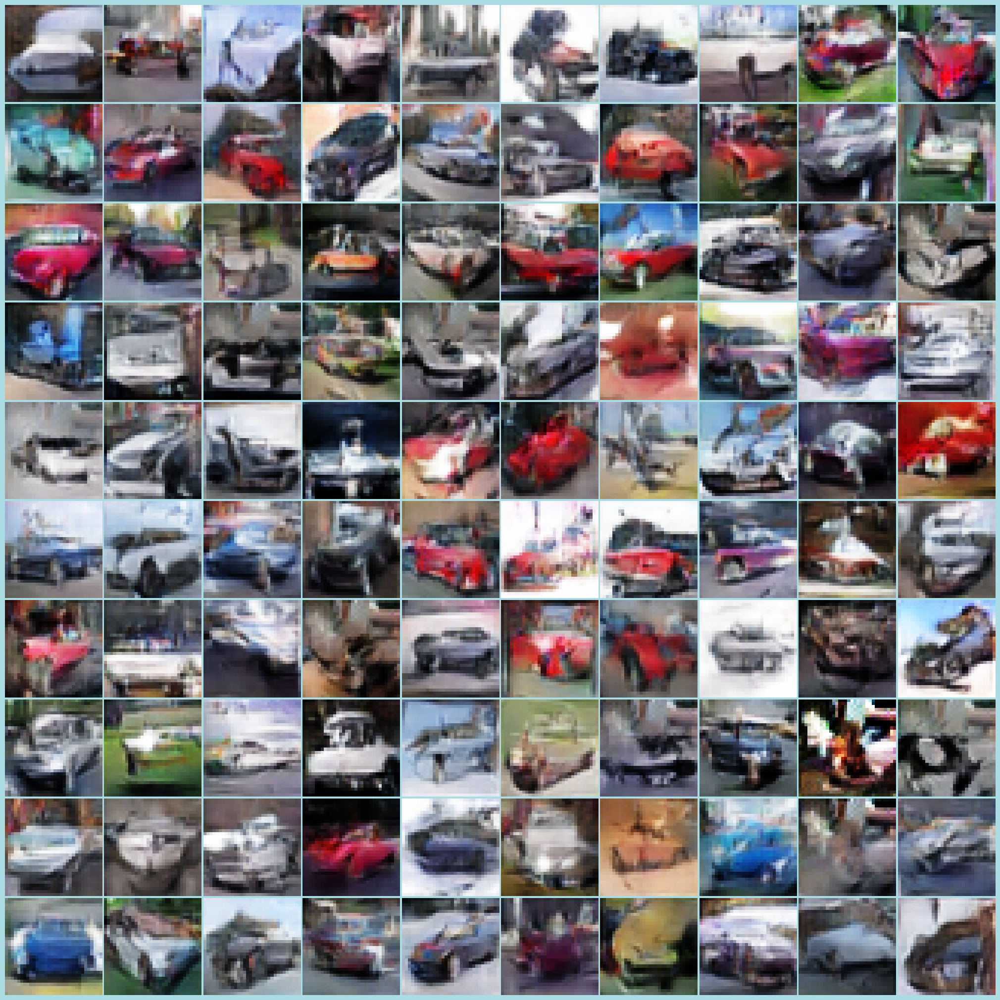

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


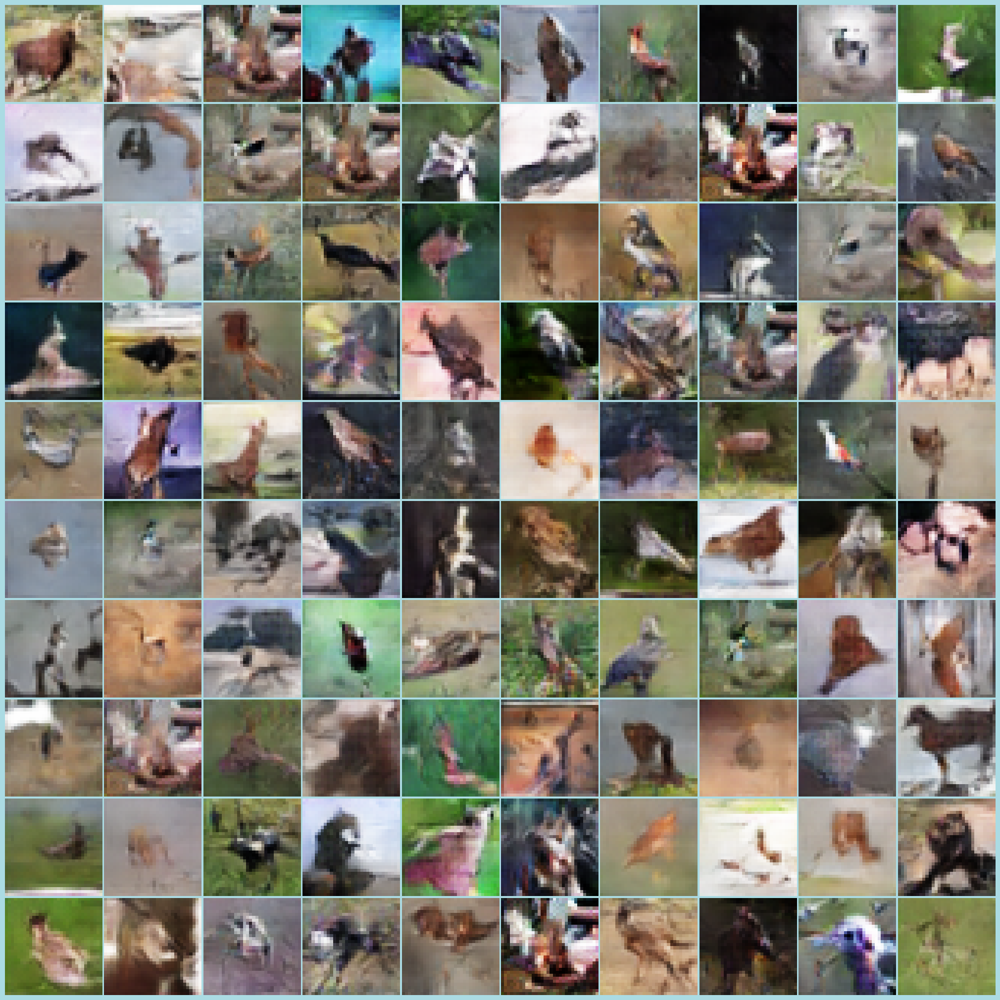

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


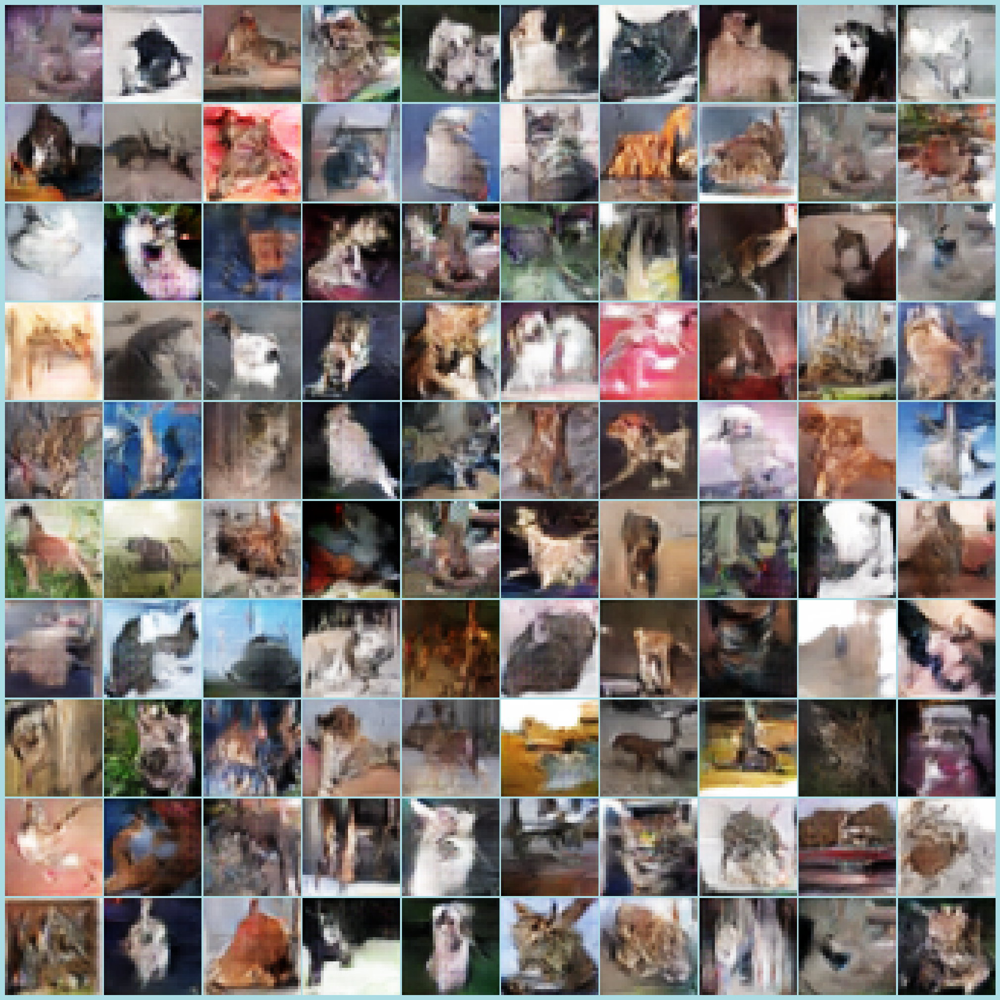

4/4 [==============================] - 0s 2ms/step
Class 4 - 100 Generated Images


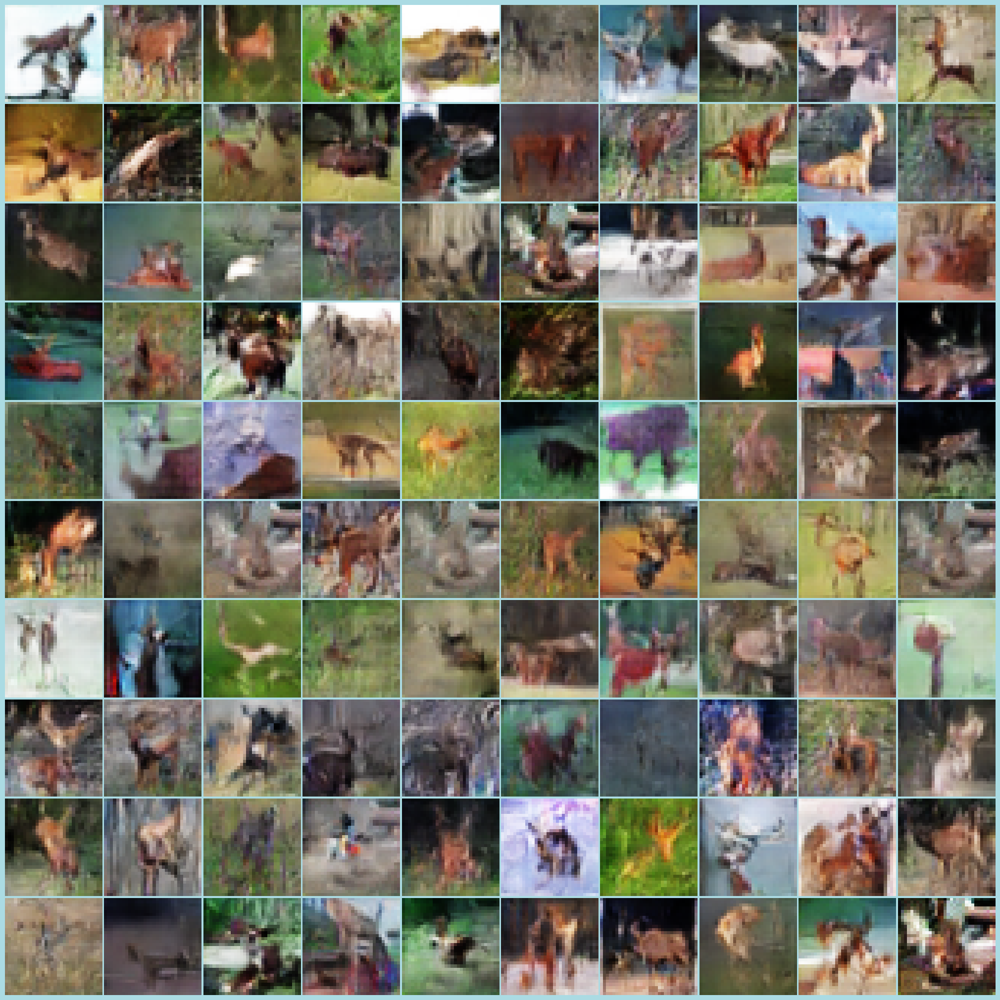

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


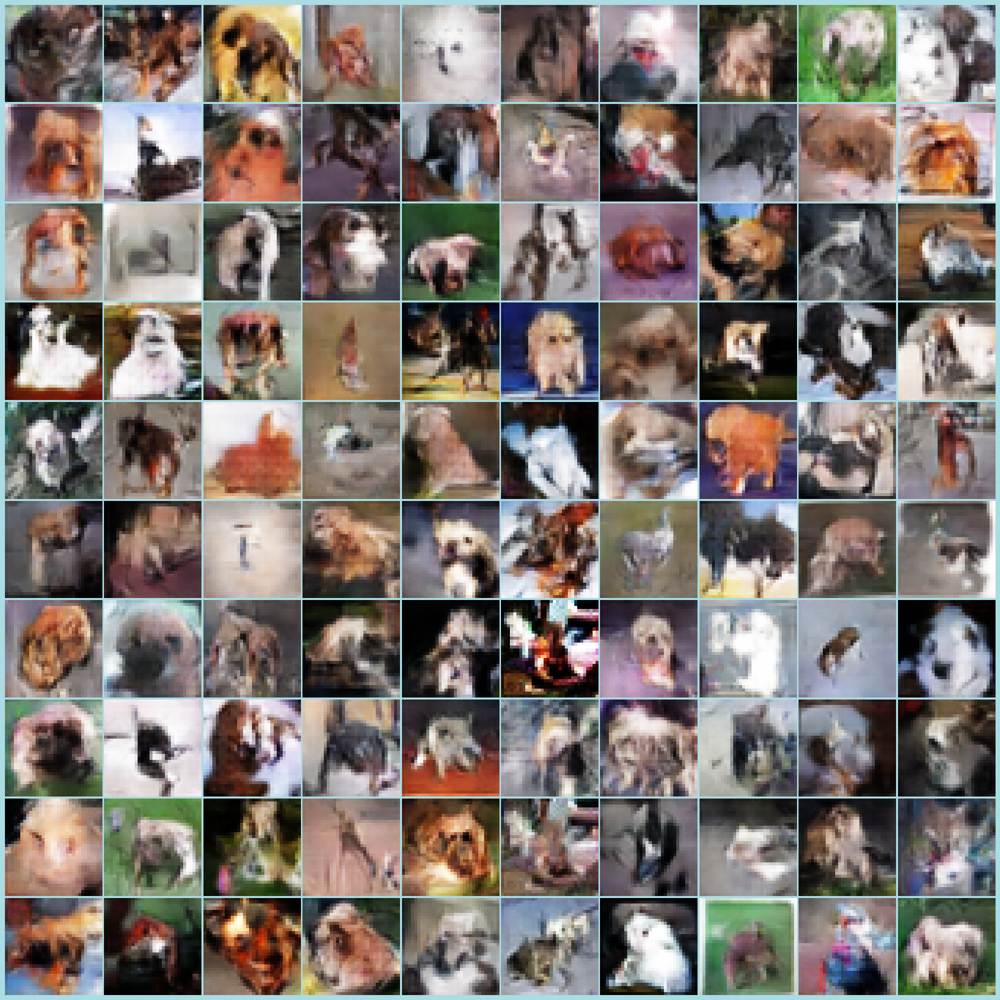

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


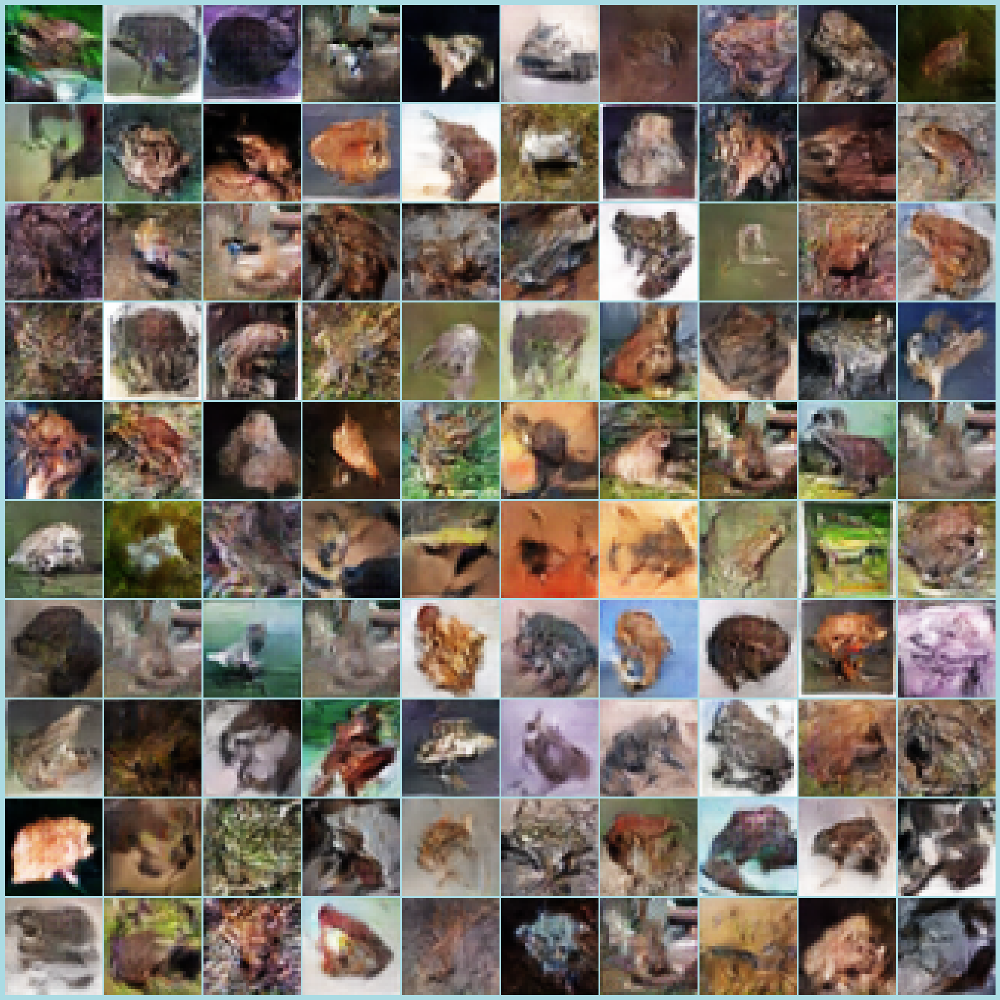

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


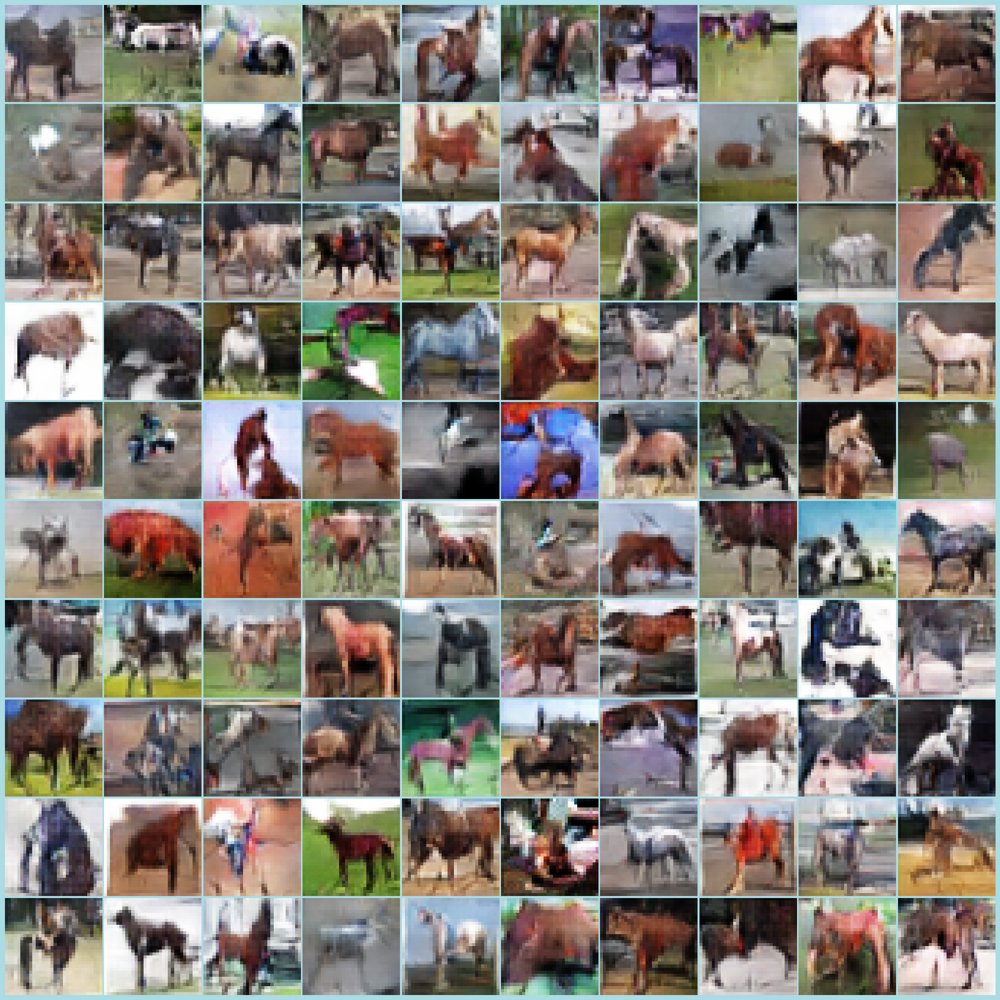

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


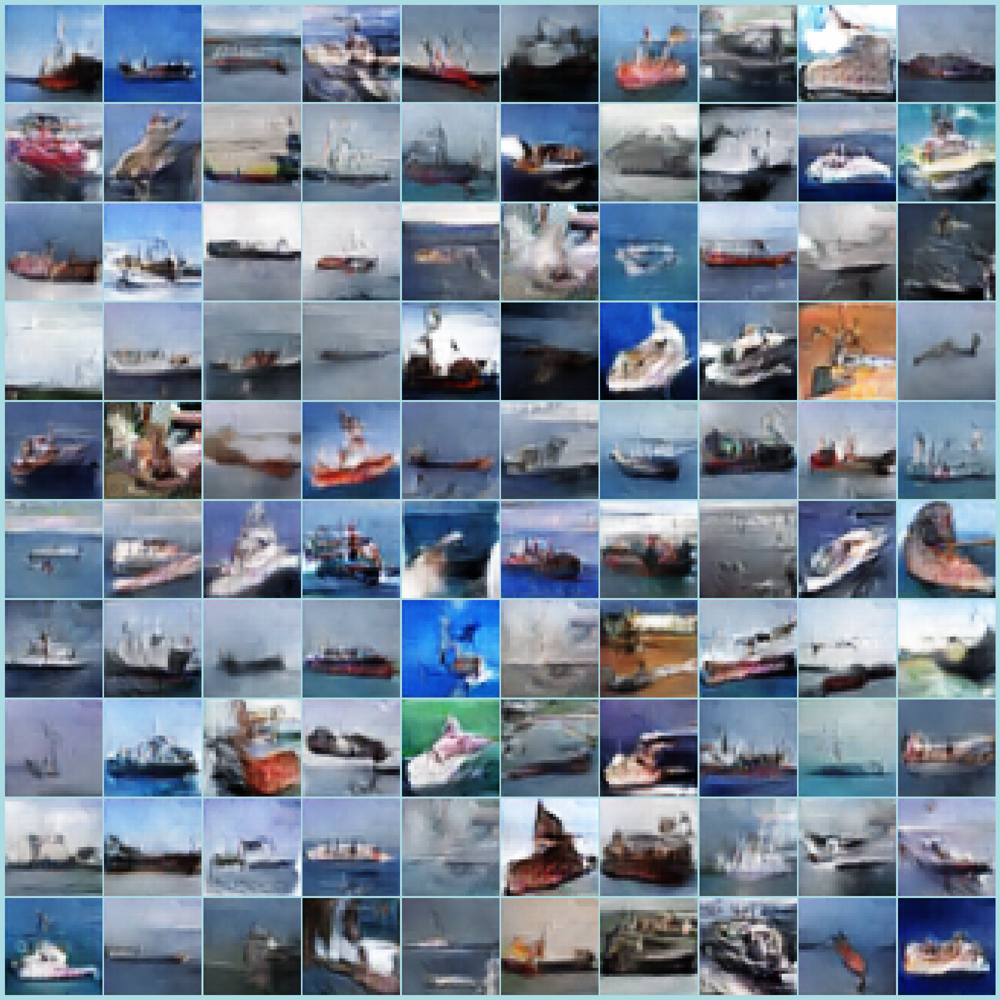

4/4 [==============================] - 0s 2ms/step
Class 9 - 100 Generated Images


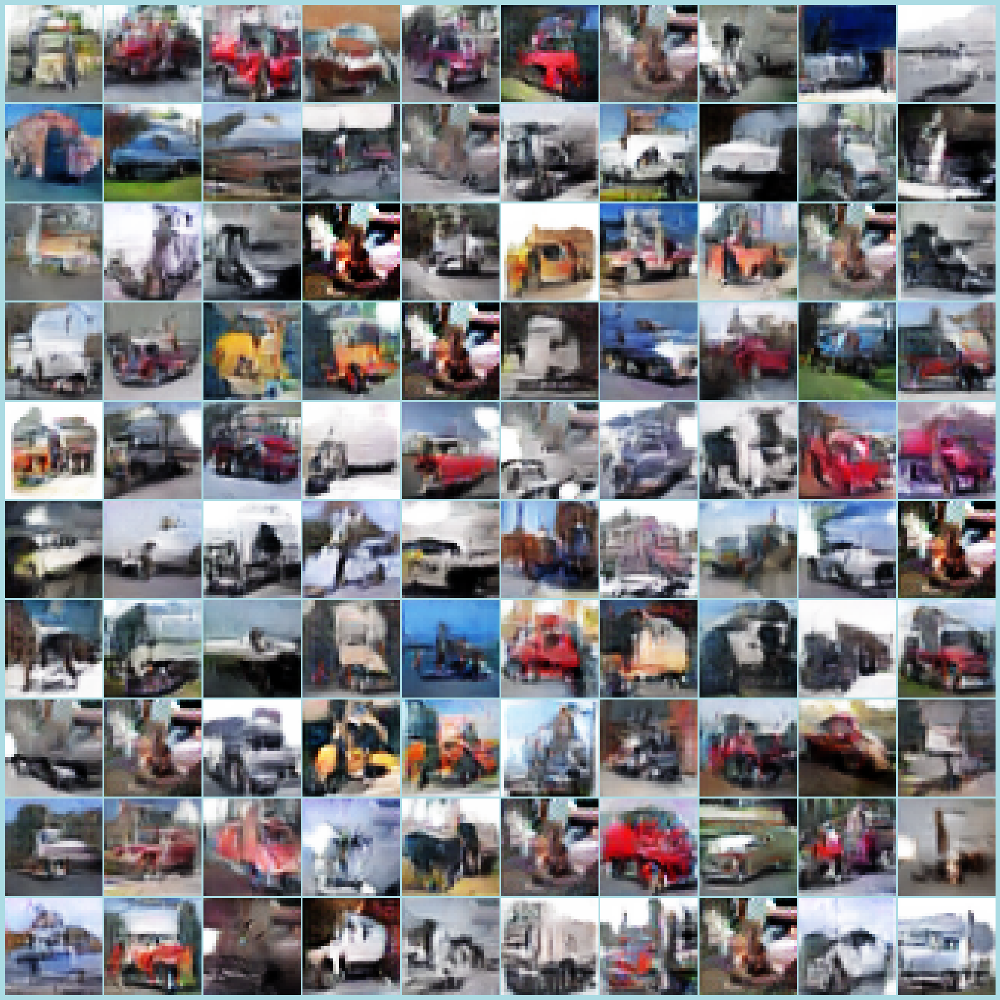

In [66]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>
- Image quality is really good
</div>

In [67]:
new_row = {'Model':'Oversample Image CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,2.167156e-02,0.105153,6.727473
1,Sharpened Image CGAN 1,680924.469492,3.372896e+07,0.105472,6.766756
2,CutMix Image CGAN 1,91.519452,7.159536e-02,0.109868,4.574687
3,Oversample Image CGAN 1,32.972425,2.073221e-02,0.109868,4.574687


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Add Learning Rate Scheduler)__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [68]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
y_train = to_categorical(y_train)
latent_dim = 128

### Cosine Decay Schedular

### __Key Ideas__
1. Cosine decay reduces the learning rate in cosine wave pattern, slowing down at the beggining and end of traing.
2. The idea is to start with an initial learning rate and then reduce it which at the start descends slowly and more stteeply in the middle.
3. This approach is suitable for training neural networks as it combines both rapid and slow decay of learning rate

In [69]:
def cosine_decay_scheduler(initial_lr=0.001, alpha=0.0, decay_steps=100000, 
                                          warmup_steps=1000, min_lr=None, decay_rate=1.0, 
                                          restart_period=10000):
    if min_lr is None:
        min_lr = alpha * initial_lr
    def scheduler(epoch, lr):
        if epoch < warmup_steps:
            return epoch * (initial_lr - min_lr) / warmup_steps + min_lr
        else:
            adjusted_epoch = (epoch - warmup_steps) % restart_period
            cosine_lr = (1 - alpha) * 0.5 * (1 + np.cos(np.pi * adjusted_epoch / (decay_steps * decay_rate))) * initial_lr + alpha * initial_lr
            return max(cosine_lr, min_lr)

    return tf.keras.callbacks.LearningRateScheduler(scheduler)

#### Creating Checkpoint

In [70]:
callbacks = [CGANImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='CosineDecay CGAN-1')]

#### Training

In [71]:
dataset = tf.data.Dataset.from_tensor_slices((x_train, y_train))
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [72]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

In [73]:
lr_scheduler = cosine_decay_scheduler()
callbacks.append(lr_scheduler)

Epoch 1/100
780/782 [============================>.] - ETA: 0s - d_real_loss: 0.2864 - d_fake_loss: 0.2864 - g_loss: 3.4595 - d_acc: 0.9025 - d_realO: 0.1576 - d_fakeO: 0.8478

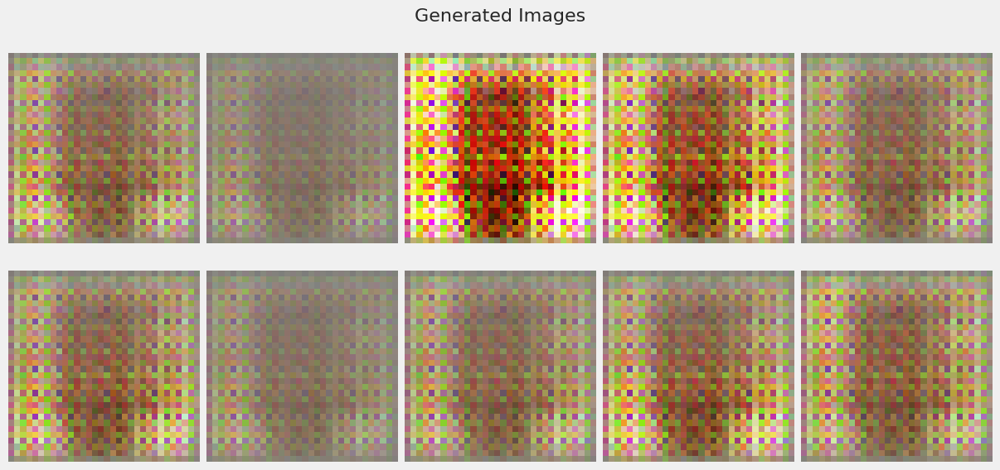

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.2860 - d_fake_loss: 0.2860 - g_loss: 3.4590 - d_acc: 0.9027 - d_realO: 0.1577 - d_fakeO: 0.8482 - lr: 0.0000e+00
Epoch 2/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2276 - d_fake_loss: 0.2276 - g_loss: 3.7147 - d_acc: 0.9251 - d_realO: 0.1262 - d_fakeO: 0.8690 - lr: 1.0000e-06
Epoch 3/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2415 - d_fake_loss: 0.2415 - g_loss: 3.3347 - d_acc: 0.9155 - d_realO: 0.1392 - d_fakeO: 0.8579 - lr: 2.0000e-06
Epoch 4/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2957 - d_fake_loss: 0.2957 - g_loss: 2.7357 - d_acc: 0.8872 - d_realO: 0.1812 - d_fakeO: 0.8179 - lr: 3.0000e-06
Epoch 5/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2867 - d_fake_loss: 0.2867 - g_loss: 2.6549 - d_acc: 0.8870 - d_realO: 0.1787 - d_fakeO: 0.8240 - lr: 4.0000e-06
Epoch 6/100
782/782 [

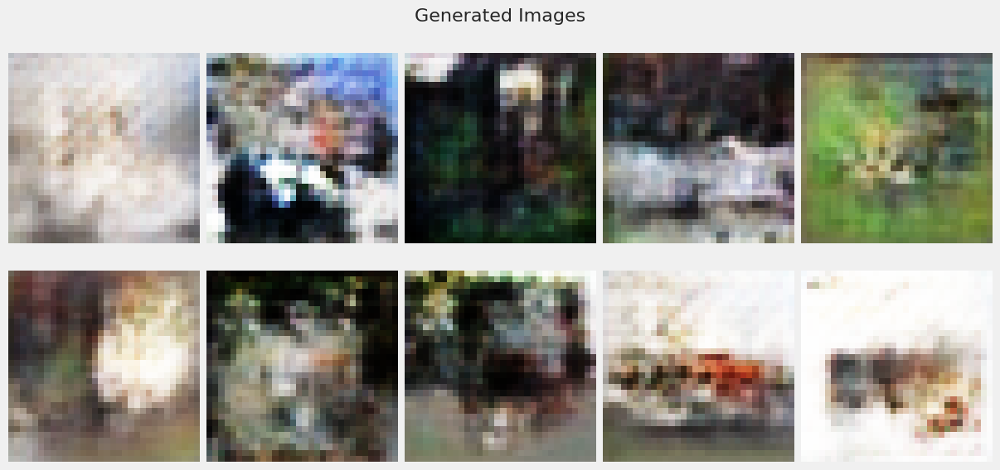

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.3117 - d_fake_loss: 0.3117 - g_loss: 2.6118 - d_acc: 0.8675 - d_realO: 0.1968 - d_fakeO: 0.8030 - lr: 1.0000e-05
Epoch 12/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3108 - d_fake_loss: 0.3108 - g_loss: 2.5564 - d_acc: 0.8663 - d_realO: 0.1992 - d_fakeO: 0.8013 - lr: 1.1000e-05
Epoch 13/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3173 - d_fake_loss: 0.3173 - g_loss: 2.4950 - d_acc: 0.8632 - d_realO: 0.2021 - d_fakeO: 0.7982 - lr: 1.2000e-05
Epoch 14/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3226 - d_fake_loss: 0.3226 - g_loss: 2.3982 - d_acc: 0.8566 - d_realO: 0.2075 - d_fakeO: 0.7931 - lr: 1.3000e-05
Epoch 15/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3309 - d_fake_loss: 0.3309 - g_loss: 2.3117 - d_acc: 0.8545 - d_realO: 0.2141 - d_fakeO: 0.7869 - lr: 1.4000e-05
Epoch 16/100
782/7

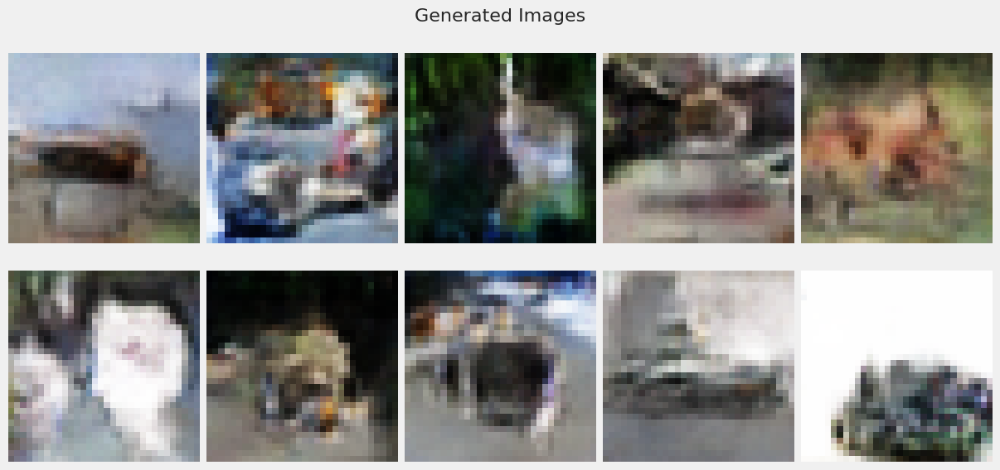

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.3164 - d_fake_loss: 0.3164 - g_loss: 2.4525 - d_acc: 0.8616 - d_realO: 0.2016 - d_fakeO: 0.7987 - lr: 2.0000e-05
Epoch 22/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2957 - d_fake_loss: 0.2957 - g_loss: 2.5847 - d_acc: 0.8716 - d_realO: 0.1906 - d_fakeO: 0.8103 - lr: 2.1000e-05
Epoch 23/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3412 - d_fake_loss: 0.3412 - g_loss: 2.3795 - d_acc: 0.8518 - d_realO: 0.2144 - d_fakeO: 0.7849 - lr: 2.2000e-05
Epoch 24/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2924 - d_fake_loss: 0.2924 - g_loss: 2.6256 - d_acc: 0.8737 - d_realO: 0.1891 - d_fakeO: 0.8124 - lr: 2.3000e-05
Epoch 25/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2879 - d_fake_loss: 0.2879 - g_loss: 2.6922 - d_acc: 0.8757 - d_realO: 0.1841 - d_fakeO: 0.8165 - lr: 2.4000e-05
Epoch 26/100
782/7

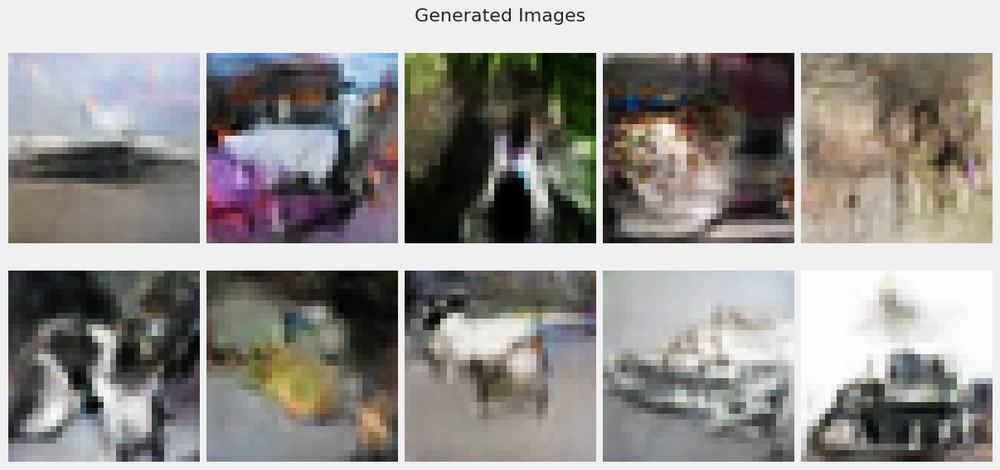

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2531 - d_fake_loss: 0.2531 - g_loss: 3.0899 - d_acc: 0.8927 - d_realO: 0.1611 - d_fakeO: 0.8395 - lr: 3.0000e-05
Epoch 32/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2569 - d_fake_loss: 0.2569 - g_loss: 3.0752 - d_acc: 0.8908 - d_realO: 0.1618 - d_fakeO: 0.8382 - lr: 3.1000e-05
Epoch 33/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2428 - d_fake_loss: 0.2428 - g_loss: 3.2377 - d_acc: 0.8986 - d_realO: 0.1541 - d_fakeO: 0.8467 - lr: 3.2000e-05
Epoch 34/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2312 - d_fake_loss: 0.2312 - g_loss: 3.3411 - d_acc: 0.9035 - d_realO: 0.1472 - d_fakeO: 0.8532 - lr: 3.3000e-05
Epoch 35/100
782/782 [==============================] - 8s 11ms/step - d_real_loss: 0.2300 - d_fake_loss: 0.2300 - g_loss: 3.3993 - d_acc: 0.9044 - d_realO: 0.1452 - d_fakeO: 0.8553 - lr: 3.4000e-05
Epoch 36/100
782/7

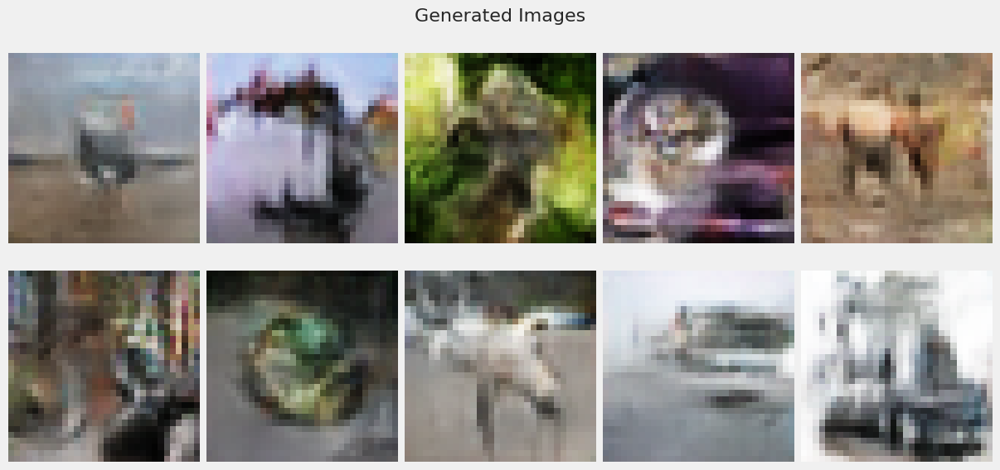

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1952 - d_fake_loss: 0.1952 - g_loss: 3.9306 - d_acc: 0.9210 - d_realO: 0.1220 - d_fakeO: 0.8785 - lr: 4.0000e-05
Epoch 42/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2071 - d_fake_loss: 0.2071 - g_loss: 3.8575 - d_acc: 0.9171 - d_realO: 0.1269 - d_fakeO: 0.8735 - lr: 4.1000e-05
Epoch 43/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1852 - d_fake_loss: 0.1852 - g_loss: 4.1201 - d_acc: 0.9260 - d_realO: 0.1160 - d_fakeO: 0.8844 - lr: 4.2000e-05
Epoch 44/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1847 - d_fake_loss: 0.1847 - g_loss: 4.2106 - d_acc: 0.9262 - d_realO: 0.1144 - d_fakeO: 0.8862 - lr: 4.3000e-05
Epoch 45/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1844 - d_fake_loss: 0.1844 - g_loss: 4.2678 - d_acc: 0.9260 - d_realO: 0.1136 - d_fakeO: 0.8867 - lr: 4.4000e-05
Epoch 46/100
782/7

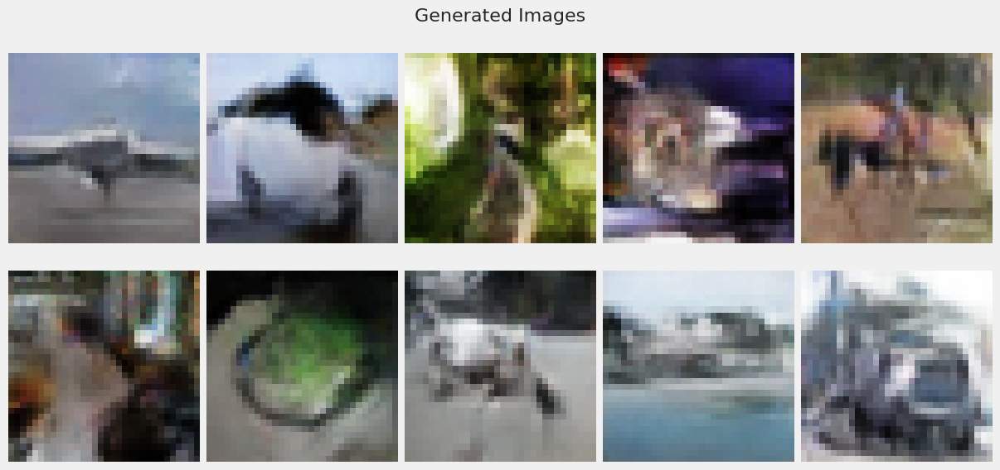

782/782 [==============================] - 10s 13ms/step - d_real_loss: 0.1631 - d_fake_loss: 0.1631 - g_loss: 4.7091 - d_acc: 0.9353 - d_realO: 0.0993 - d_fakeO: 0.9008 - lr: 5.0000e-05
Epoch 52/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1608 - d_fake_loss: 0.1608 - g_loss: 4.7002 - d_acc: 0.9371 - d_realO: 0.0985 - d_fakeO: 0.9022 - lr: 5.1000e-05
Epoch 53/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1563 - d_fake_loss: 0.1563 - g_loss: 4.8450 - d_acc: 0.9389 - d_realO: 0.0955 - d_fakeO: 0.9049 - lr: 5.2000e-05
Epoch 54/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1523 - d_fake_loss: 0.1523 - g_loss: 4.9195 - d_acc: 0.9407 - d_realO: 0.0927 - d_fakeO: 0.9076 - lr: 5.3000e-05
Epoch 55/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1515 - d_fake_loss: 0.1515 - g_loss: 4.9565 - d_acc: 0.9412 - d_realO: 0.0910 - d_fakeO: 0.9093 - lr: 5.4000e-05
Epoch 56/100
782/

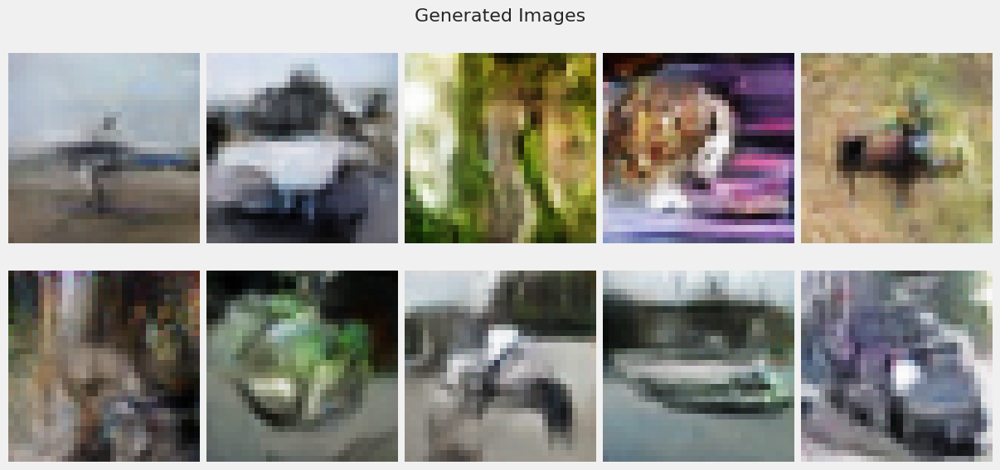

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1389 - d_fake_loss: 0.1389 - g_loss: 5.2874 - d_acc: 0.9461 - d_realO: 0.0835 - d_fakeO: 0.9168 - lr: 6.0000e-05
Epoch 62/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1346 - d_fake_loss: 0.1346 - g_loss: 5.3733 - d_acc: 0.9487 - d_realO: 0.0809 - d_fakeO: 0.9195 - lr: 6.1000e-05
Epoch 63/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1330 - d_fake_loss: 0.1330 - g_loss: 5.4617 - d_acc: 0.9489 - d_realO: 0.0796 - d_fakeO: 0.9203 - lr: 6.2000e-05
Epoch 64/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1331 - d_fake_loss: 0.1331 - g_loss: 5.4463 - d_acc: 0.9492 - d_realO: 0.0797 - d_fakeO: 0.9209 - lr: 6.3000e-05
Epoch 65/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1342 - d_fake_loss: 0.1342 - g_loss: 5.5312 - d_acc: 0.9485 - d_realO: 0.0803 - d_fakeO: 0.9200 - lr: 6.4000e-05
Epoch 66/100
782/7

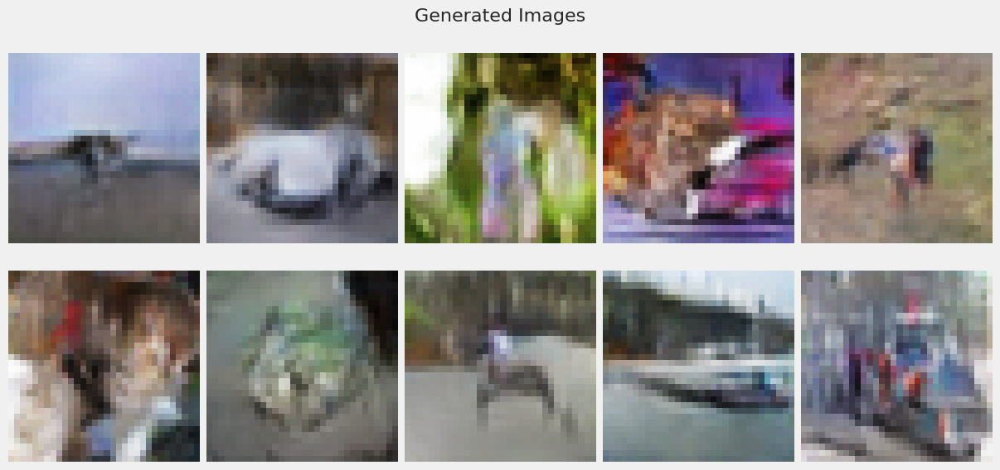

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1209 - d_fake_loss: 0.1209 - g_loss: 5.8924 - d_acc: 0.9542 - d_realO: 0.0716 - d_fakeO: 0.9288 - lr: 7.0000e-05
Epoch 72/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1513 - d_fake_loss: 0.1513 - g_loss: 5.5602 - d_acc: 0.9457 - d_realO: 0.0825 - d_fakeO: 0.9170 - lr: 7.1000e-05
Epoch 73/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1148 - d_fake_loss: 0.1148 - g_loss: 5.8207 - d_acc: 0.9573 - d_realO: 0.0694 - d_fakeO: 0.9307 - lr: 7.2000e-05
Epoch 74/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1163 - d_fake_loss: 0.1163 - g_loss: 5.9702 - d_acc: 0.9561 - d_realO: 0.0691 - d_fakeO: 0.9315 - lr: 7.3000e-05
Epoch 75/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1201 - d_fake_loss: 0.1201 - g_loss: 5.9545 - d_acc: 0.9546 - d_realO: 0.0708 - d_fakeO: 0.9297 - lr: 7.4000e-05
Epoch 76/100
782/7

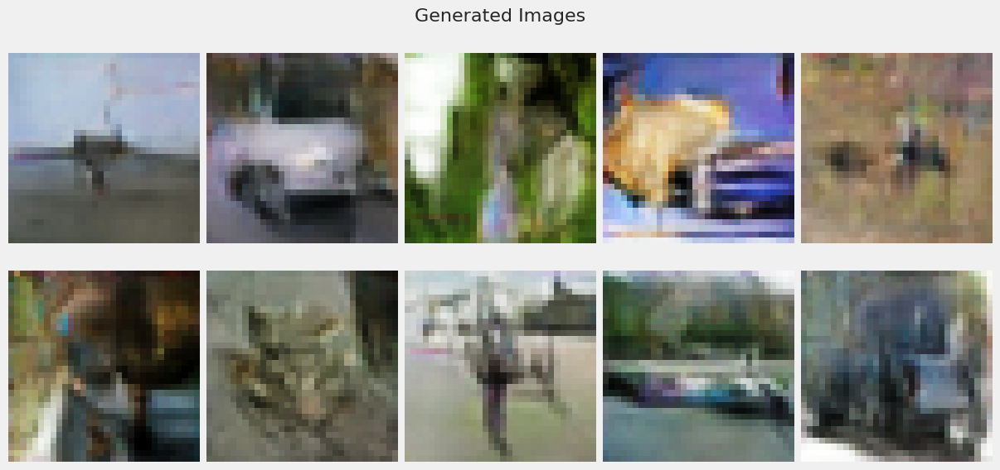

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1082 - d_fake_loss: 0.1082 - g_loss: 6.3126 - d_acc: 0.9595 - d_realO: 0.0638 - d_fakeO: 0.9367 - lr: 8.0000e-05
Epoch 82/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1060 - d_fake_loss: 0.1060 - g_loss: 6.3404 - d_acc: 0.9606 - d_realO: 0.0625 - d_fakeO: 0.9379 - lr: 8.1000e-05
Epoch 83/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1112 - d_fake_loss: 0.1112 - g_loss: 6.3660 - d_acc: 0.9578 - d_realO: 0.0646 - d_fakeO: 0.9357 - lr: 8.2000e-05
Epoch 84/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1094 - d_fake_loss: 0.1094 - g_loss: 6.4169 - d_acc: 0.9589 - d_realO: 0.0636 - d_fakeO: 0.9367 - lr: 8.3000e-05
Epoch 85/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1043 - d_fake_loss: 0.1043 - g_loss: 6.5288 - d_acc: 0.9607 - d_realO: 0.0615 - d_fakeO: 0.9391 - lr: 8.4000e-05
Epoch 86/100
782/7

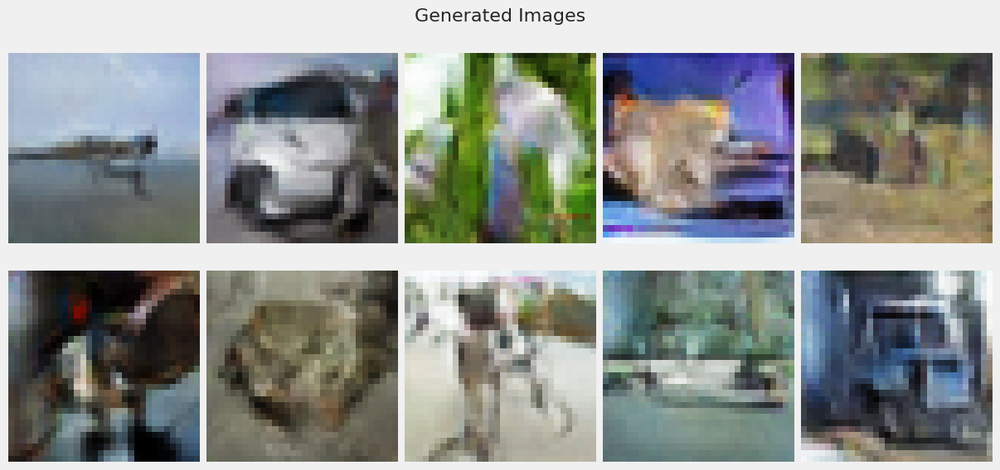

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1018 - d_fake_loss: 0.1018 - g_loss: 6.6417 - d_acc: 0.9620 - d_realO: 0.0592 - d_fakeO: 0.9412 - lr: 9.0000e-05
Epoch 92/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.0978 - d_fake_loss: 0.0978 - g_loss: 6.7738 - d_acc: 0.9641 - d_realO: 0.0568 - d_fakeO: 0.9440 - lr: 9.1000e-05
Epoch 93/100
782/782 [==============================] - 8s 11ms/step - d_real_loss: 0.1008 - d_fake_loss: 0.1008 - g_loss: 6.7393 - d_acc: 0.9623 - d_realO: 0.0582 - d_fakeO: 0.9421 - lr: 9.2000e-05
Epoch 94/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.0963 - d_fake_loss: 0.0963 - g_loss: 6.8372 - d_acc: 0.9643 - d_realO: 0.0560 - d_fakeO: 0.9444 - lr: 9.3000e-05
Epoch 95/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.0959 - d_fake_loss: 0.0959 - g_loss: 6.8192 - d_acc: 0.9641 - d_realO: 0.0553 - d_fakeO: 0.9449 - lr: 9.4000e-05
Epoch 96/100
782/7

In [74]:
gan_7 = train_gan(discriminator_cgan1, generator_cgan1, noise, 'CosineDecay CGAN 1', dataset_s, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  96% accuracy
- No model collapse


</div>

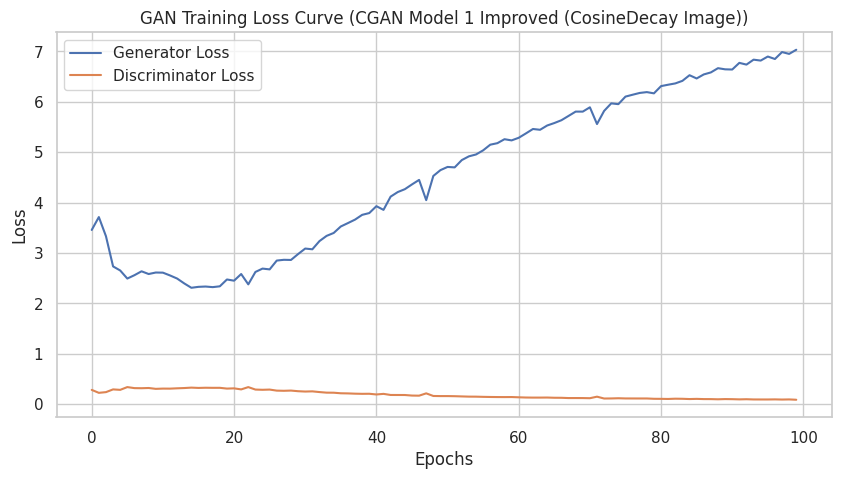

In [89]:
gan_history_7 = gan_7[0].history
generator = gan_7[1].generator  
gan_history_7['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_7['d_real_loss'], gan_history_7['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_7, title='GAN Training Loss Curve (CGAN Model 1 Improved (CosineDecay Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [76]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 33.190419004014686
KID Score: 0.02030653347494793


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 33
- KID Score is 0.04
INo mprovement seen over baseline model

</div>

4/4 [==============================] - 0s 2ms/step
Class 0 - 100 Generated Images


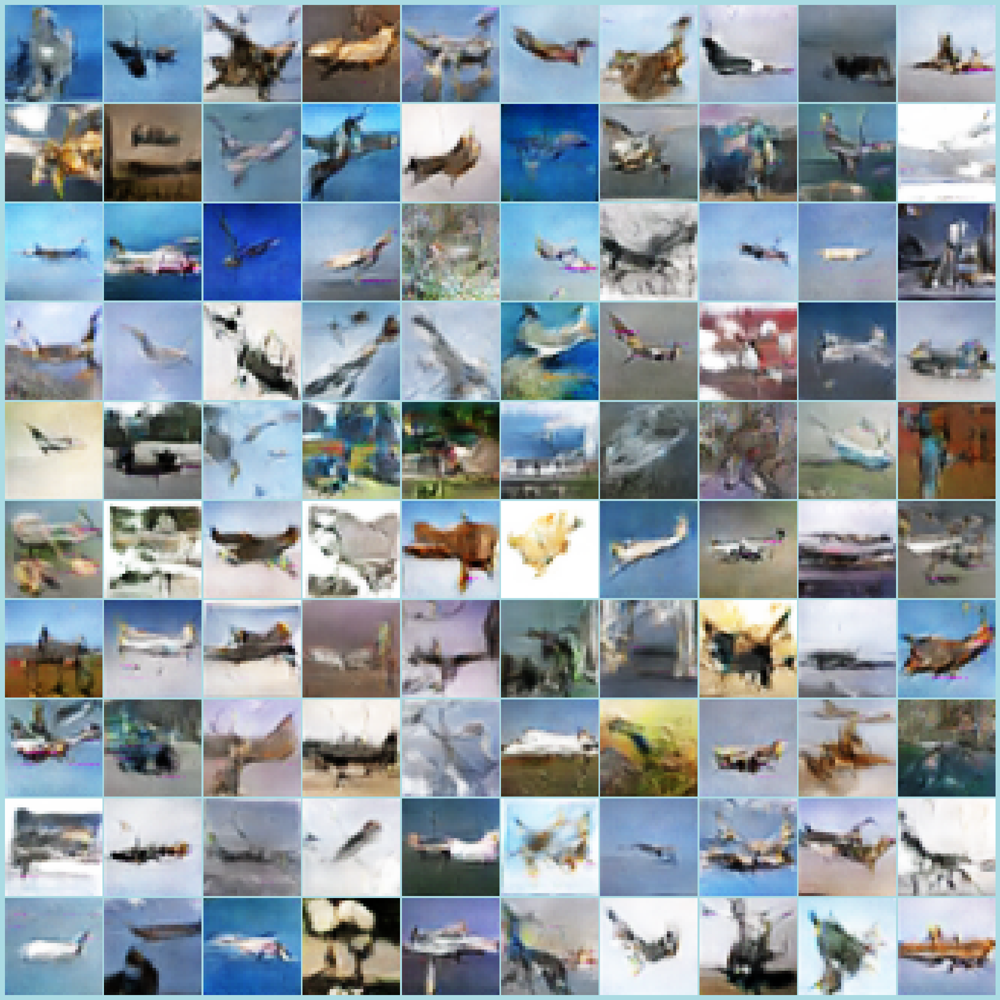

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


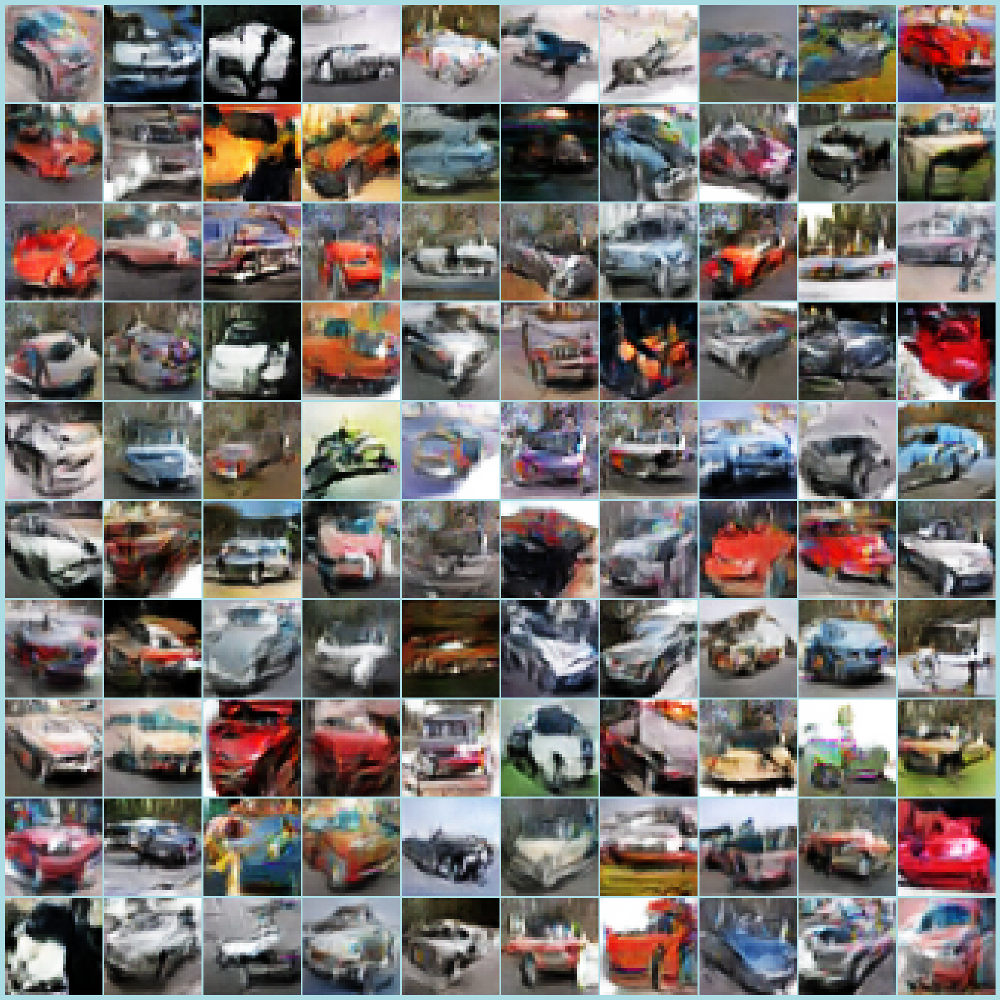

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


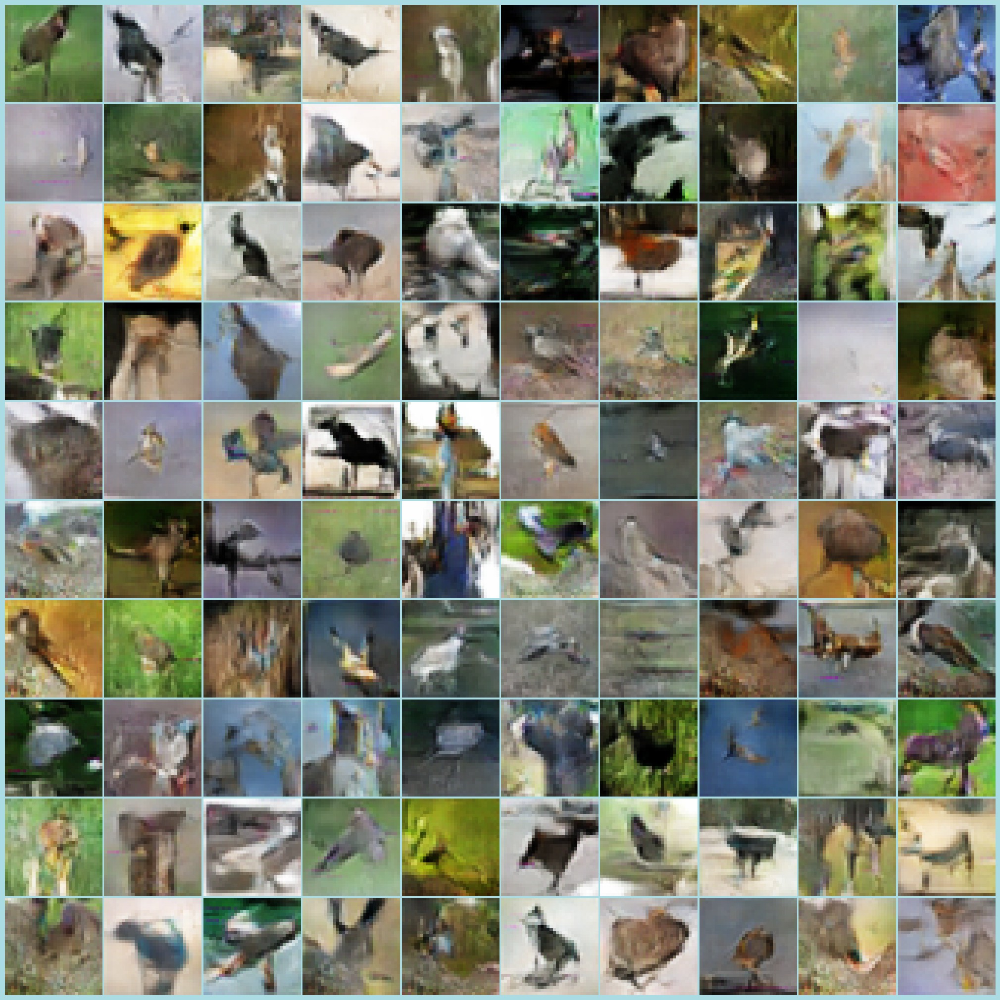

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


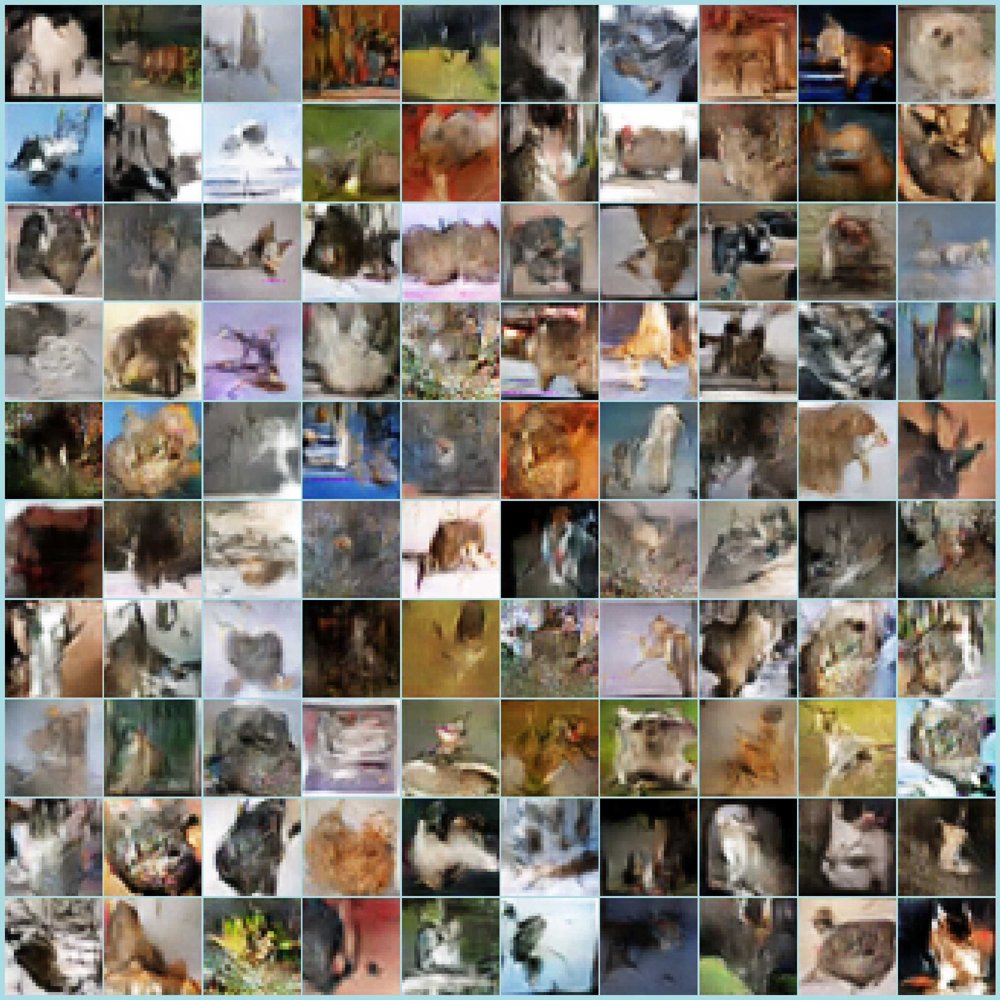

4/4 [==============================] - 0s 1ms/step
Class 4 - 100 Generated Images


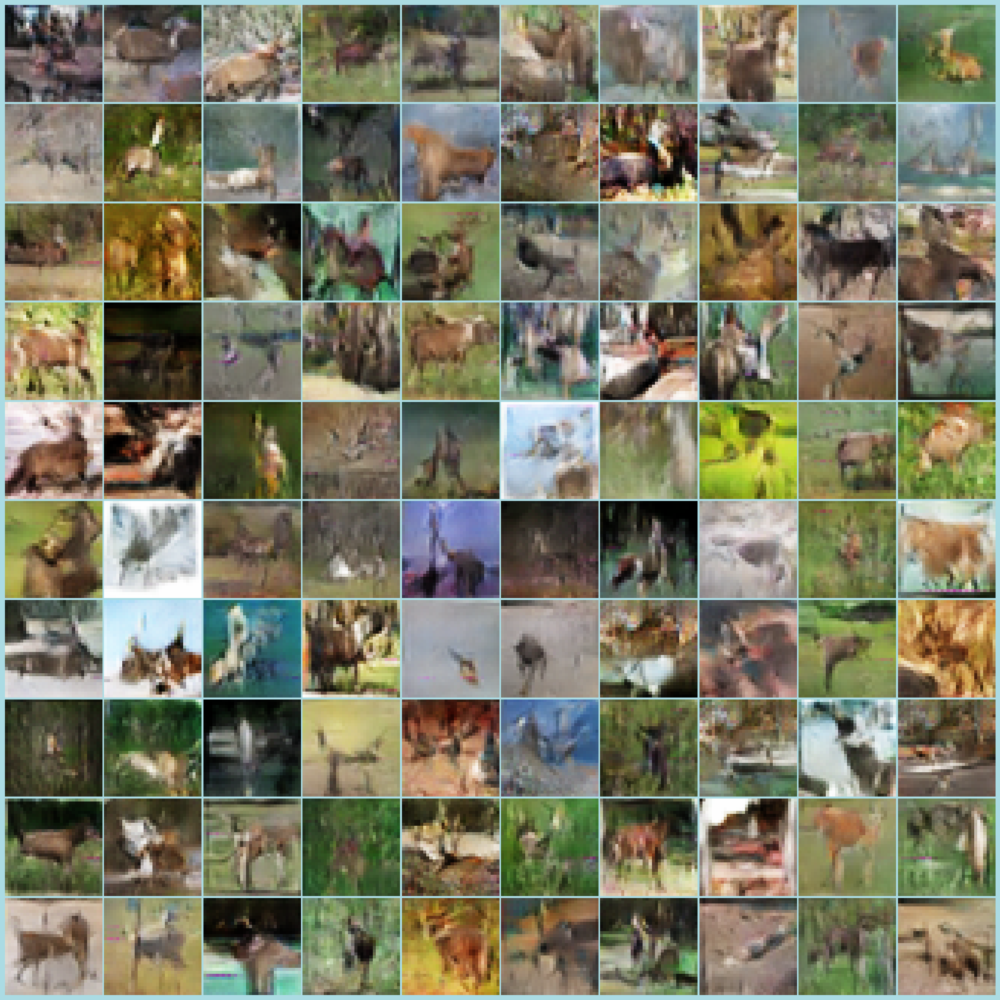

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


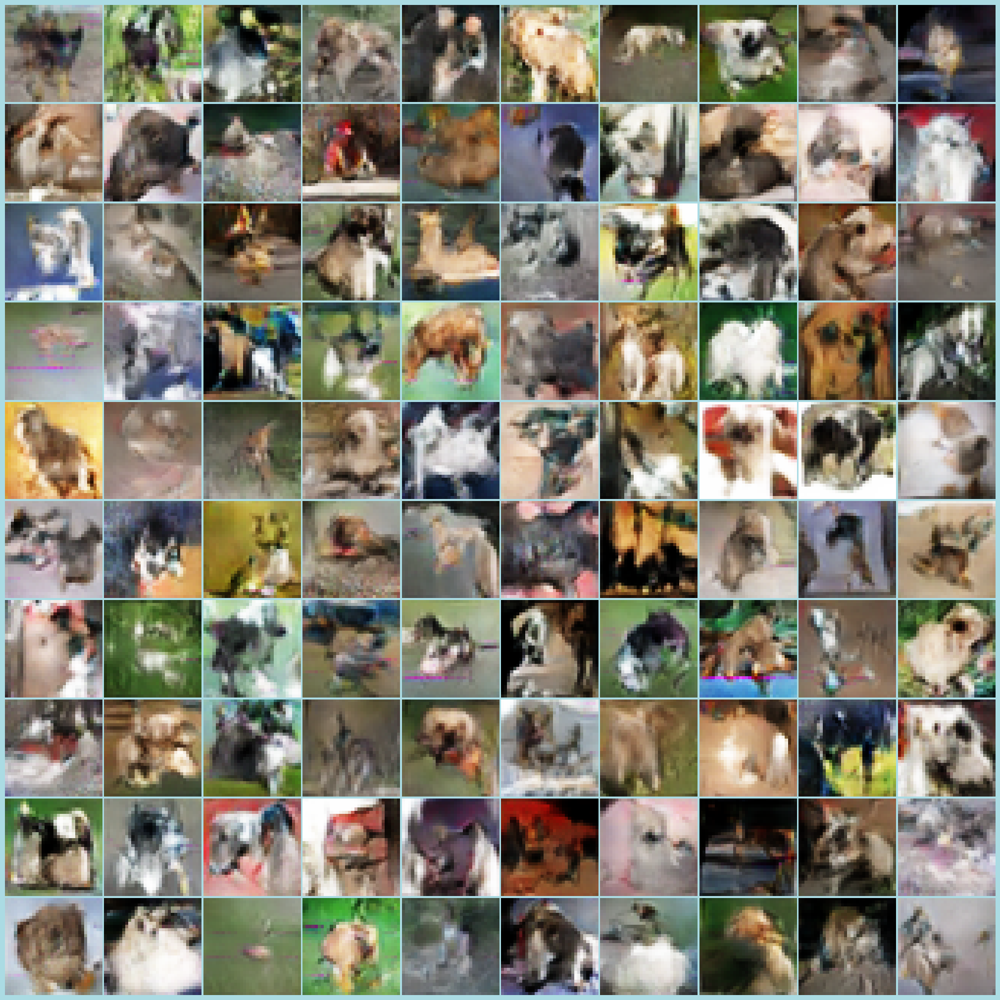

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


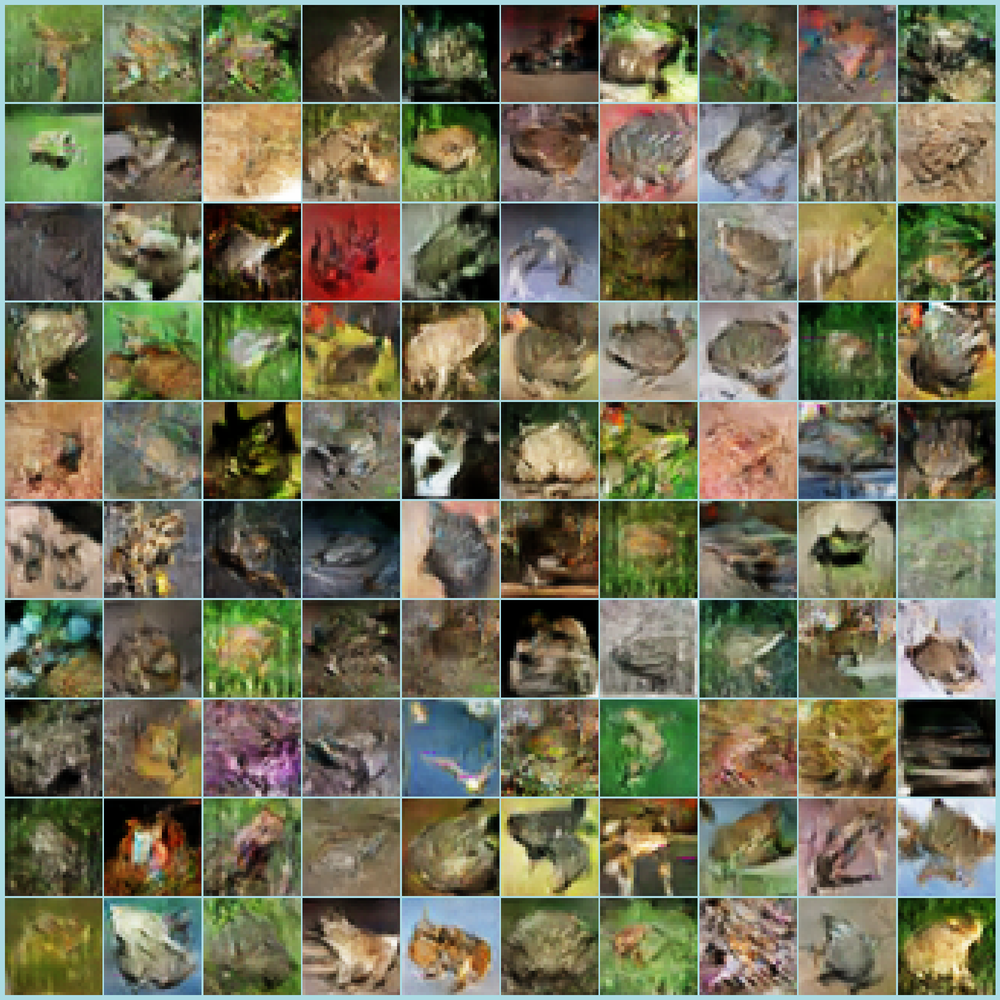

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


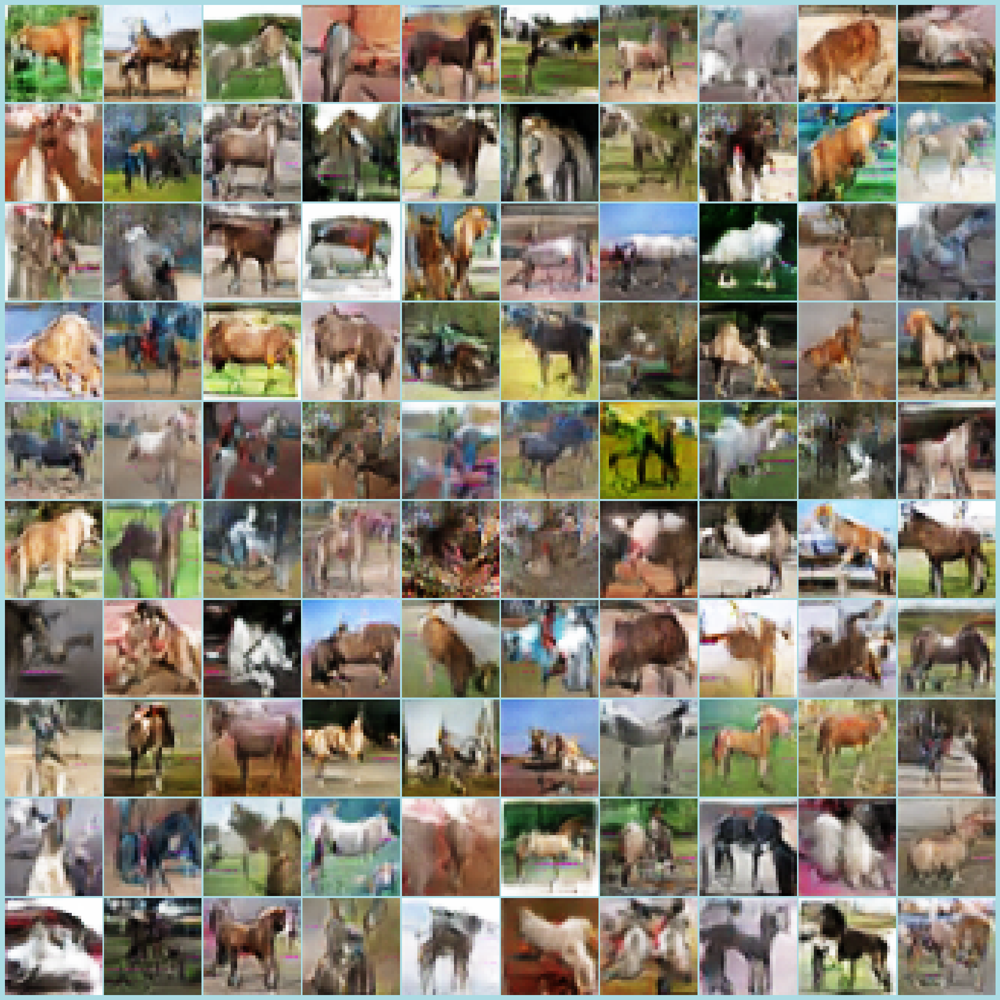

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


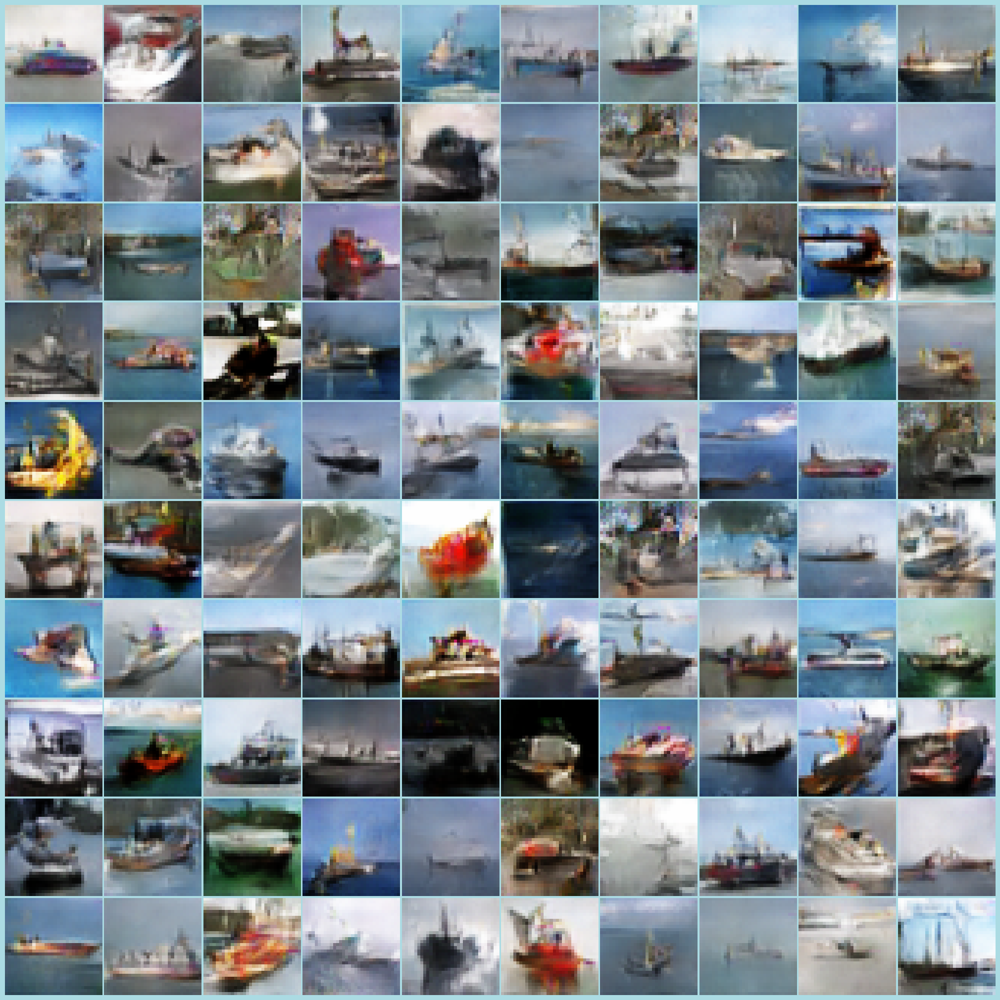

4/4 [==============================] - 0s 1ms/step
Class 9 - 100 Generated Images


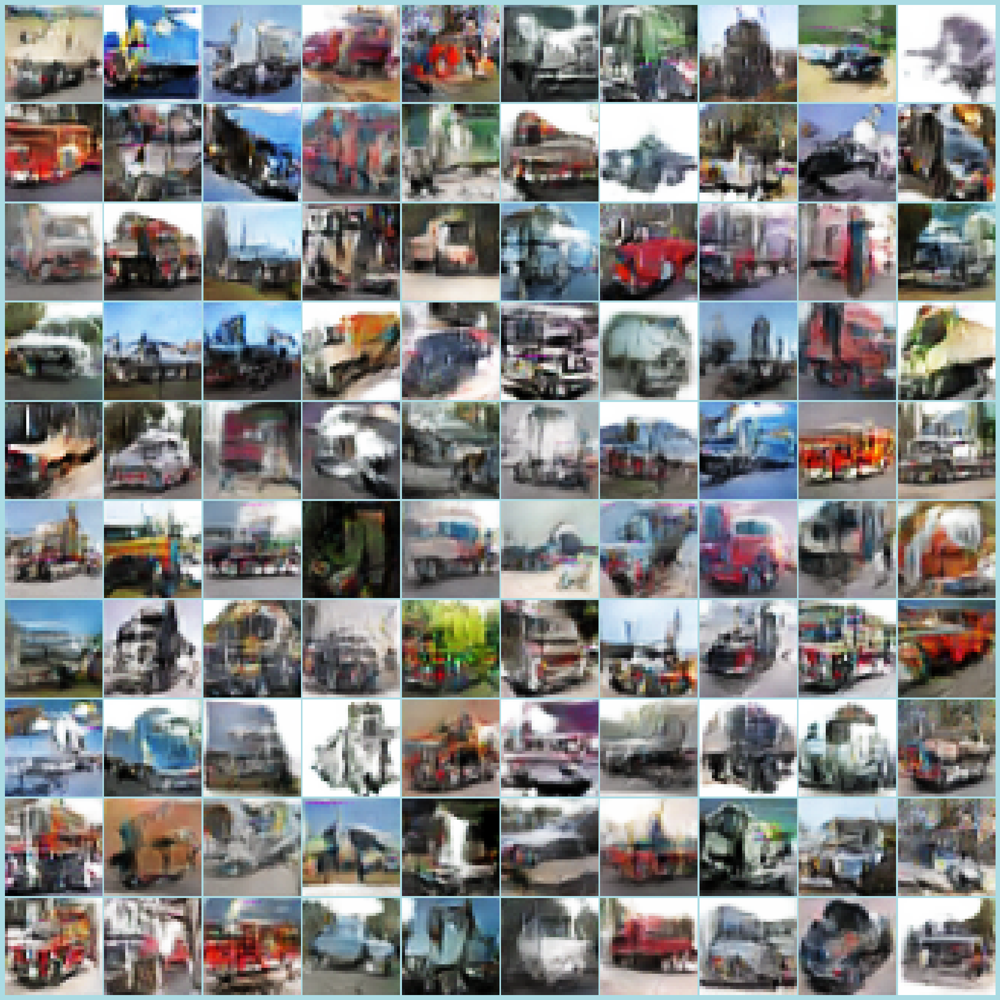

In [77]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Images are clear and able to tell the results

</div>

In [86]:
new_row = {'Model':'CosineDecay CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_7['d_loss'][-1], 'g_loss':gan_history_7['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,2.167156e-02,0.105153,6.727473
1,Sharpened Image CGAN 1,680924.469492,3.372896e+07,0.105472,6.766756
2,CutMix Image CGAN 1,91.519452,7.159536e-02,0.109868,4.574687
3,Oversample Image CGAN 1,32.972425,2.073221e-02,0.109868,4.574687
4,CosineDecay CGAN 1,32.555592,1.869066e-02,0.090373,7.033971


### Exponential Decay Scheduler

### __Key Ideas__
1. Exponential decay reduces the learning rate exponentially where the rate is decreasing at a exponential rate
2. Very useful incases where one wants to rapidly decrease the learning rate
3. Learning rate is a fraction of the previous learning rate here

In [78]:
def exponential_decay_scheduler(initial_lr=0.001, decay_rate=0.96, decay_steps=100000):
    def scheduler(epoch, lr):
        return initial_lr * decay_rate ** (epoch / decay_steps)
    return tf.keras.callbacks.LearningRateScheduler(scheduler)

In [79]:
discriminator_cgan1 = build_discriminator()
generator_cgan1 = build_generator(128)

In [80]:
lr_scheduler = exponential_decay_scheduler()
callbacks.append(lr_scheduler)

Epoch 1/100
778/782 [============================>.] - ETA: 0s - d_real_loss: 0.2711 - d_fake_loss: 0.2711 - g_loss: 3.2519 - d_acc: 0.9067 - d_realO: 0.1633 - d_fakeO: 0.8528

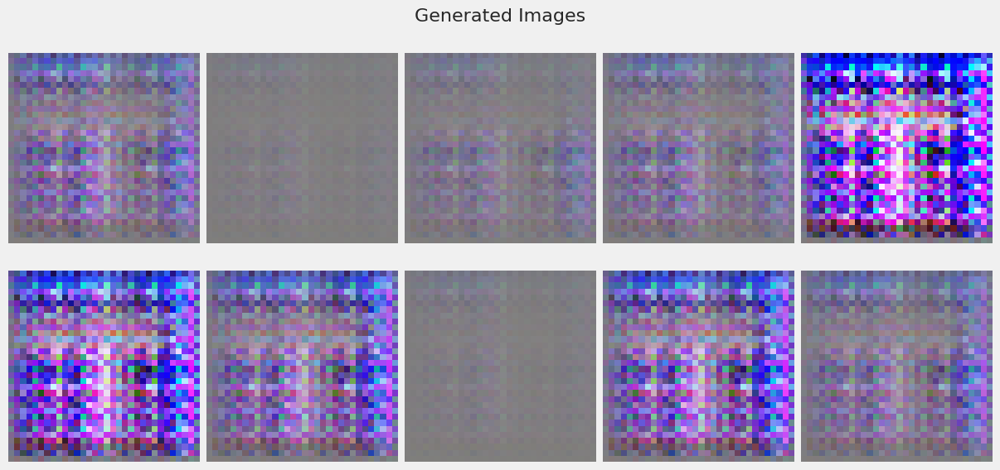

782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.2725 - d_fake_loss: 0.2725 - g_loss: 3.2574 - d_acc: 0.9062 - d_realO: 0.1635 - d_fakeO: 0.8518 - lr: 0.0010
Epoch 2/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2736 - d_fake_loss: 0.2736 - g_loss: 3.2542 - d_acc: 0.9009 - d_realO: 0.1588 - d_fakeO: 0.8376 - lr: 1.0000e-03
Epoch 3/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2927 - d_fake_loss: 0.2927 - g_loss: 2.6732 - d_acc: 0.8854 - d_realO: 0.1858 - d_fakeO: 0.8178 - lr: 1.0000e-03
Epoch 4/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2658 - d_fake_loss: 0.2658 - g_loss: 2.9021 - d_acc: 0.8985 - d_realO: 0.1675 - d_fakeO: 0.8377 - lr: 1.0000e-03
Epoch 5/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2666 - d_fake_loss: 0.2666 - g_loss: 3.0085 - d_acc: 0.8930 - d_realO: 0.1656 - d_fakeO: 0.8370 - lr: 1.0000e-03
Epoch 6/100
782/782 [====

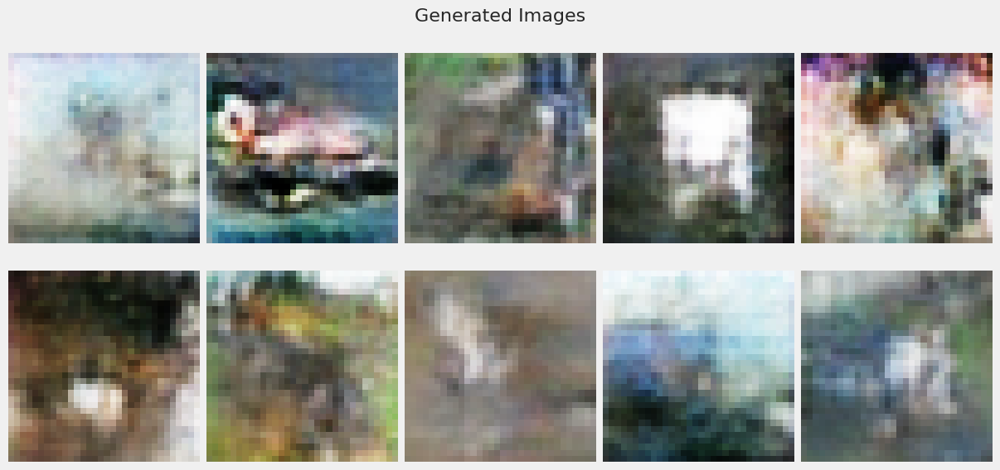

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2878 - d_fake_loss: 0.2878 - g_loss: 2.7999 - d_acc: 0.8781 - d_realO: 0.1813 - d_fakeO: 0.8188 - lr: 1.0000e-03
Epoch 12/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3054 - d_fake_loss: 0.3054 - g_loss: 2.6507 - d_acc: 0.8697 - d_realO: 0.1925 - d_fakeO: 0.8079 - lr: 1.0000e-03
Epoch 13/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3075 - d_fake_loss: 0.3075 - g_loss: 2.6082 - d_acc: 0.8673 - d_realO: 0.1958 - d_fakeO: 0.8046 - lr: 1.0000e-03
Epoch 14/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3239 - d_fake_loss: 0.3239 - g_loss: 2.4703 - d_acc: 0.8584 - d_realO: 0.2059 - d_fakeO: 0.7935 - lr: 9.9999e-04
Epoch 15/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.3305 - d_fake_loss: 0.3305 - g_loss: 2.4079 - d_acc: 0.8549 - d_realO: 0.2128 - d_fakeO: 0.7882 - lr: 9.9999e-04
Epoch 16/100
782/7

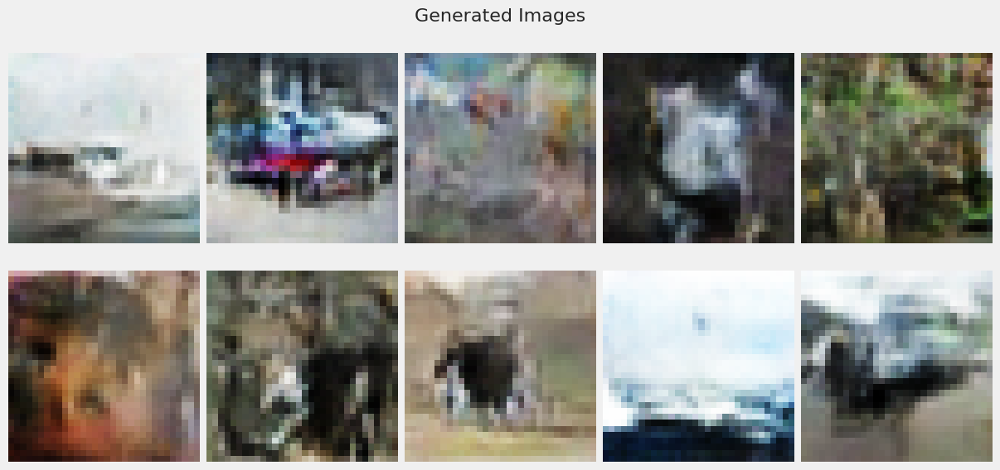

782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2931 - d_fake_loss: 0.2931 - g_loss: 2.5947 - d_acc: 0.8744 - d_realO: 0.1875 - d_fakeO: 0.8132 - lr: 9.9999e-04
Epoch 22/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2855 - d_fake_loss: 0.2855 - g_loss: 2.6648 - d_acc: 0.8772 - d_realO: 0.1822 - d_fakeO: 0.8188 - lr: 9.9999e-04
Epoch 23/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2873 - d_fake_loss: 0.2873 - g_loss: 2.6954 - d_acc: 0.8749 - d_realO: 0.1830 - d_fakeO: 0.8180 - lr: 9.9999e-04
Epoch 24/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2801 - d_fake_loss: 0.2801 - g_loss: 2.7504 - d_acc: 0.8804 - d_realO: 0.1785 - d_fakeO: 0.8226 - lr: 9.9999e-04
Epoch 25/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2849 - d_fake_loss: 0.2849 - g_loss: 2.7283 - d_acc: 0.8790 - d_realO: 0.1799 - d_fakeO: 0.8206 - lr: 9.9999e-04
Epoch 26/100
782/7

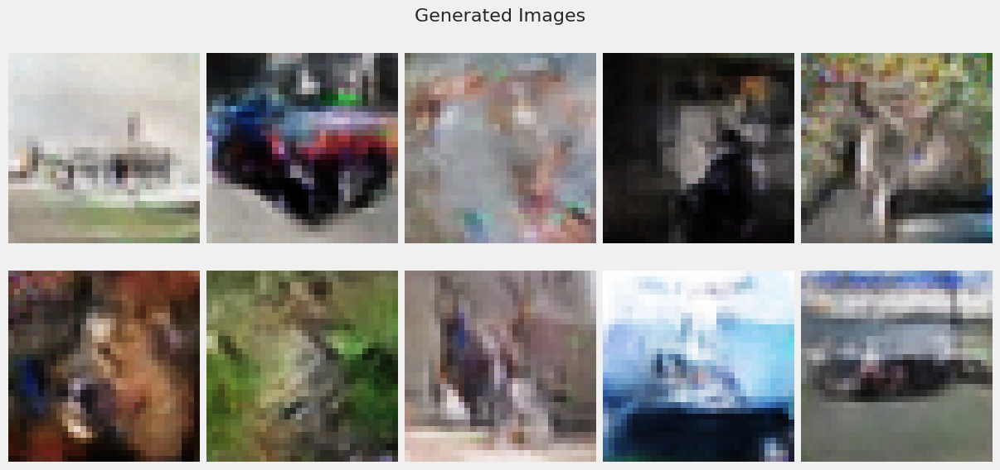

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.2470 - d_fake_loss: 0.2470 - g_loss: 3.1685 - d_acc: 0.8955 - d_realO: 0.1553 - d_fakeO: 0.8443 - lr: 9.9999e-04
Epoch 32/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2322 - d_fake_loss: 0.2322 - g_loss: 3.3369 - d_acc: 0.9025 - d_realO: 0.1468 - d_fakeO: 0.8536 - lr: 9.9999e-04
Epoch 33/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2366 - d_fake_loss: 0.2366 - g_loss: 3.3325 - d_acc: 0.9022 - d_realO: 0.1480 - d_fakeO: 0.8529 - lr: 9.9999e-04
Epoch 34/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2236 - d_fake_loss: 0.2236 - g_loss: 3.4601 - d_acc: 0.9076 - d_realO: 0.1412 - d_fakeO: 0.8594 - lr: 9.9999e-04
Epoch 35/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2154 - d_fake_loss: 0.2154 - g_loss: 3.5893 - d_acc: 0.9112 - d_realO: 0.1357 - d_fakeO: 0.8647 - lr: 9.9999e-04
Epoch 36/100
782/7

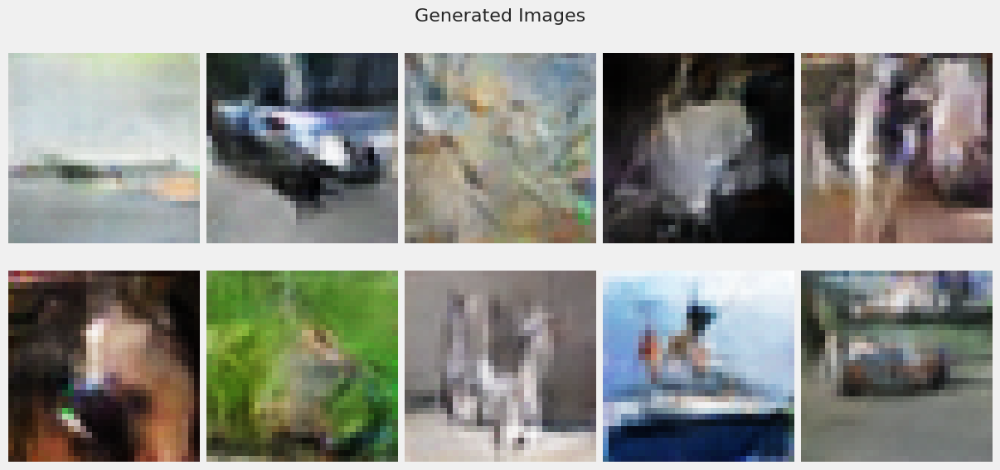

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1956 - d_fake_loss: 0.1956 - g_loss: 4.0120 - d_acc: 0.9209 - d_realO: 0.1215 - d_fakeO: 0.8789 - lr: 9.9998e-04
Epoch 42/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.2007 - d_fake_loss: 0.2007 - g_loss: 4.0076 - d_acc: 0.9196 - d_realO: 0.1228 - d_fakeO: 0.8777 - lr: 9.9998e-04
Epoch 43/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1913 - d_fake_loss: 0.1913 - g_loss: 4.0103 - d_acc: 0.9228 - d_realO: 0.1191 - d_fakeO: 0.8809 - lr: 9.9998e-04
Epoch 44/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1863 - d_fake_loss: 0.1863 - g_loss: 4.1682 - d_acc: 0.9257 - d_realO: 0.1154 - d_fakeO: 0.8850 - lr: 9.9998e-04
Epoch 45/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1856 - d_fake_loss: 0.1856 - g_loss: 4.2505 - d_acc: 0.9256 - d_realO: 0.1146 - d_fakeO: 0.8859 - lr: 9.9998e-04
Epoch 46/100
782/7

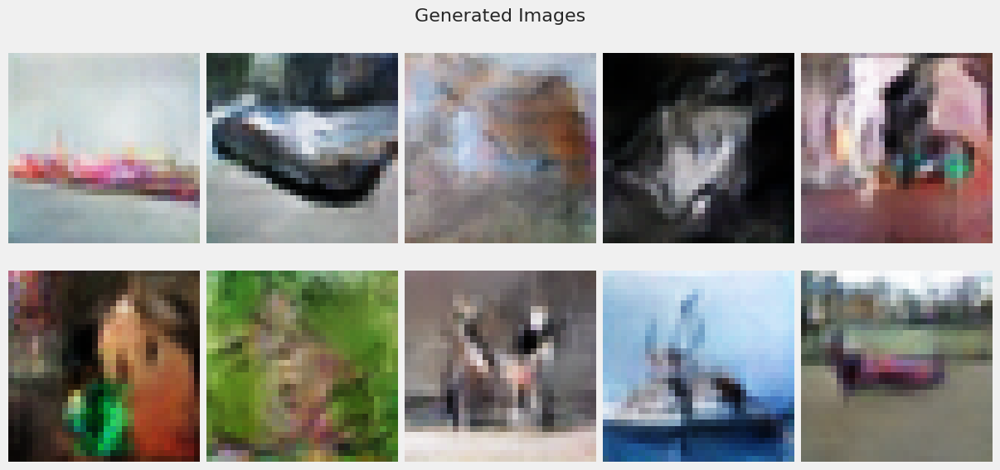

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1699 - d_fake_loss: 0.1699 - g_loss: 4.6493 - d_acc: 0.9321 - d_realO: 0.1042 - d_fakeO: 0.8963 - lr: 9.9998e-04
Epoch 52/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1675 - d_fake_loss: 0.1675 - g_loss: 4.6713 - d_acc: 0.9340 - d_realO: 0.1018 - d_fakeO: 0.8983 - lr: 9.9998e-04
Epoch 53/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1697 - d_fake_loss: 0.1697 - g_loss: 4.6956 - d_acc: 0.9326 - d_realO: 0.1035 - d_fakeO: 0.8969 - lr: 9.9998e-04
Epoch 54/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1683 - d_fake_loss: 0.1683 - g_loss: 4.7326 - d_acc: 0.9327 - d_realO: 0.1024 - d_fakeO: 0.8980 - lr: 9.9998e-04
Epoch 55/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1674 - d_fake_loss: 0.1674 - g_loss: 4.7842 - d_acc: 0.9335 - d_realO: 0.1016 - d_fakeO: 0.8989 - lr: 9.9998e-04
Epoch 56/100
782/7

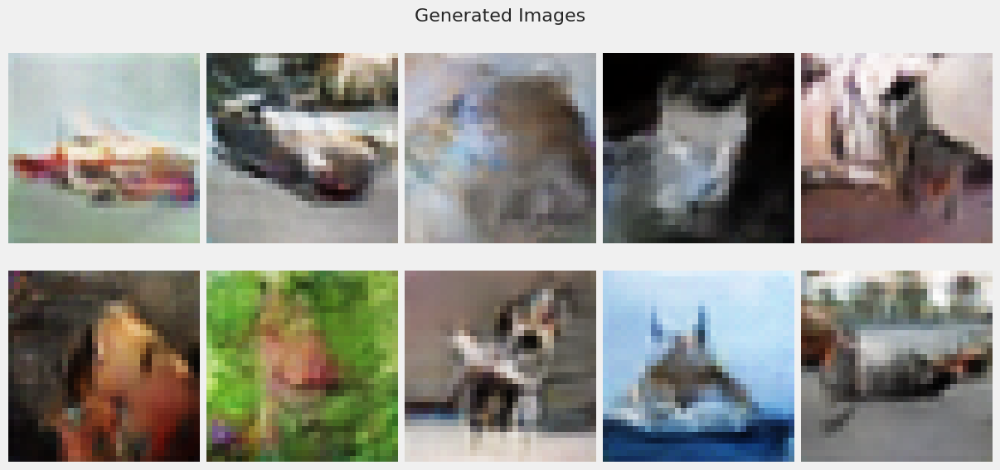

782/782 [==============================] - 10s 13ms/step - d_real_loss: 0.1582 - d_fake_loss: 0.1582 - g_loss: 5.0653 - d_acc: 0.9383 - d_realO: 0.0948 - d_fakeO: 0.9052 - lr: 9.9998e-04
Epoch 62/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1510 - d_fake_loss: 0.1510 - g_loss: 5.1512 - d_acc: 0.9409 - d_realO: 0.0915 - d_fakeO: 0.9091 - lr: 9.9998e-04
Epoch 63/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1530 - d_fake_loss: 0.1530 - g_loss: 5.1594 - d_acc: 0.9400 - d_realO: 0.0919 - d_fakeO: 0.9086 - lr: 9.9997e-04
Epoch 64/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1516 - d_fake_loss: 0.1516 - g_loss: 5.2328 - d_acc: 0.9400 - d_realO: 0.0917 - d_fakeO: 0.9089 - lr: 9.9997e-04
Epoch 65/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1513 - d_fake_loss: 0.1513 - g_loss: 5.2011 - d_acc: 0.9406 - d_realO: 0.0908 - d_fakeO: 0.9094 - lr: 9.9997e-04
Epoch 66/100
782/

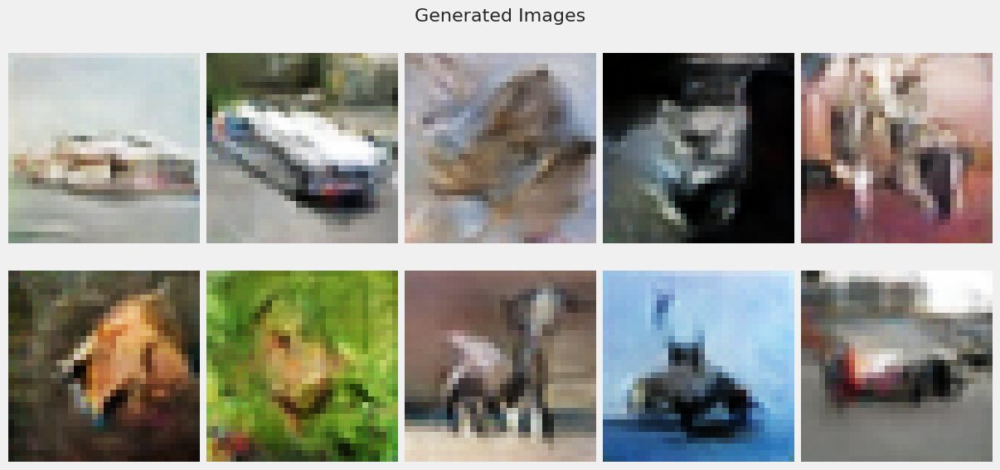

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1356 - d_fake_loss: 0.1356 - g_loss: 5.5642 - d_acc: 0.9478 - d_realO: 0.0809 - d_fakeO: 0.9193 - lr: 9.9997e-04
Epoch 72/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1359 - d_fake_loss: 0.1359 - g_loss: 5.5707 - d_acc: 0.9483 - d_realO: 0.0808 - d_fakeO: 0.9195 - lr: 9.9997e-04
Epoch 73/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1347 - d_fake_loss: 0.1347 - g_loss: 5.6371 - d_acc: 0.9483 - d_realO: 0.0805 - d_fakeO: 0.9198 - lr: 9.9997e-04
Epoch 74/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1343 - d_fake_loss: 0.1343 - g_loss: 5.7005 - d_acc: 0.9489 - d_realO: 0.0796 - d_fakeO: 0.9207 - lr: 9.9997e-04
Epoch 75/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1342 - d_fake_loss: 0.1342 - g_loss: 5.7327 - d_acc: 0.9483 - d_realO: 0.0797 - d_fakeO: 0.9210 - lr: 9.9997e-04
Epoch 76/100
782/7

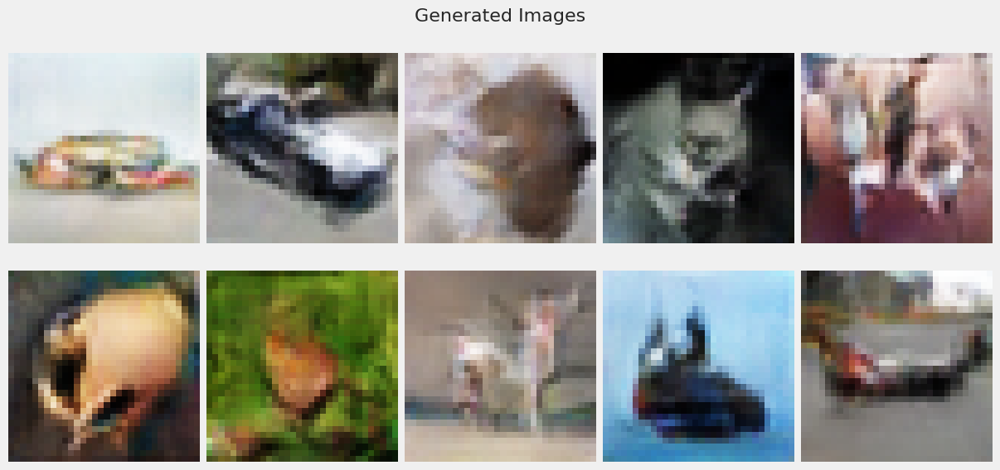

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1240 - d_fake_loss: 0.1240 - g_loss: 5.9767 - d_acc: 0.9531 - d_realO: 0.0738 - d_fakeO: 0.9270 - lr: 9.9997e-04
Epoch 82/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1261 - d_fake_loss: 0.1261 - g_loss: 5.9815 - d_acc: 0.9518 - d_realO: 0.0742 - d_fakeO: 0.9265 - lr: 9.9997e-04
Epoch 83/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1260 - d_fake_loss: 0.1260 - g_loss: 5.9784 - d_acc: 0.9520 - d_realO: 0.0741 - d_fakeO: 0.9261 - lr: 9.9997e-04
Epoch 84/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1207 - d_fake_loss: 0.1207 - g_loss: 6.0865 - d_acc: 0.9543 - d_realO: 0.0717 - d_fakeO: 0.9290 - lr: 9.9997e-04
Epoch 85/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1183 - d_fake_loss: 0.1183 - g_loss: 6.1307 - d_acc: 0.9558 - d_realO: 0.0699 - d_fakeO: 0.9305 - lr: 9.9997e-04
Epoch 86/100
782/7

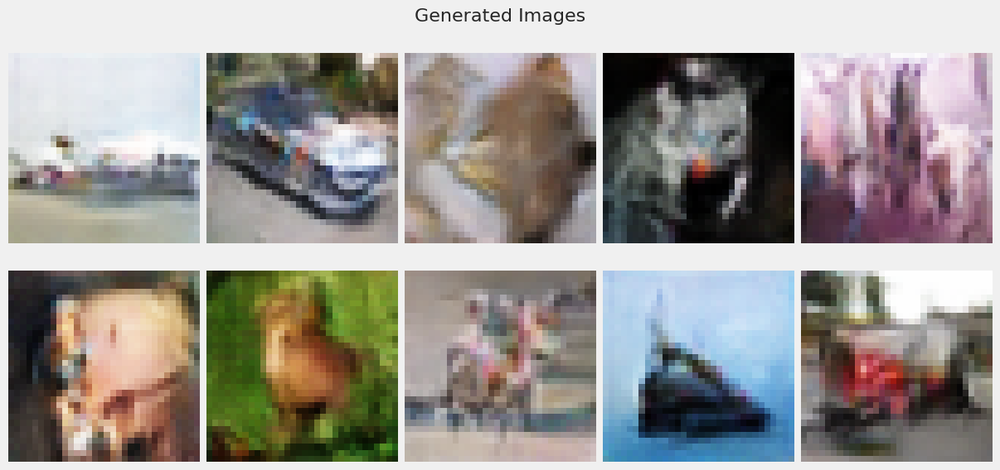

782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.1186 - d_fake_loss: 0.1186 - g_loss: 6.3764 - d_acc: 0.9550 - d_realO: 0.0692 - d_fakeO: 0.9316 - lr: 9.9996e-04
Epoch 92/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1165 - d_fake_loss: 0.1165 - g_loss: 6.3782 - d_acc: 0.9560 - d_realO: 0.0680 - d_fakeO: 0.9324 - lr: 9.9996e-04
Epoch 93/100
782/782 [==============================] - 8s 11ms/step - d_real_loss: 0.1128 - d_fake_loss: 0.1128 - g_loss: 6.4122 - d_acc: 0.9576 - d_realO: 0.0664 - d_fakeO: 0.9341 - lr: 9.9996e-04
Epoch 94/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1130 - d_fake_loss: 0.1130 - g_loss: 6.5127 - d_acc: 0.9568 - d_realO: 0.0664 - d_fakeO: 0.9338 - lr: 9.9996e-04
Epoch 95/100
782/782 [==============================] - 9s 11ms/step - d_real_loss: 0.1172 - d_fake_loss: 0.1172 - g_loss: 6.4401 - d_acc: 0.9555 - d_realO: 0.0679 - d_fakeO: 0.9323 - lr: 9.9996e-04
Epoch 96/100
782/7

In [81]:
gan_8 = train_gan(discriminator_cgan1, generator_cgan1, noise, 'ExponentialDecay CGAN 1', dataset_s, 110, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  96% accuracy
- No model collapse


</div>

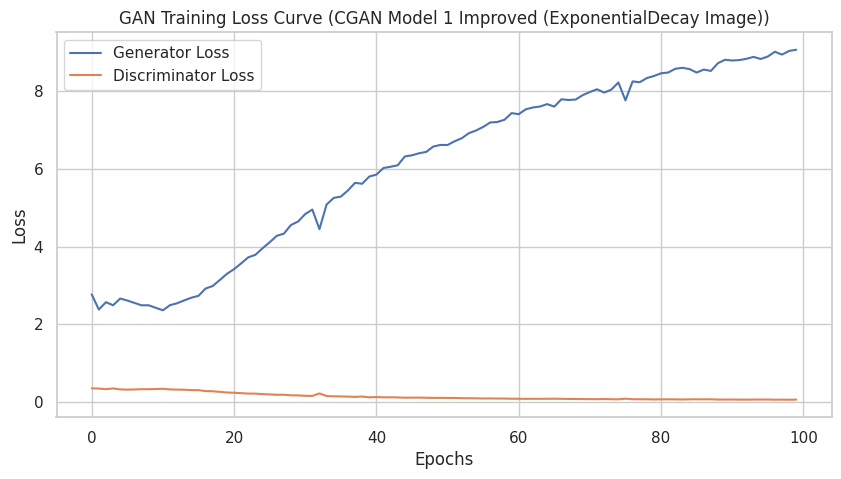

In [82]:
gan_history_8 = gan_8[0].history
generator = gan_8[1].generator  
gan_history_8['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_8['d_real_loss'], gan_history_8['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_5, title='GAN Training Loss Curve (CGAN Model 1 Improved (ExponentialDecay Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [83]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train, cgan=True)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

[0 0 0 ... 9 9 9]
313/313 [==============================] - 1s 2ms/step
FID Score: 32.55559177184398
KID Score: 0.01869065853472751


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 31
- KID Score is 0.01
Iprovement seen over baseline model

</div>

4/4 [==============================] - 0s 2ms/step
Class 0 - 100 Generated Images


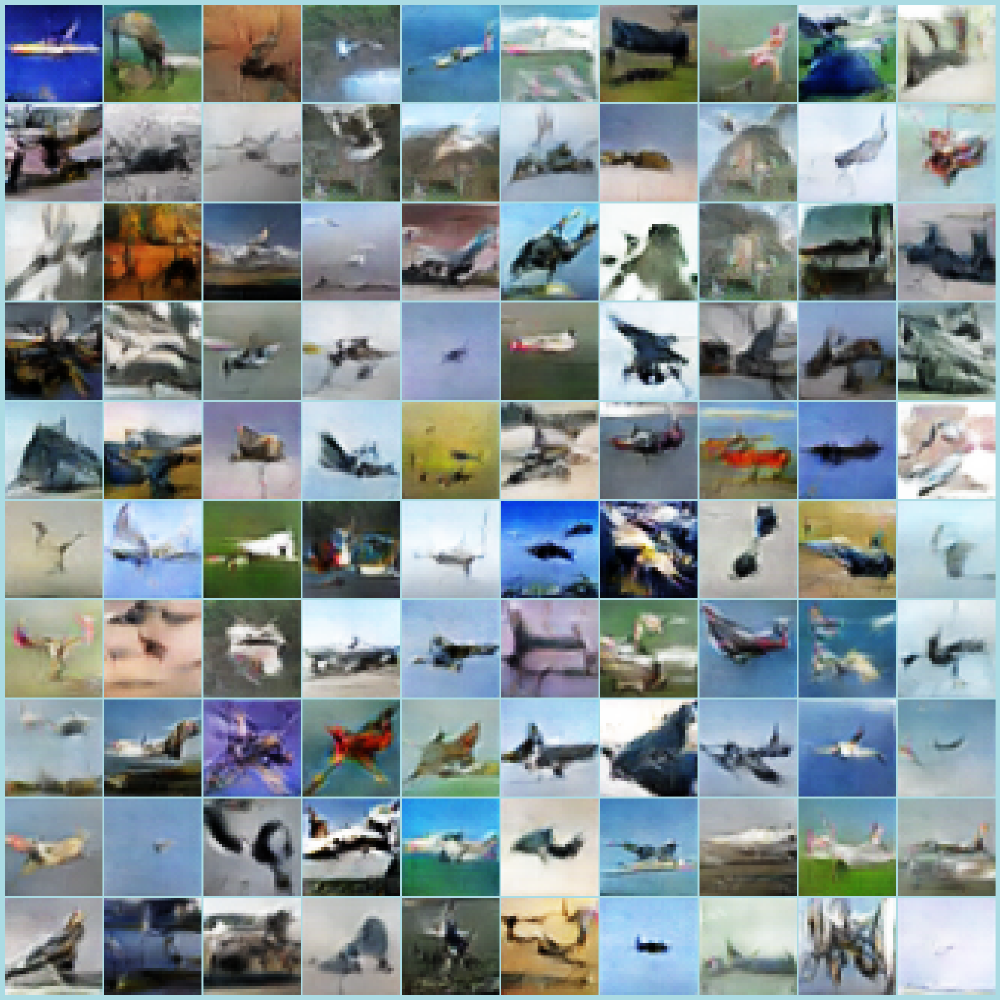

4/4 [==============================] - 0s 2ms/step
Class 1 - 100 Generated Images


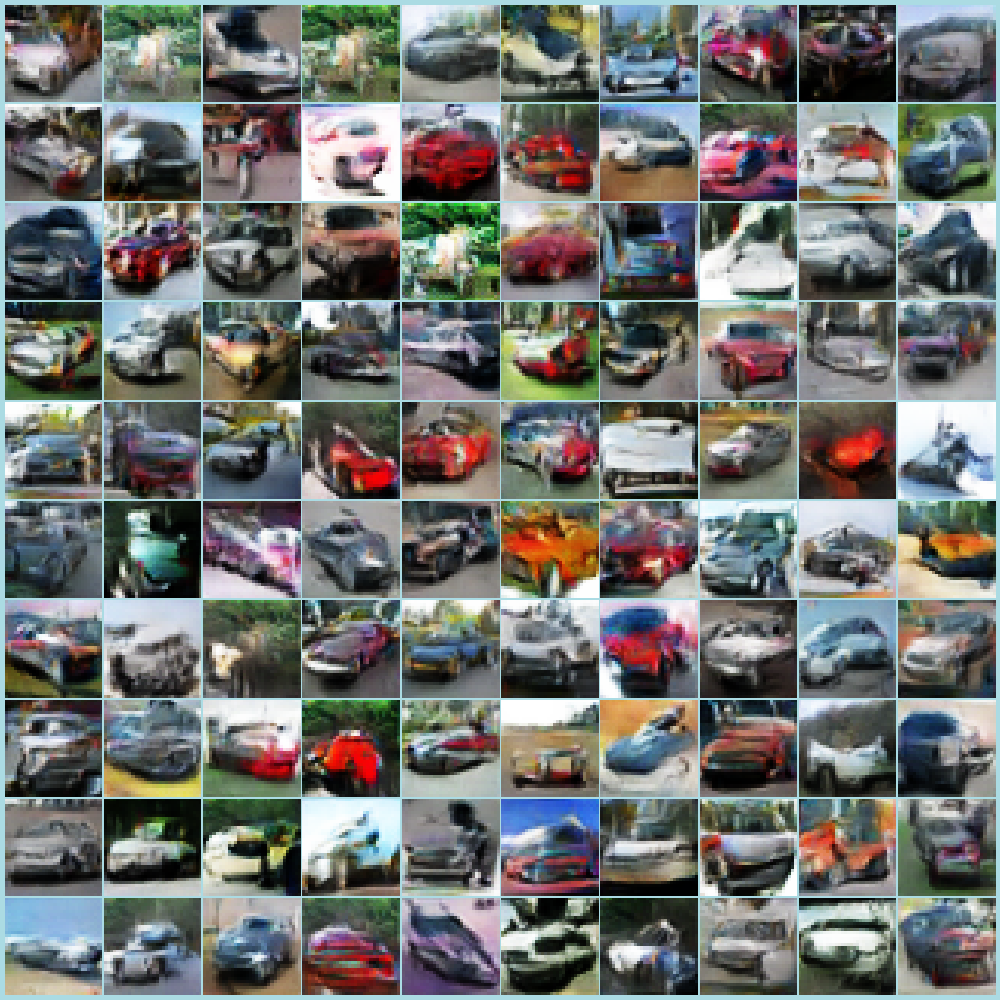

4/4 [==============================] - 0s 2ms/step
Class 2 - 100 Generated Images


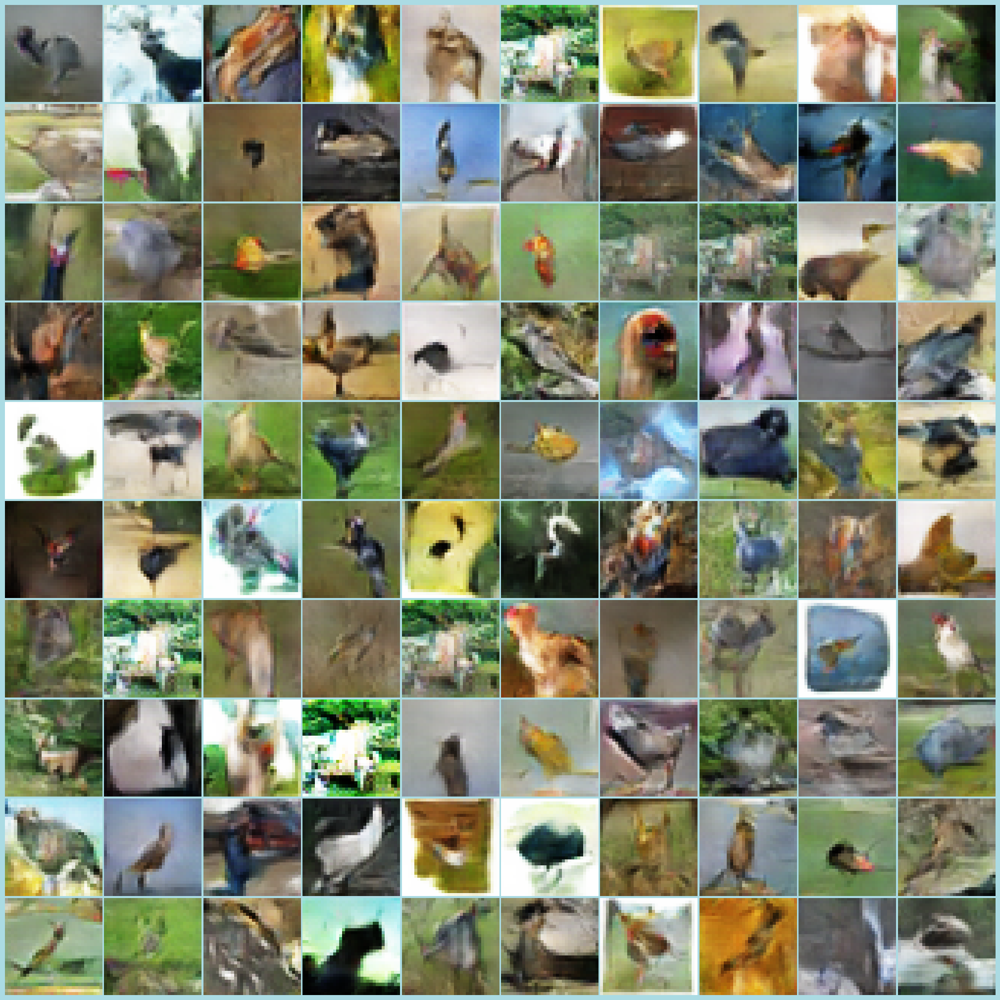

4/4 [==============================] - 0s 2ms/step
Class 3 - 100 Generated Images


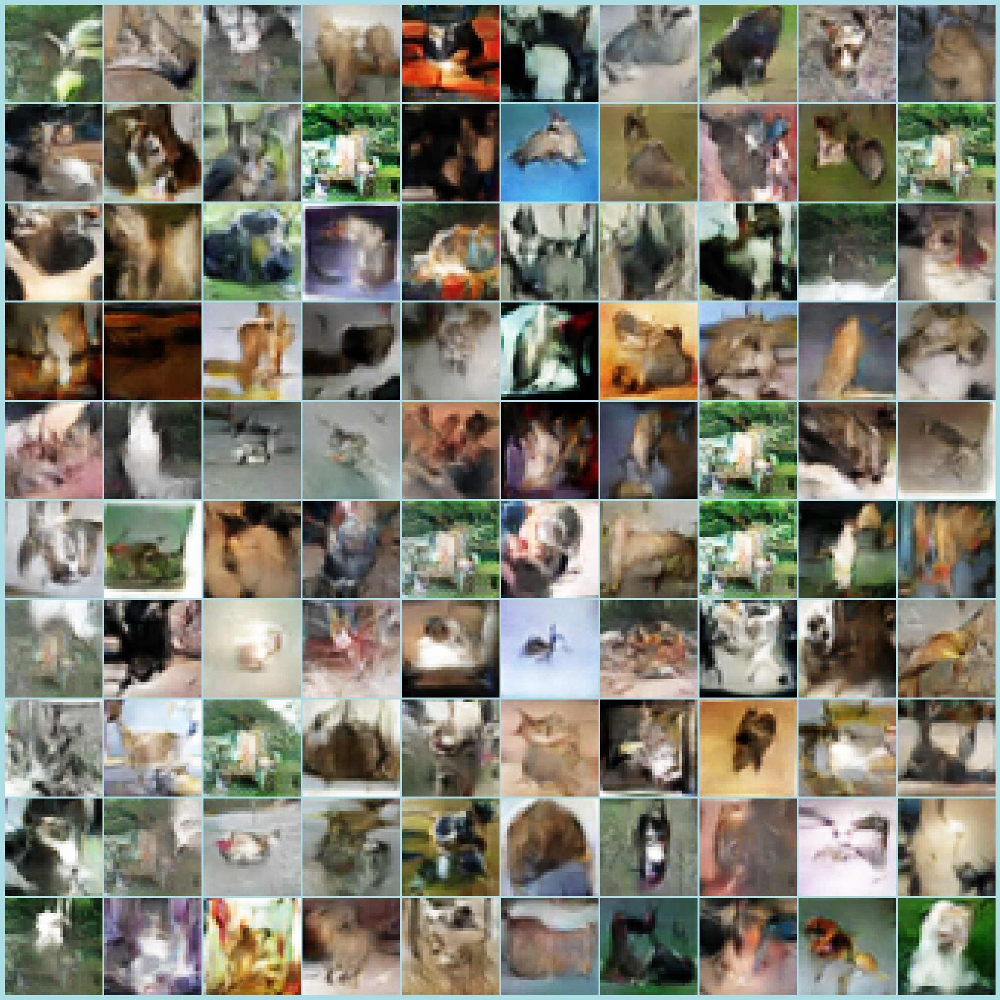

4/4 [==============================] - 0s 2ms/step
Class 4 - 100 Generated Images


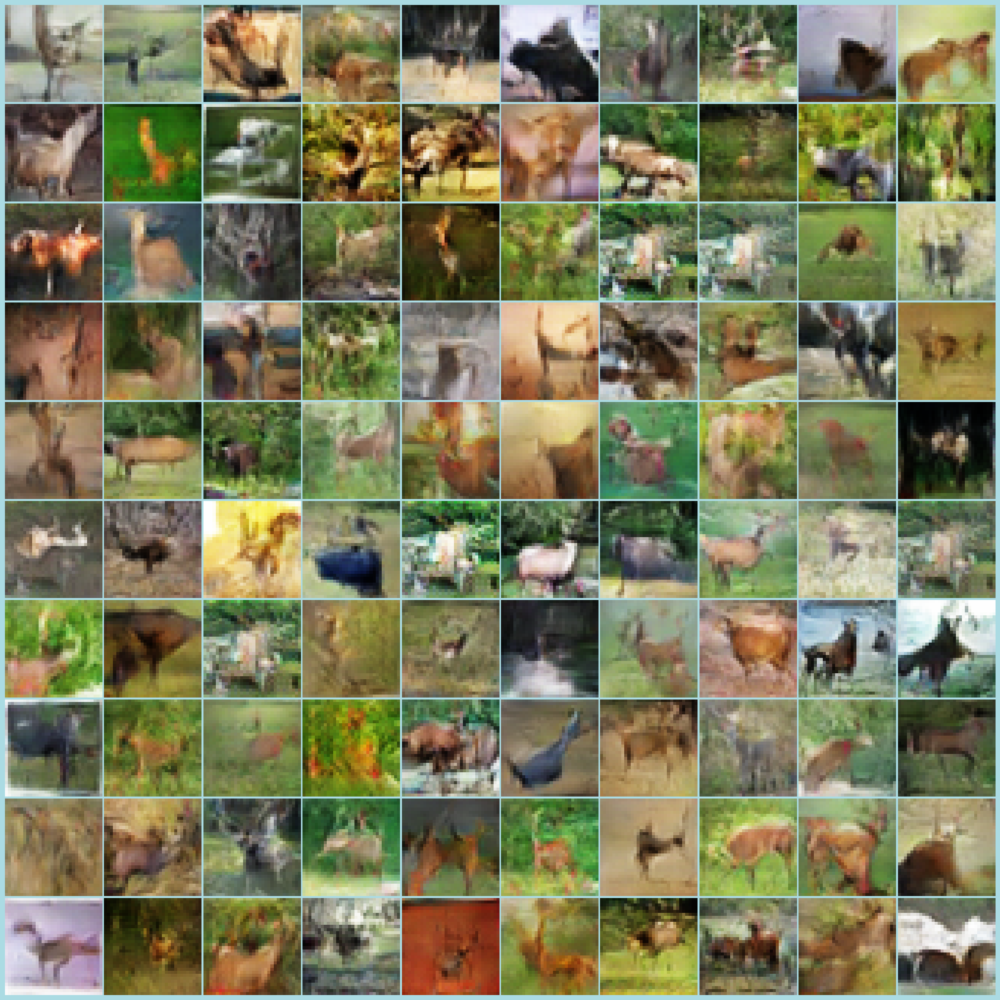

4/4 [==============================] - 0s 2ms/step
Class 5 - 100 Generated Images


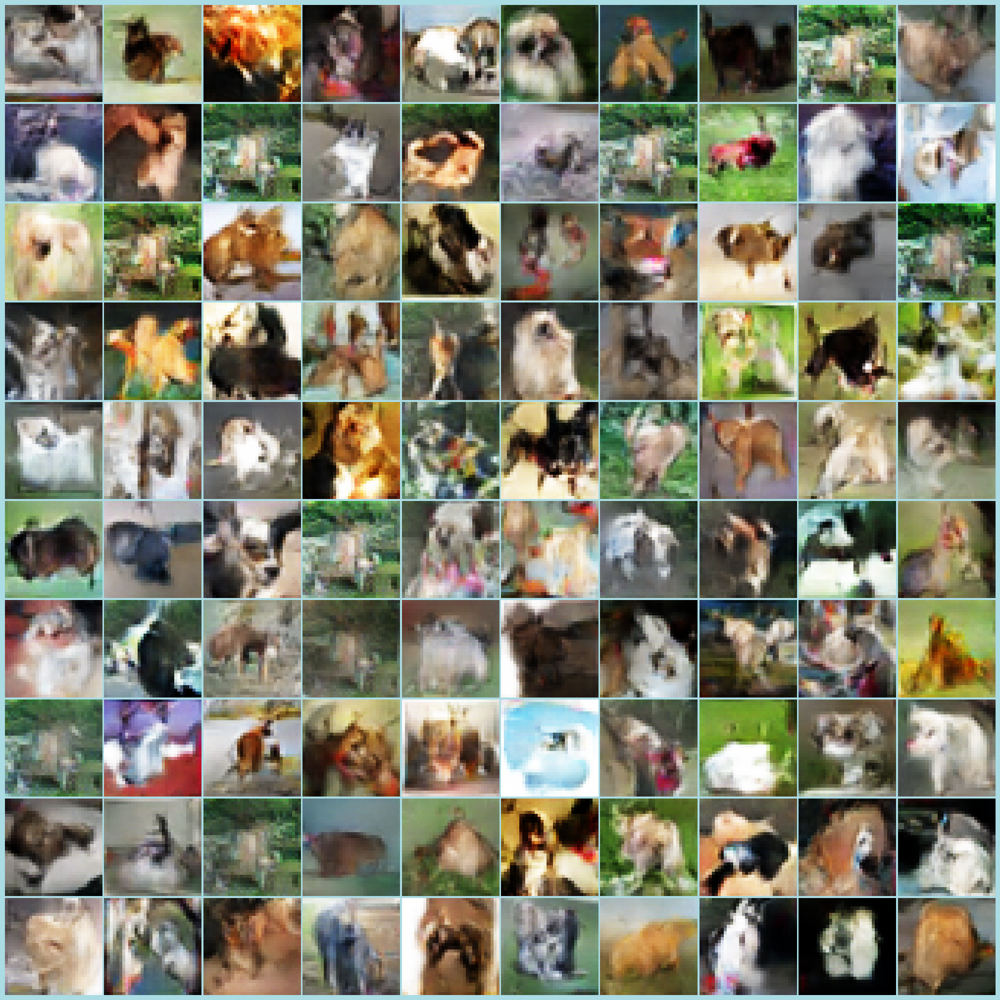

4/4 [==============================] - 0s 2ms/step
Class 6 - 100 Generated Images


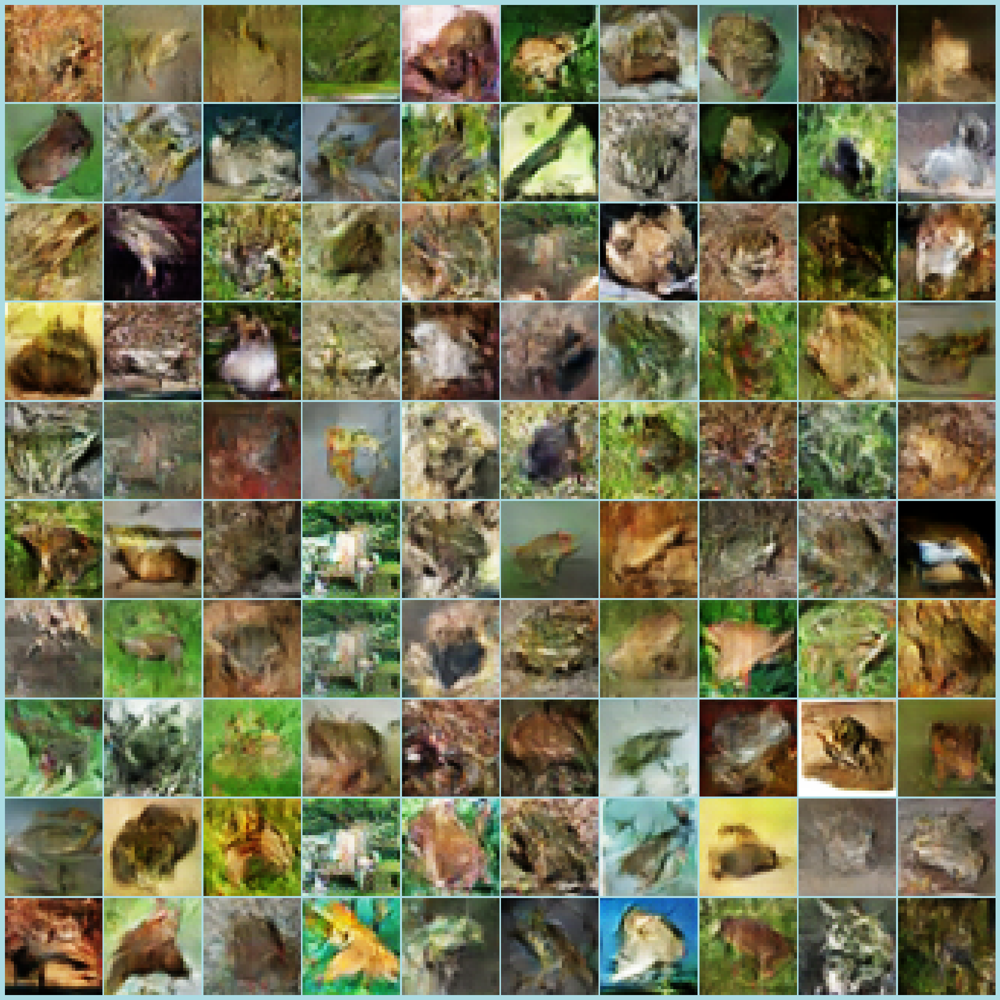

4/4 [==============================] - 0s 2ms/step
Class 7 - 100 Generated Images


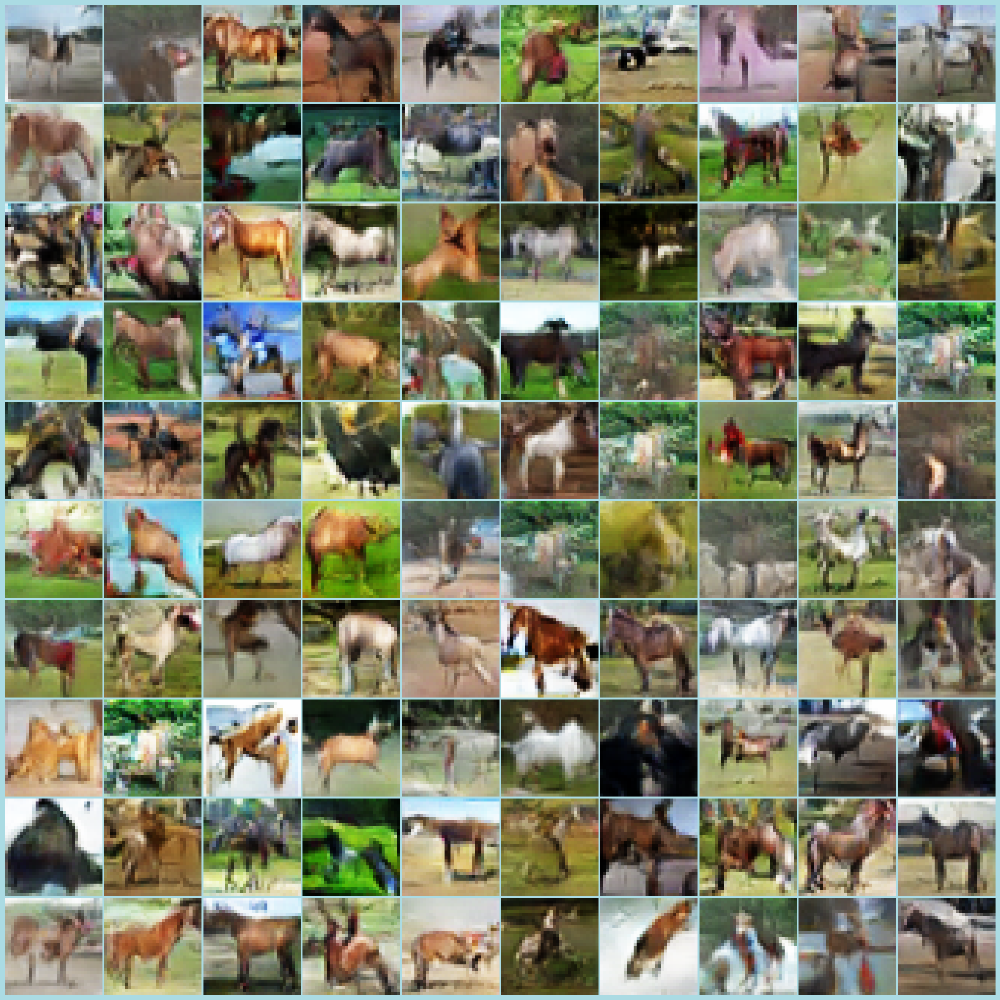

4/4 [==============================] - 0s 2ms/step
Class 8 - 100 Generated Images


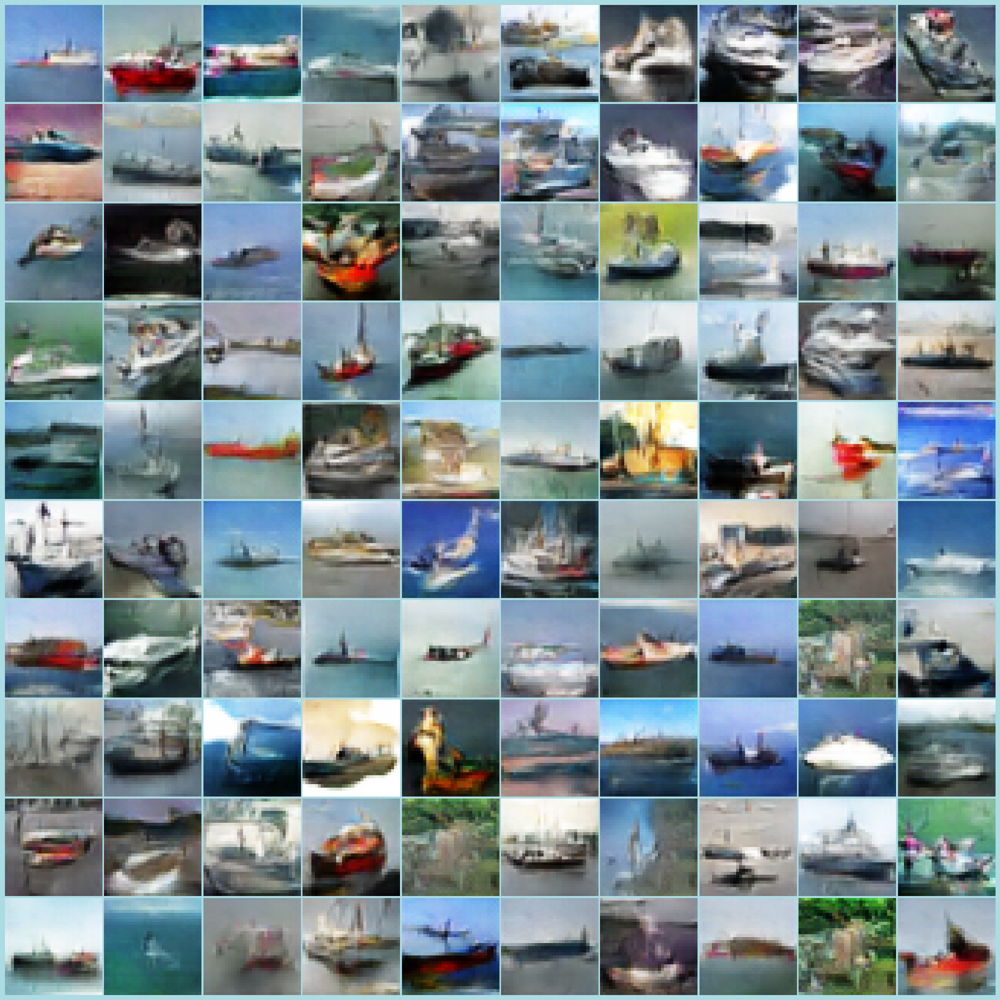

4/4 [==============================] - 0s 2ms/step
Class 9 - 100 Generated Images


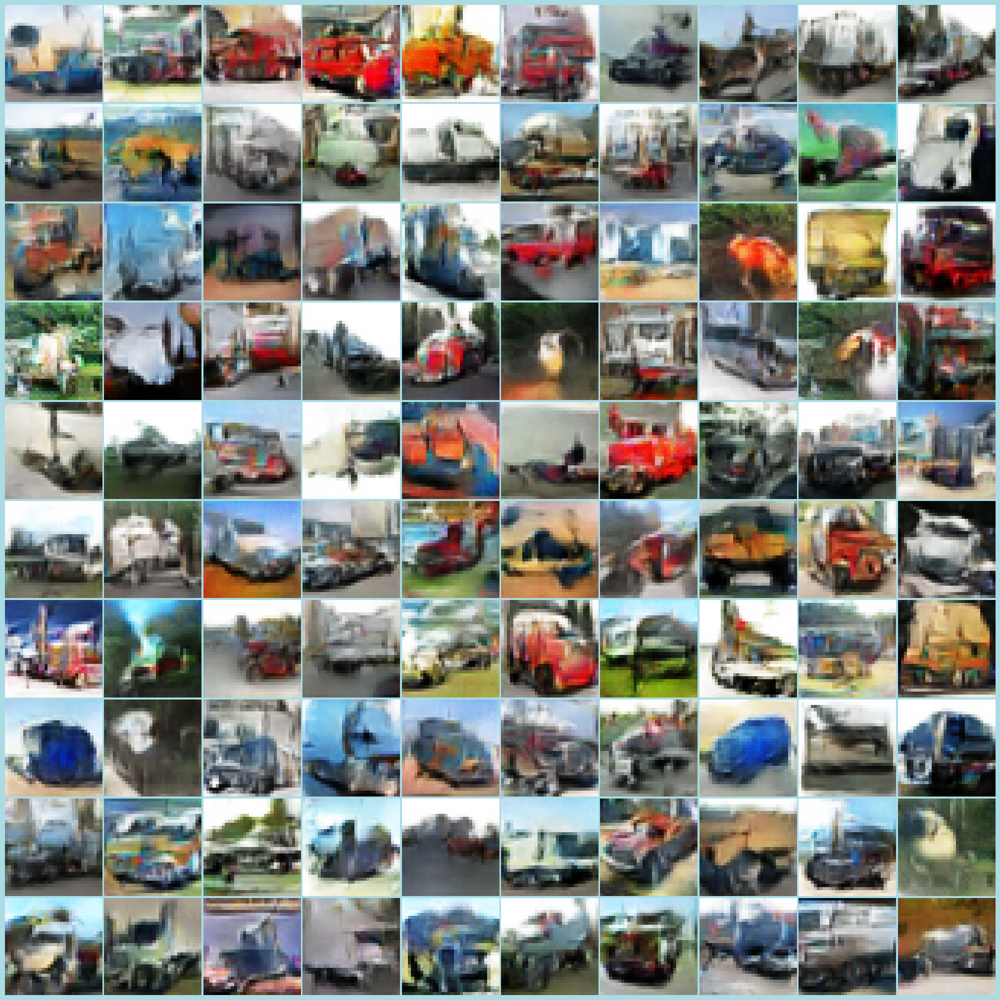

In [84]:
generate_1000_cgan(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Images produced are clear and able to see

</div>

In [87]:
new_row = {'Model':'ExponentialDecay CGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_8['d_loss'][-1], 'g_loss':gan_history_8['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier CGAN 1,35.389534,2.167156e-02,0.105153,6.727473
1,Sharpened Image CGAN 1,680924.469492,3.372896e+07,0.105472,6.766756
2,CutMix Image CGAN 1,91.519452,7.159536e-02,0.109868,4.574687
3,Oversample Image CGAN 1,32.972425,2.073221e-02,0.109868,4.574687
4,CosineDecay CGAN 1,32.555592,1.869066e-02,0.090373,7.033971
5,ExponentialDecay CGAN 1,32.555592,1.869066e-02,0.108475,6.636795


### Best Model: CGAN1 ED FID:31

In [88]:
full_scores.to_csv('full_scores6.csv')